In [16]:
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List
import matplotlib
from scipy.ndimage import gaussian_filter1d
# plt.style.use('ggplot')
sns.set_theme(context="notebook", style="darkgrid")
sns.set(font_scale=2.5)

PROJECT_ROOT_DIR = Path().absolute().parent.parent
PROJECT_ROOT_DIR

PosixPath('/home/sen/pythonprojects/fly-craft-examples')

In [17]:
def load_data(algo: str, filename: str, seed_str: str, insert_no: int=19, algo_dir: str="rl", smooth_success_rate: bool=True):
    df = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / filename / "progress.csv")
    df = df[pd.notnull(df["eval/success_rate"])]
    df.insert(insert_no, "seed", [seed_str] * len(df))
    df.insert(insert_no+1, "algo", [algo] * len(df))

    # 平滑！！！
    if smooth_success_rate:
        # df["eval/success_rate"] = smooth(df["eval/success_rate"], 5)
        df["eval/success_rate"] = gaussian_filter1d(df["eval/success_rate"], sigma=1)

    return df

In [18]:
def load_two_stage_data(algo: str, first_stage_filename: str,second_stage_filename:str, seed_str: str, insert_no: int=19, algo_dir: str="rl", smooth_success_rate: bool=True, time_steps_add_to_sec_stage: int=500000):
    df_first_stage = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / first_stage_filename / "progress.csv")
    df_first_stage = df_first_stage[pd.notnull(df_first_stage["eval/success_rate"])]

    df_second_stage = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / second_stage_filename / "progress.csv")
    df_second_stage = df_second_stage[pd.notnull(df_second_stage["eval/success_rate"])]

    df_second_stage["time/total_timesteps"] = df_second_stage["time/total_timesteps"] + time_steps_add_to_sec_stage
    
    merge_df = pd.concat([df_first_stage,df_second_stage],ignore_index=True)
    merge_df.insert(insert_no, "seed", [seed_str] * len(merge_df))
    merge_df.insert(insert_no+1, "algo", [algo] * len(merge_df))


    # 平滑！！！
    if smooth_success_rate:
        # df["eval/success_rate"] = smooth(df["eval/success_rate"], 5)
        merge_df["eval/success_rate"] = gaussian_filter1d(merge_df["eval/success_rate"], sigma=1)

    return merge_df

In [19]:
def load_three_stage_data(algo: str, first_stage_filename: str,second_stage_filename:str, three_stage_filename:str, seed_str: str, insert_no: int=19, algo_dir: str="rl", smooth_success_rate: bool=True, time_steps_add_to_sec_stage: int=500000):
    df_first_stage = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / first_stage_filename / "progress.csv")
    df_first_stage = df_first_stage[pd.notnull(df_first_stage["eval/success_rate"])]

    df_second_stage = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / second_stage_filename / "progress.csv")
    df_second_stage = df_second_stage[pd.notnull(df_second_stage["eval/success_rate"])]
    df_second_stage["time/total_timesteps"] = df_second_stage["time/total_timesteps"] + time_steps_add_to_sec_stage
    
    df_three_stage = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / three_stage_filename / "progress.csv")
    df_three_stage = df_three_stage[pd.notnull(df_three_stage["eval/success_rate"])]

    df_three_stage["time/total_timesteps"] = df_three_stage["time/total_timesteps"] + 2*time_steps_add_to_sec_stage

    merge_df = pd.concat([df_first_stage,df_second_stage,df_three_stage],ignore_index=True)
    merge_df.insert(insert_no, "seed", [seed_str] * len(merge_df))
    merge_df.insert(insert_no+1, "algo", [algo] * len(merge_df))


    # 平滑！！！
    if smooth_success_rate:
        # df["eval/success_rate"] = smooth(df["eval/success_rate"], 5)
        merge_df["eval/success_rate"] = gaussian_filter1d(merge_df["eval/success_rate"], sigma=1)

    return merge_df

In [20]:
SMOOTH = True

# D2D medium   One Stage without Reset

## 1e6 without reset b = 4/2/1/0.5/0.25/0.125

500
500
500
500
500
500


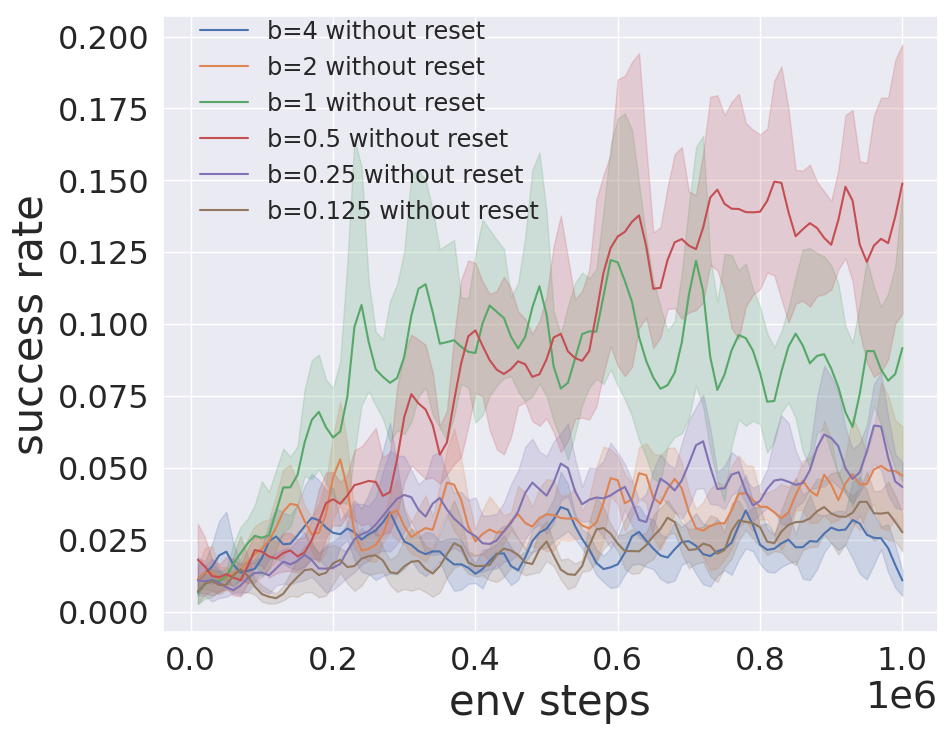

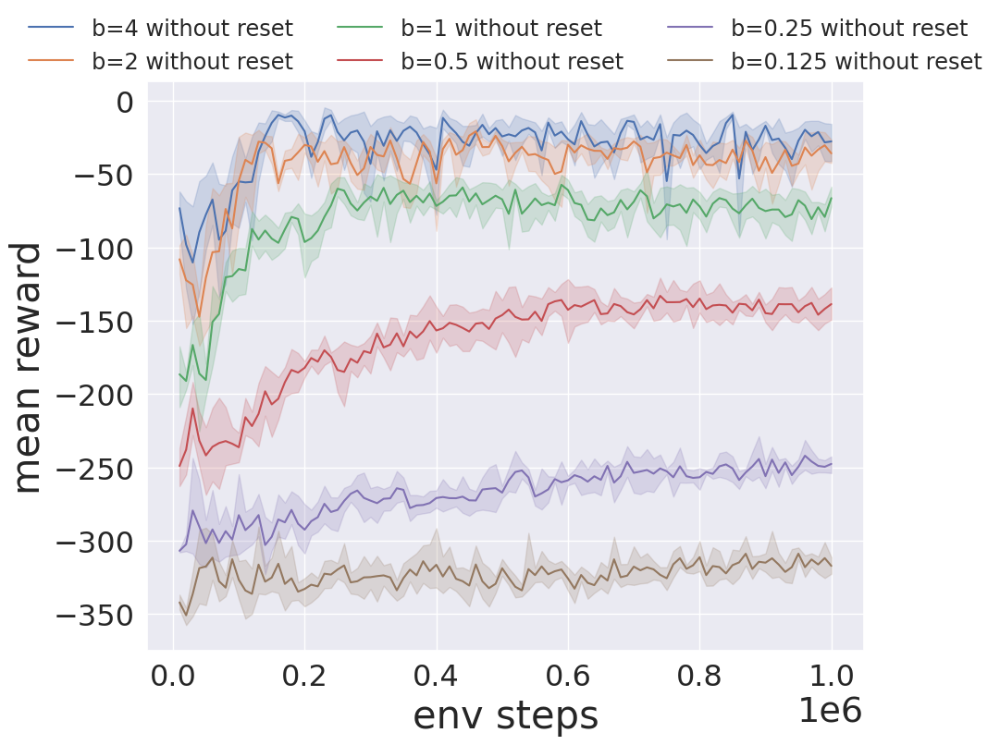

In [21]:
files = [
    "D2D/VVC/medium/b_4/sac_10hz_128_128_b_4_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_4/sac_10hz_128_128_b_4_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/b_4/sac_10hz_128_128_b_4_1e6steps_seed_3_singleRL",  
    "D2D/VVC/medium/b_4/sac_10hz_128_128_b_4_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_4/sac_10hz_128_128_b_4_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_4_without_reset = pd.concat([load_data("b=4 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_4_without_reset))


files = [
    "D2D/VVC/medium/b_2/sac_10hz_128_128_b_2_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_2/sac_10hz_128_128_b_2_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/b_2/sac_10hz_128_128_b_2_1e6steps_seed_3_singleRL",  
    "D2D/VVC/medium/b_2/sac_10hz_128_128_b_2_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_2/sac_10hz_128_128_b_2_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_2_without_reset = pd.concat([load_data("b=2 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_2_without_reset))


files = [
    "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_without_reset = pd.concat([load_data("b=1 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_without_reset))


files = [
    "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_without_reset = pd.concat([load_data("b=0.5 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_05_without_reset))

files = [
    "D2D/VVC/medium/b_025/sac_10hz_128_128_b_025_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_025/sac_10hz_128_128_b_025_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/b_025/sac_10hz_128_128_b_025_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/b_025/sac_10hz_128_128_b_025_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_025/sac_10hz_128_128_b_025_1e6steps_seed_5_singleRL", 

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_025_without_reset = pd.concat([load_data("b=0.25 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_025_without_reset))


files = [
    "D2D/VVC/medium/b_0125/sac_10hz_128_128_b_0125_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_0125/sac_10hz_128_128_b_0125_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/b_0125/sac_10hz_128_128_b_0125_1e6steps_seed_3_singleRL",
    "D2D/VVC/medium/b_0125/sac_10hz_128_128_b_0125_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_0125/sac_10hz_128_128_b_0125_1e6steps_seed_5_singleRL",   

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_0125_without_reset = pd.concat([load_data("b=0.125 without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_0125_without_reset))


data_plot = pd.concat([
df_b_4_without_reset,
df_b_2_without_reset,
df_b_1_without_reset,
df_b_05_without_reset,
df_b_025_without_reset,
df_b_0125_without_reset
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"


data_plot2 = pd.concat([
df_b_4_without_reset,
df_b_2_without_reset,
df_b_1_without_reset,
df_b_05_without_reset,
df_b_025_without_reset,
df_b_0125_without_reset
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# D2D medium   Two Stage with Reset

## 1e6 with reset b = 2/1/0.5/0.25/0.125

500
500
500
500
500


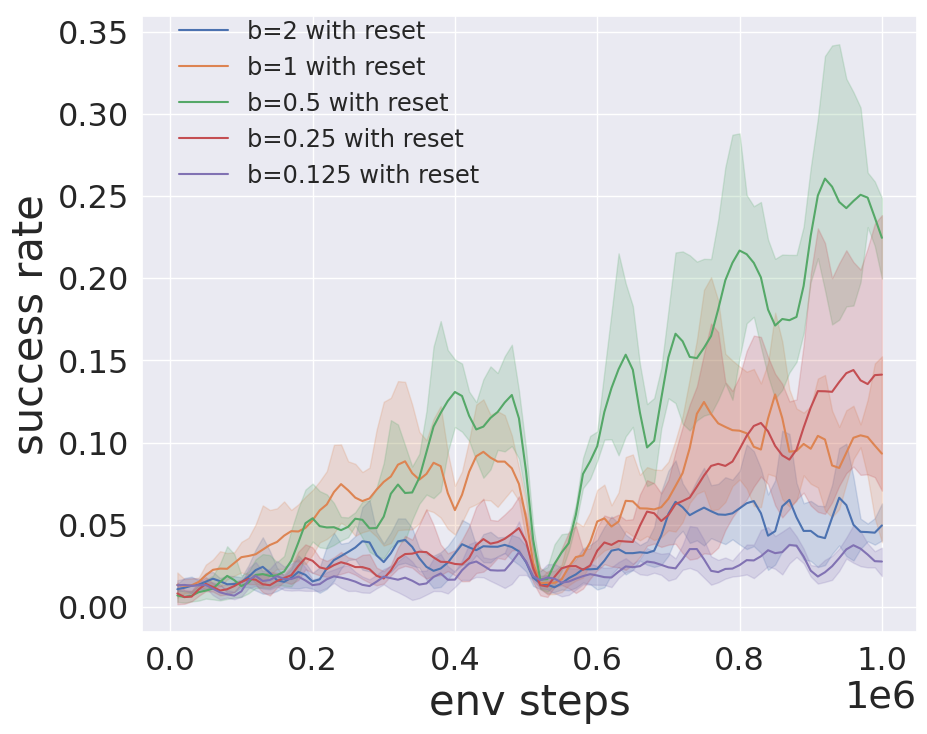

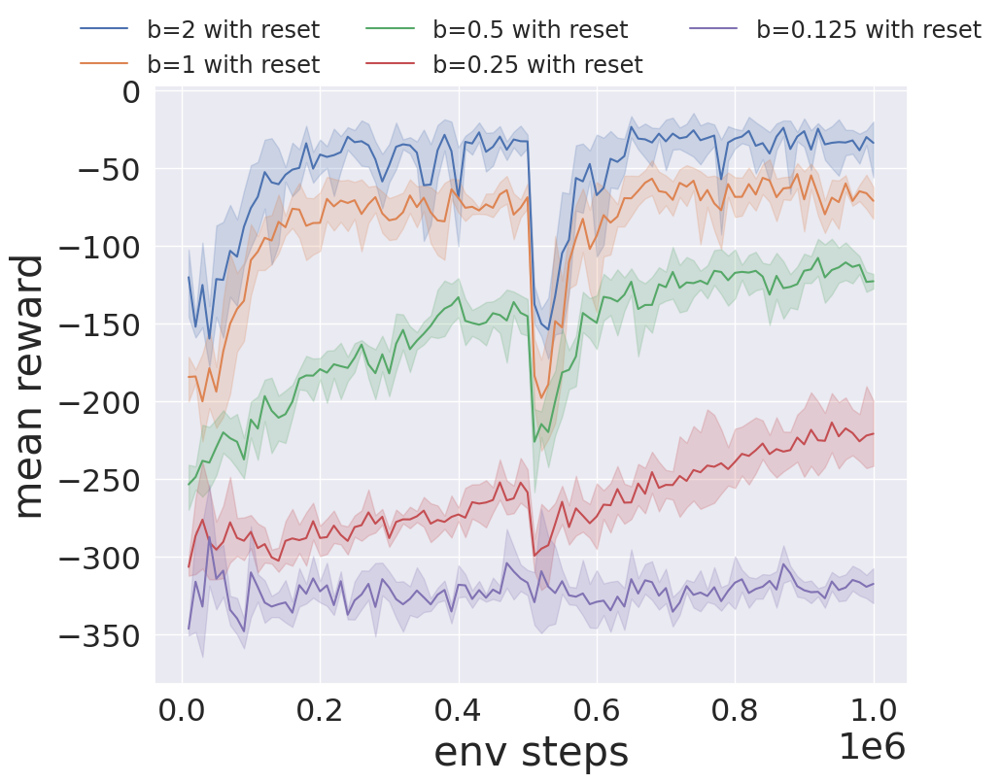

In [22]:
#  one stage with  reset

first_files = [
    "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_b_2_5e5steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_b_2_5e5steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_b_2_5e5steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_b_2_5e5steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_2_b_2/sac_10hz_128_128_b_2_5e5steps_b_2_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_2_with_reset = pd.concat([load_two_stage_data("b=2 with reset", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_2_with_reset))



first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",
]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_5_singleRL",
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_with_reset = pd.concat([load_two_stage_data("b=1 with reset", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_with_reset))


first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",

]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_with_reset = pd.concat([load_two_stage_data("b=0.5 with reset", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_with_reset))


first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_seed_5_singleRL",

]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_b_025_5e5steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_b_025_5e5steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_b_025_5e5steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_b_025_5e5steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_025_b_025/sac_10hz_128_128_b_025_5e5steps_b_025_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_025_with_reset = pd.concat([load_two_stage_data("b=0.25 with reset", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_025_with_reset))

first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_seed_5_singleRL",

]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_b_0125_5e5steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_b_0125_5e5steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_b_0125_5e5steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_b_0125_5e5steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_0125_b_0125/sac_10hz_128_128_b_0125_5e5steps_b_0125_5e5steps_seed_5_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_0125_with_reset = pd.concat([load_two_stage_data("b=0.125 with reset", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_0125_with_reset))


data_plot = pd.concat([
df_b_2_with_reset,
df_b_1_with_reset,
df_b_05_with_reset,
df_b_025_with_reset,
df_b_0125_with_reset
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_2_with_reset,
df_b_1_with_reset,
df_b_05_with_reset,
df_b_025_with_reset,
df_b_0125_with_reset
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## 2e6 with reset b = 1/0.5

In [23]:
first_files = [
   "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/b_1/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",
]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_5_singleRL",
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_with_reset_2e6 = pd.concat([load_two_stage_data("b=1 with reset 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_with_reset_2e6))


first_files = [
   "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/b_05/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",

]
second_files = [
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/2e6/sac_10hz_128_128_b_05_1e6steps_b_05_1e6steps_seed_1_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/2e6/sac_10hz_128_128_b_05_1e6steps_b_05_1e6steps_seed_2_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/2e6/sac_10hz_128_128_b_05_1e6steps_b_05_1e6steps_seed_3_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/2e6/sac_10hz_128_128_b_05_1e6steps_b_05_1e6steps_seed_4_singleRL",
     "D2D/VVC/medium/baseline/two_stage_b_05_b_05/2e6/sac_10hz_128_128_b_05_1e6steps_b_05_1e6steps_seed_5_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_with_reset_2e6 = pd.concat([load_two_stage_data("b=0.5 with reset 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_with_reset_2e6))





1000
1000


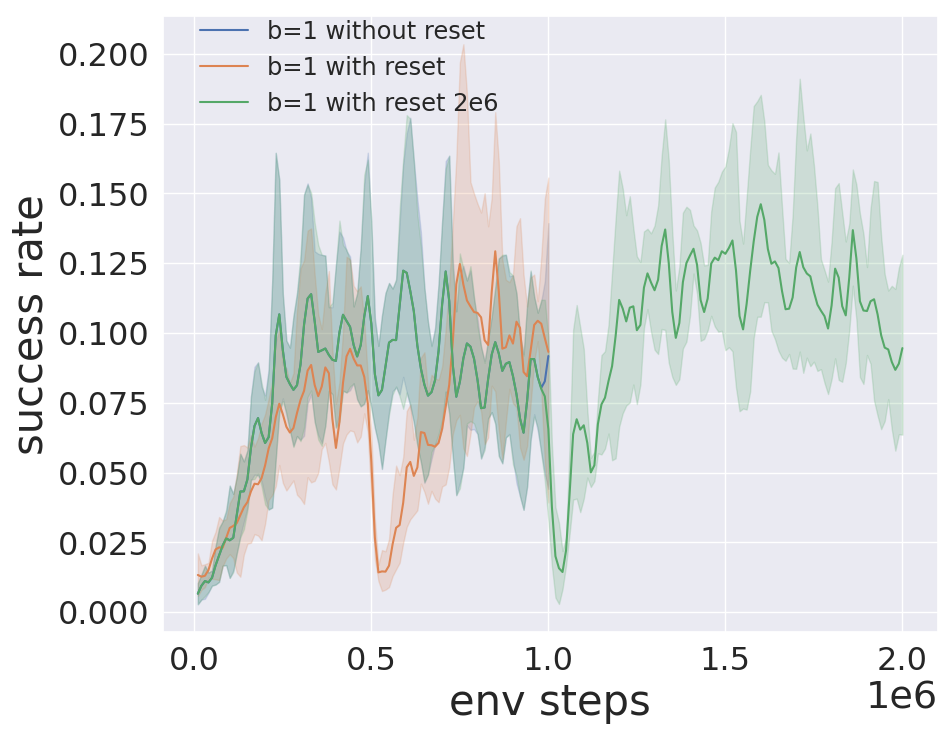

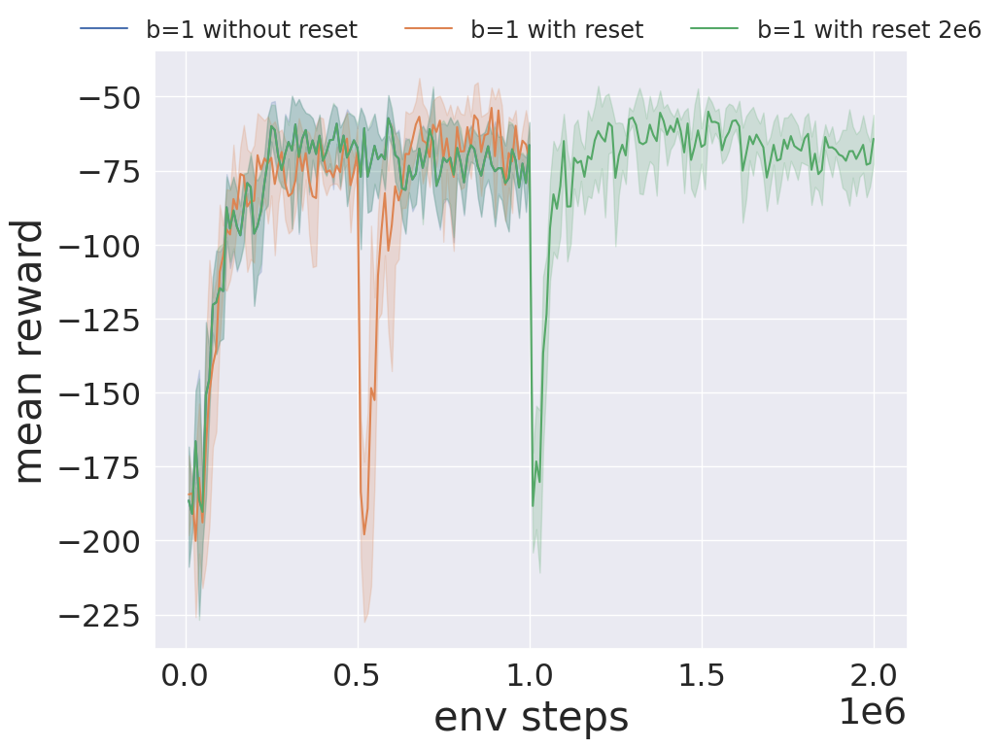

In [24]:
data_plot = pd.concat([
df_b_1_without_reset,
df_b_1_with_reset,
df_b_1_with_reset_2e6,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_without_reset,
df_b_1_with_reset,
df_b_1_with_reset_2e6,

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

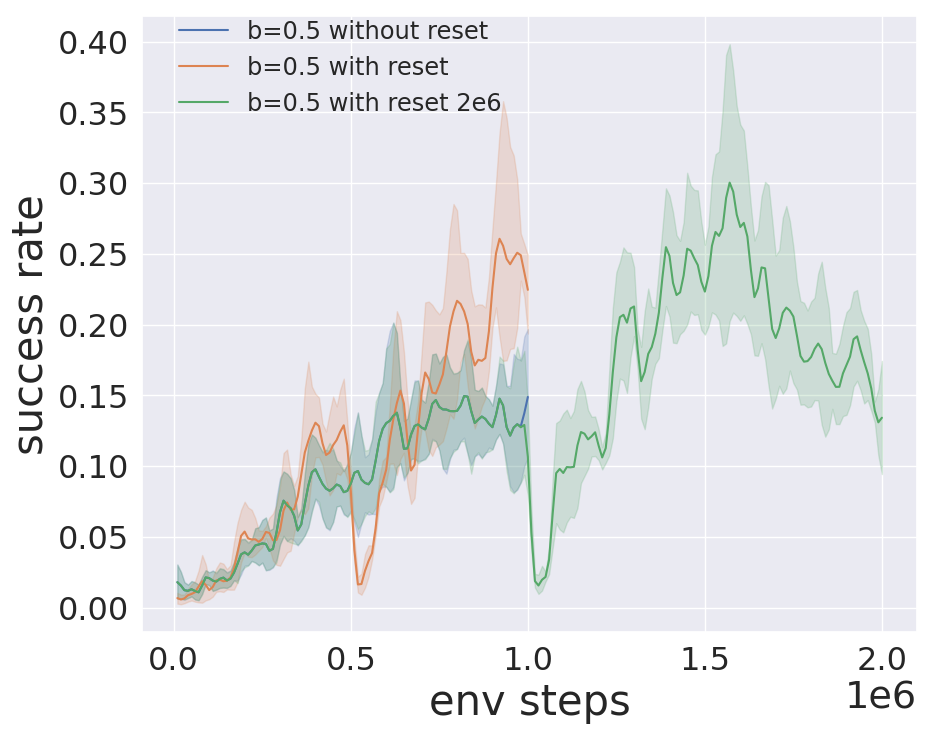

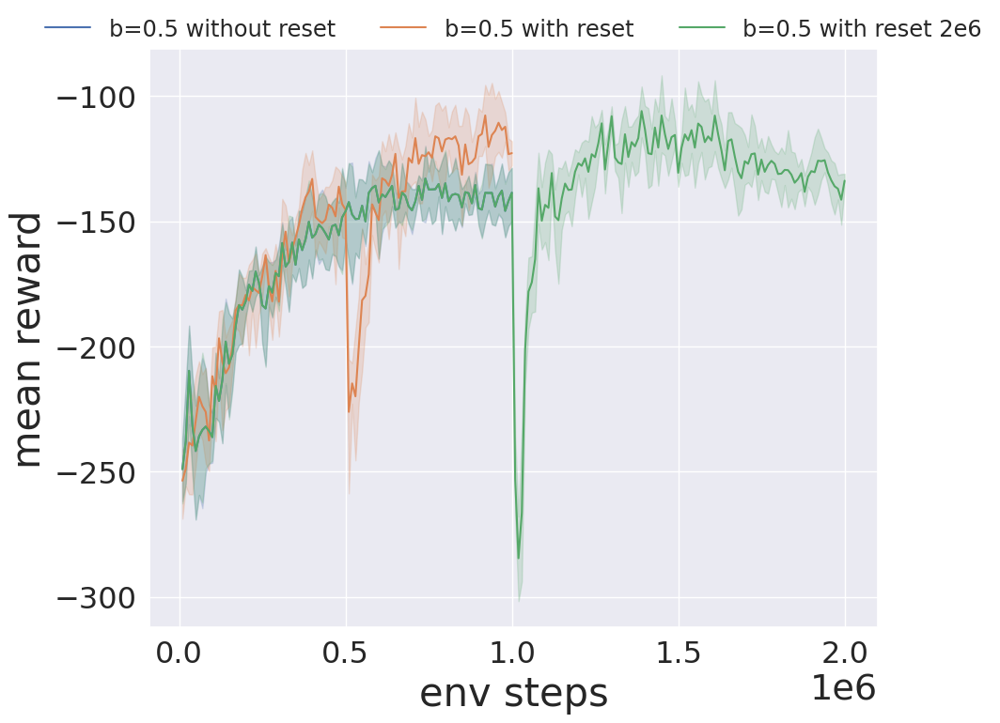

In [25]:
data_plot = pd.concat([
df_b_05_without_reset,
df_b_05_with_reset,
df_b_05_with_reset_2e6
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_without_reset,
df_b_05_with_reset,
df_b_05_with_reset_2e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## D2D Two Stage with reset

## Two Stage b = 2 to b = X

500
750
500
500
500


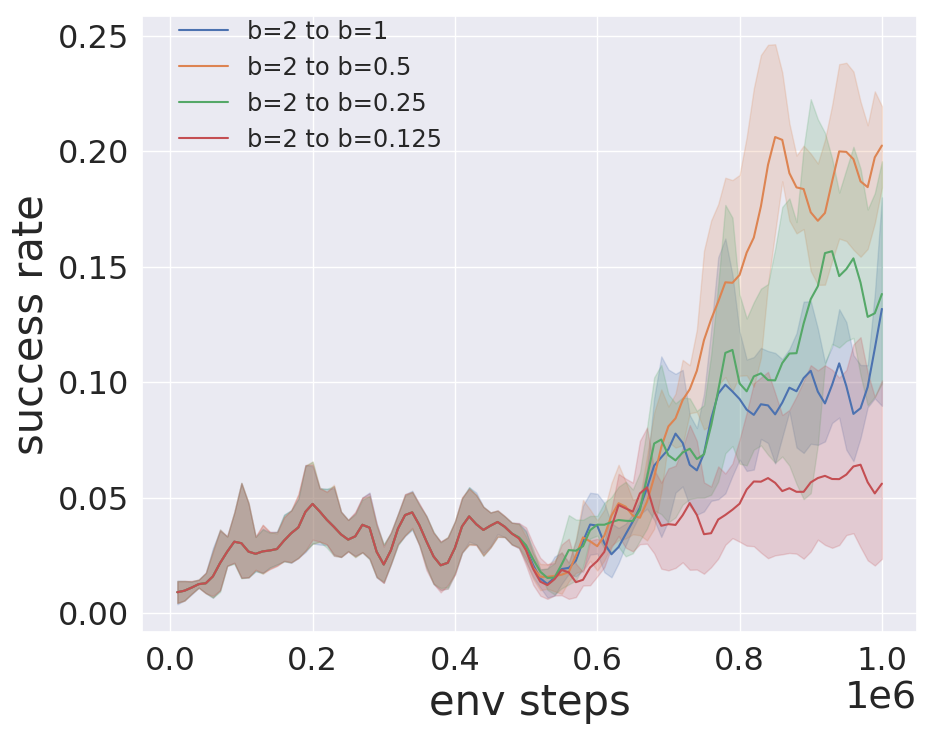

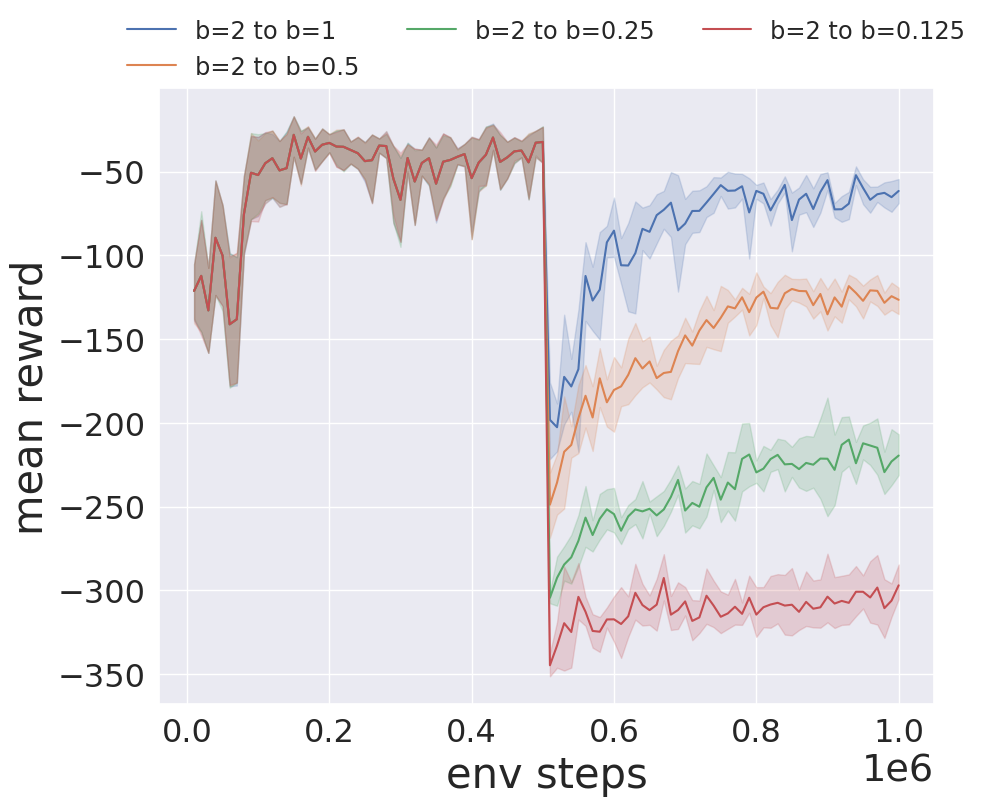

In [26]:
first_files = [
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_5e5steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_5e5steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_5e5steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_5e5steps_seed_5_singleRL",   
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_2_b1 = pd.concat([load_two_stage_data("b=2 to b=1", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_2_b1))


first_files = [
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_1/sac_10hz_128_128_b_2_5e5steps_b_1_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_2_b1_1e6 = pd.concat([load_two_stage_data("b=2 to b=1 (1e6) ", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_2_b1_1e6))

first_files = [
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_b_05_5e5steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_b_05_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_b_05_5e5steps_seed_3_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_b_05_5e5steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_b_05_5e5steps_seed_5_singleRL",  
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_2_b05 = pd.concat([load_two_stage_data("b=2 to b=0.5", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_2_b05))






first_files = [
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/VVC/medium/two_stage_b_2_b_025/sac_10hz_128_128_b_2_5e5steps_b_025_5e5steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_025/sac_10hz_128_128_b_2_5e5steps_b_025_5e5steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_025/sac_10hz_128_128_b_2_5e5steps_b_025_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_2_b_025/sac_10hz_128_128_b_2_5e5steps_b_025_5e5steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_025/sac_10hz_128_128_b_2_5e5steps_b_025_5e5steps_seed_5_singleRL",   
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_2_b025 = pd.concat([load_two_stage_data("b=2 to b=0.25", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_2_b025))


first_files = [
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_2_b_05/sac_10hz_128_128_b_2_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/VVC/medium/two_stage_b_2_b_0125/sac_10hz_128_128_b_2_5e5steps_b_0125_5e5steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_0125/sac_10hz_128_128_b_2_5e5steps_b_0125_5e5steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_0125/sac_10hz_128_128_b_2_5e5steps_b_0125_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_2_b_0125/sac_10hz_128_128_b_2_5e5steps_b_0125_5e5steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_2_b_0125/sac_10hz_128_128_b_2_5e5steps_b_0125_5e5steps_seed_5_singleRL",   
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_2_b0125 = pd.concat([load_two_stage_data("b=2 to b=0.125", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_2_b0125))



data_plot = pd.concat([
df_two_stage_b_2_b1,
# df_two_stage_b_2_b1_1e6,
df_two_stage_b_2_b05,
df_two_stage_b_2_b025,
df_two_stage_b_2_b0125
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"

data_plot2 = pd.concat([
df_two_stage_b_2_b1,
# df_two_stage_b_2_b1_1e6,
df_two_stage_b_2_b05,
df_two_stage_b_2_b025,
df_two_stage_b_2_b0125
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例df_two_stage_b_2_b1
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## Two Stage b = 1 to b = X

500
500
500


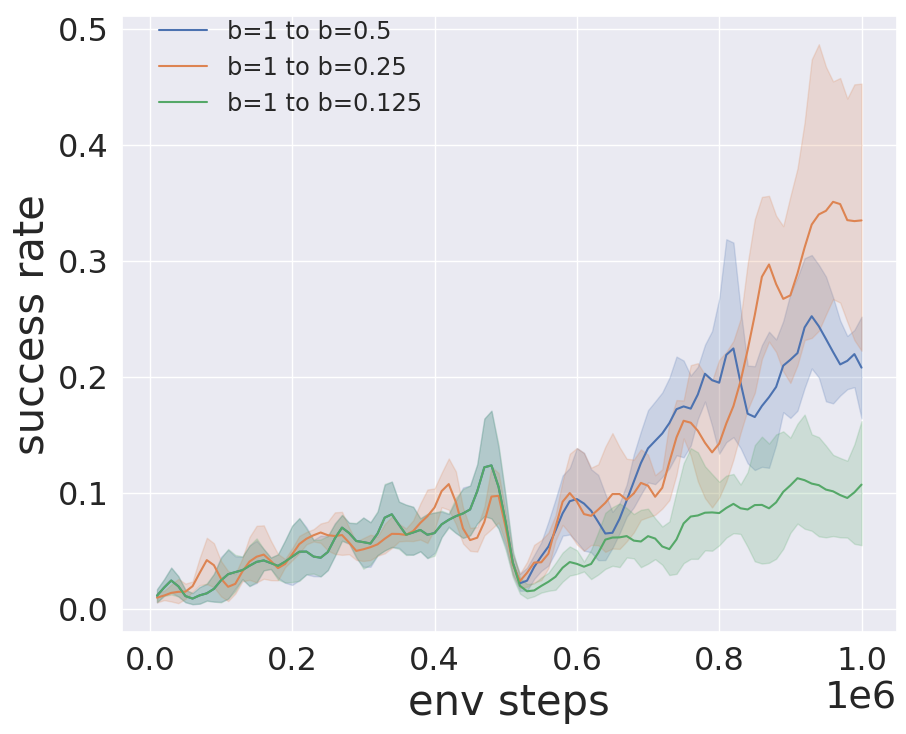

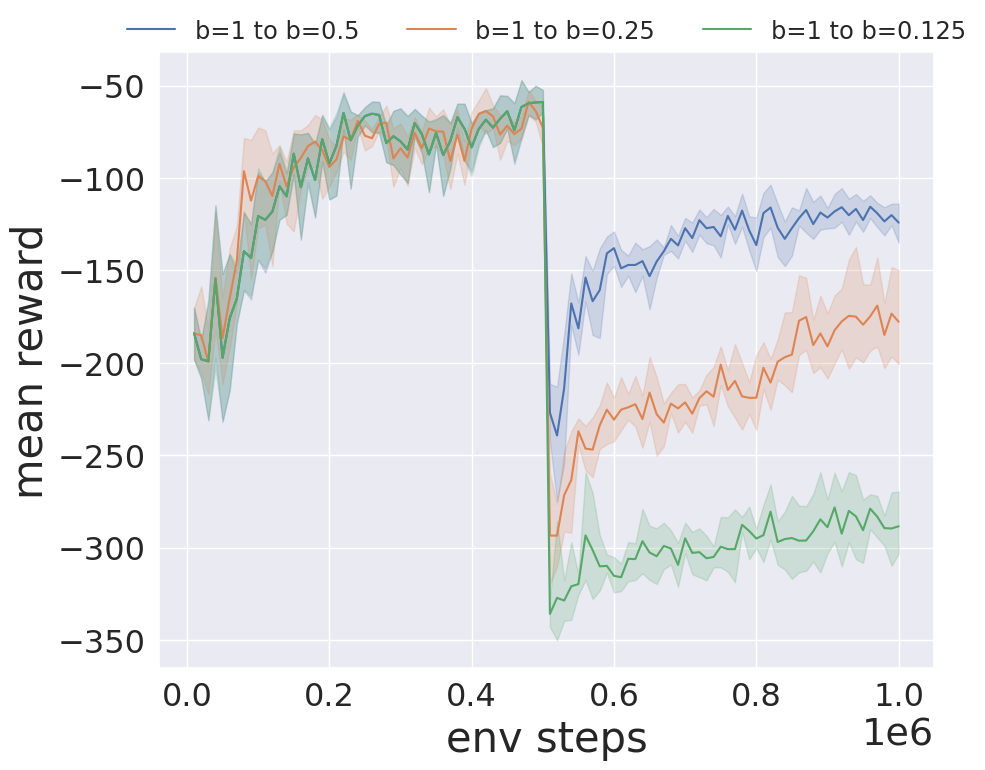

In [27]:
first_files = [
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",

]
second_files = [
    "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_b_05_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_b_05_5e5steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_b_05_5e5steps_seed_3_singleRL", 
    "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_b_05_5e5steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_b_05_5e5steps_seed_5_singleRL",  

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_b05 = pd.concat([load_two_stage_data("b=1 to b=0.5", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_b05))


first_files = [
   "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",


]
second_files = [
    "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_b_025_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_b_025_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_b_025_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_b_025_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_025/sac_10hz_128_128_b_1_5e5steps_b_025_5e5steps_seed_5_singleRL",
  

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_b025 = pd.concat([load_two_stage_data("b=1 to b=0.25", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_b025))


first_files = [
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_1_b_05/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",
   


]
second_files = [
    "D2D/VVC/medium/two_stage_b_1_b_0125/sac_10hz_128_128_b_1_5e5steps_b_0125_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_0125/sac_10hz_128_128_b_1_5e5steps_b_0125_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_0125/sac_10hz_128_128_b_1_5e5steps_b_0125_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_0125/sac_10hz_128_128_b_1_5e5steps_b_0125_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/two_stage_b_1_b_0125/sac_10hz_128_128_b_1_5e5steps_b_0125_5e5steps_seed_5_singleRL",
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_b0125 = pd.concat([load_two_stage_data("b=1 to b=0.125", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_b0125))


data_plot = pd.concat([
df_two_stage_b_1_b05,
df_two_stage_b_1_b025,
df_two_stage_b_1_b0125
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"

data_plot2 = pd.concat([
df_two_stage_b_1_b05,
df_two_stage_b_1_b025,
df_two_stage_b_1_b0125
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例df_two_stage_b_2_b1
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

##  two stage b = 0.5 to b = X

500
500
500


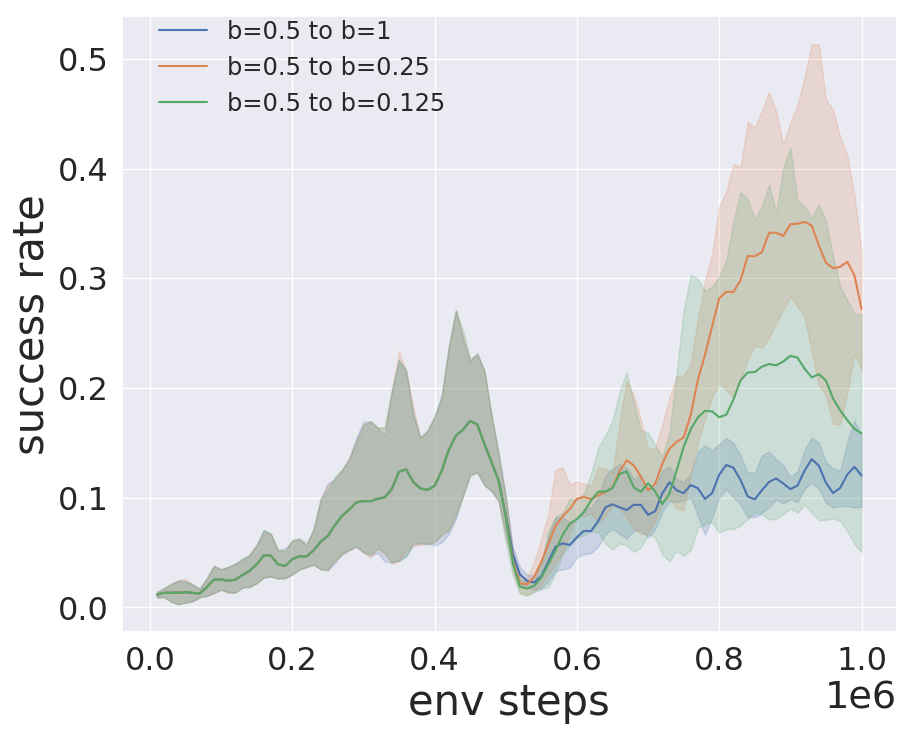

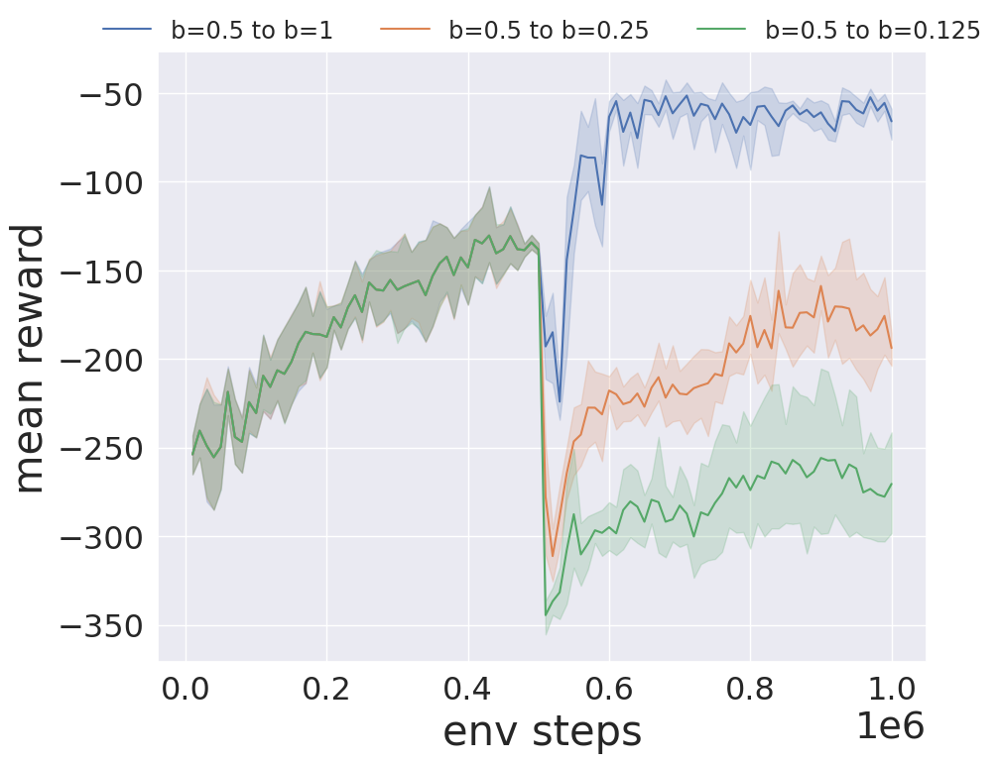

In [28]:
first_files = [
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",
   


]
second_files = [
    "D2D/VVC/medium/two_stage_b_05_b_1/sac_10hz_128_128_b_05_5e5steps_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_1/sac_10hz_128_128_b_05_5e5steps_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_1/sac_10hz_128_128_b_05_5e5steps_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_1/sac_10hz_128_128_b_05_5e5steps_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_1/sac_10hz_128_128_b_05_5e5steps_b_1_5e5steps_seed_5_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_b1 = pd.concat([load_two_stage_data("b=0.5 to b=1", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_b1))


first_files = [
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",
   


]
second_files = [
    "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_b_025_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_b_025_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_b_025_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_b_025_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_b_025_5e5steps_seed_5_singleRL",  

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_b025 = pd.concat([load_two_stage_data("b=0.5 to b=0.25", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_b025))


first_files = [
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_025/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",
   

]
second_files = [
    "D2D/VVC/medium/two_stage_b_05_b_0125/sac_10hz_128_128_b_05_5e5steps_b_0125_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_0125/sac_10hz_128_128_b_05_5e5steps_b_0125_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_0125/sac_10hz_128_128_b_05_5e5steps_b_0125_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_0125/sac_10hz_128_128_b_05_5e5steps_b_0125_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/two_stage_b_05_b_0125/sac_10hz_128_128_b_05_5e5steps_b_0125_5e5steps_seed_5_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_b0125 = pd.concat([load_two_stage_data("b=0.5 to b=0.125", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_b0125))



data_plot = pd.concat([
df_two_stage_b_05_b1,
df_two_stage_b_05_b025,
df_two_stage_b_05_b0125
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"

data_plot2 = pd.concat([
df_two_stage_b_05_b1,
df_two_stage_b_05_b025,
df_two_stage_b_05_b0125
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例df_two_stage_b_2_b1
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## two b=2 to b = 1(1e6)  and two stage 2e6 b = 1 to b = 1 

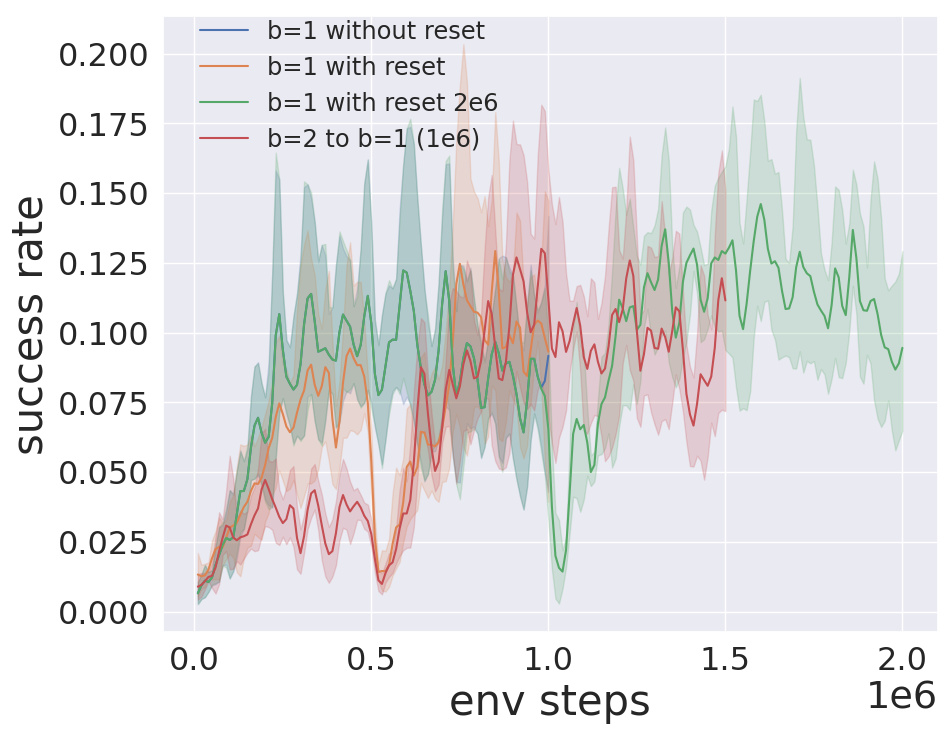

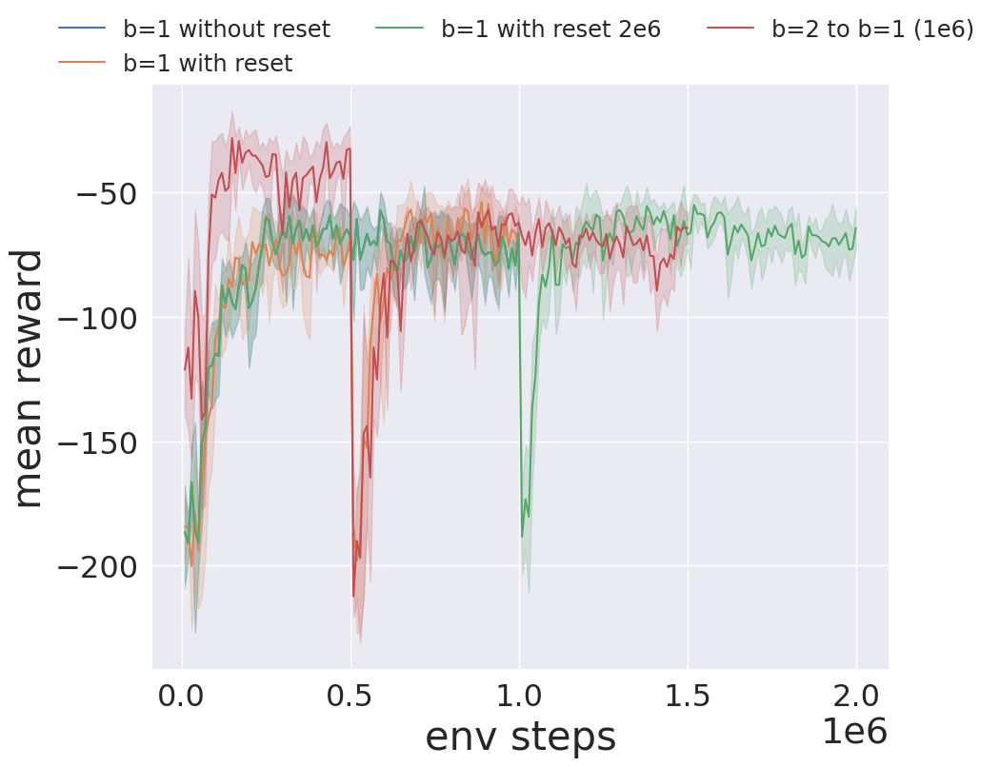

In [29]:
data_plot = pd.concat([
df_b_1_without_reset,
df_b_1_with_reset,
df_b_1_with_reset_2e6,
df_two_stage_b_2_b1_1e6
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_without_reset,
df_b_1_with_reset,
df_b_1_with_reset_2e6,
df_two_stage_b_2_b1_1e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## change gamma  0.95 to 0.995

500


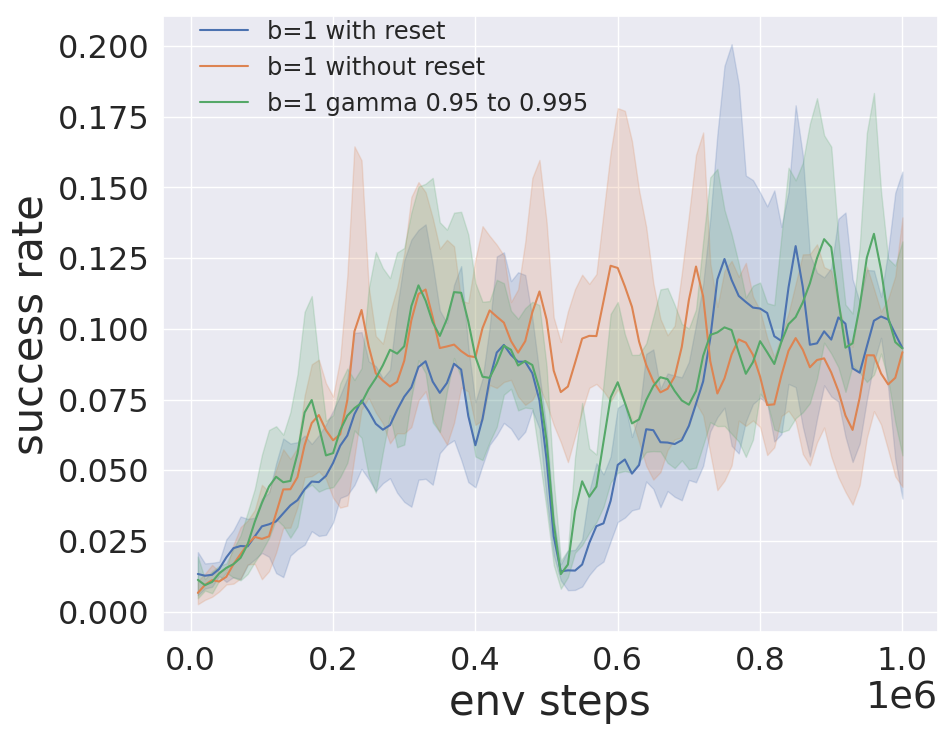

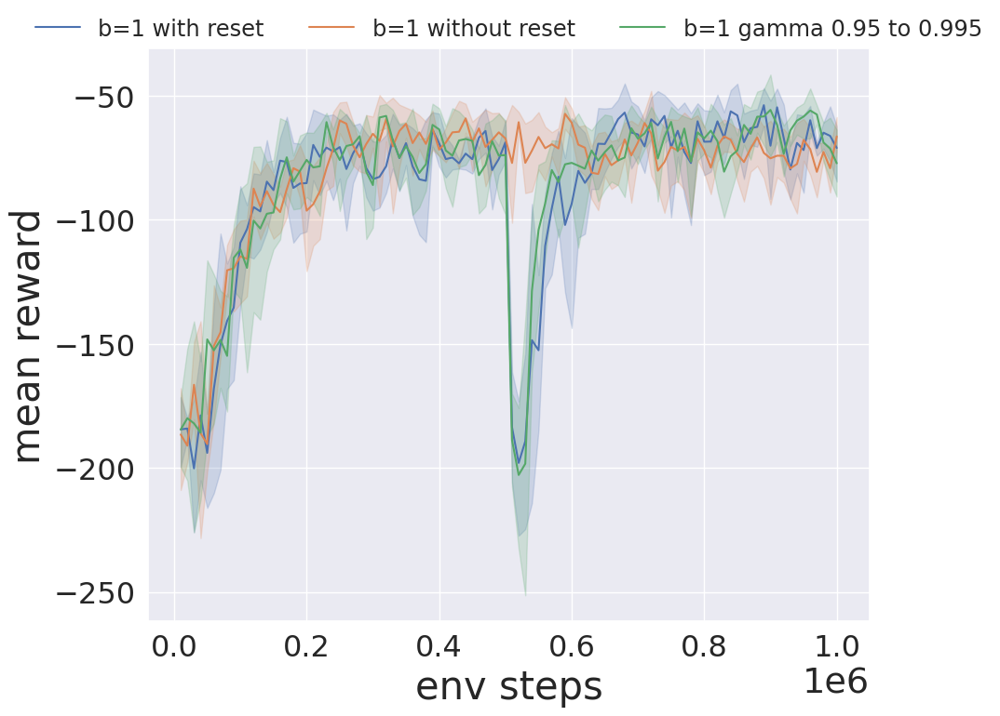

In [30]:
first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",

]
second_files = [
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_gamma095to0995 = pd.concat([load_two_stage_data("b=1 gamma 0.95 to 0.995", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_gamma095to0995))



data_plot = pd.concat([
df_b_1_with_reset,
df_b_1_without_reset,
df_two_stage_b_1_gamma095to0995
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_with_reset,
df_b_1_without_reset,
df_two_stage_b_1_gamma095to0995
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# F2F One Stage

500
500


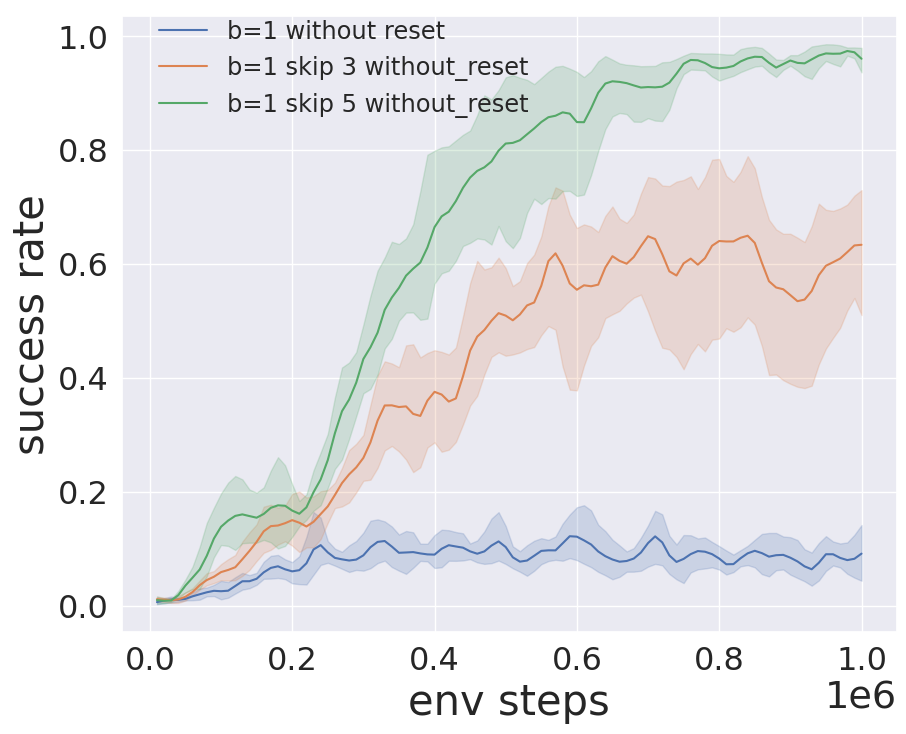

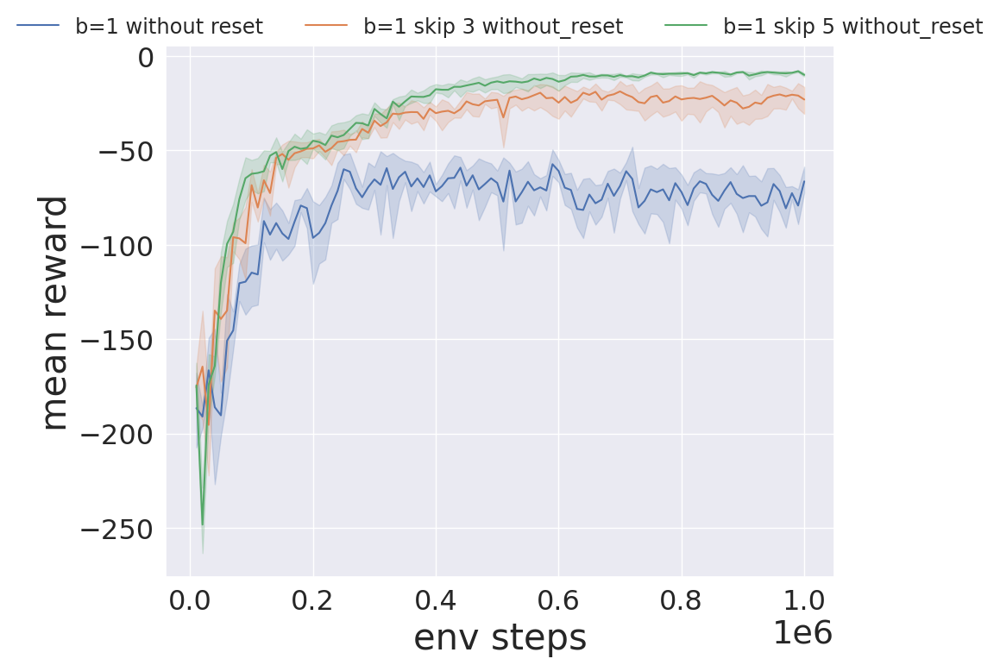

In [31]:
files = [
    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_1_singleRL", 
    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_2_singleRL", 
    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_3_singleRL", 
    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_4_singleRL", 
    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_5_singleRL", 

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_skip_3_without_reset = pd.concat([load_data("b=1 skip 3 without_reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_skip_3_without_reset))


files = [
    "D2D/F2F/medium/b_1/skip_5/sac_128_128_b_1_1e6steps_skip_5_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_5/sac_128_128_b_1_1e6steps_skip_5_seed_2_singleRL", 
    "D2D/F2F/medium/b_1/skip_5/sac_128_128_b_1_1e6steps_skip_5_seed_3_singleRL", 
    "D2D/F2F/medium/b_1/skip_5/sac_128_128_b_1_1e6steps_skip_5_seed_4_singleRL", 
    "D2D/F2F/medium/b_1/skip_5/sac_128_128_b_1_1e6steps_skip_5_seed_5_singleRL",  


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_skip_5_without_reset = pd.concat([load_data("b=1 skip 5 without_reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_skip_5_without_reset))


data_plot = pd.concat([
df_b_1_without_reset,
df_b_1_skip_3_without_reset,
df_b_1_skip_5_without_reset
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_without_reset,
df_b_1_skip_3_without_reset,
df_b_1_skip_5_without_reset
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## two stage  with reset  skip 1,3,5

500
500


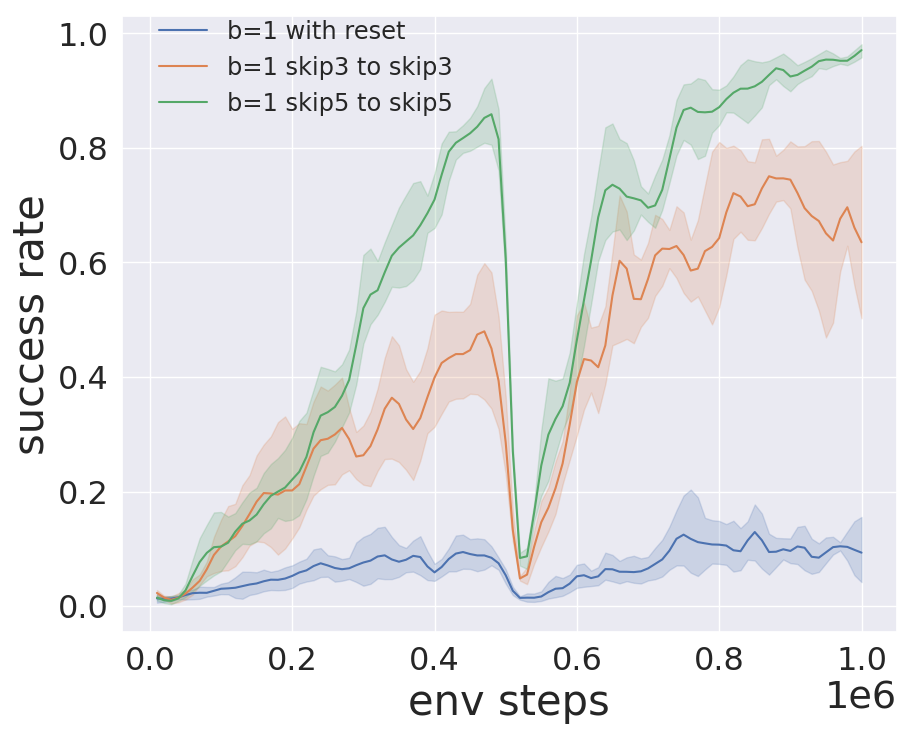

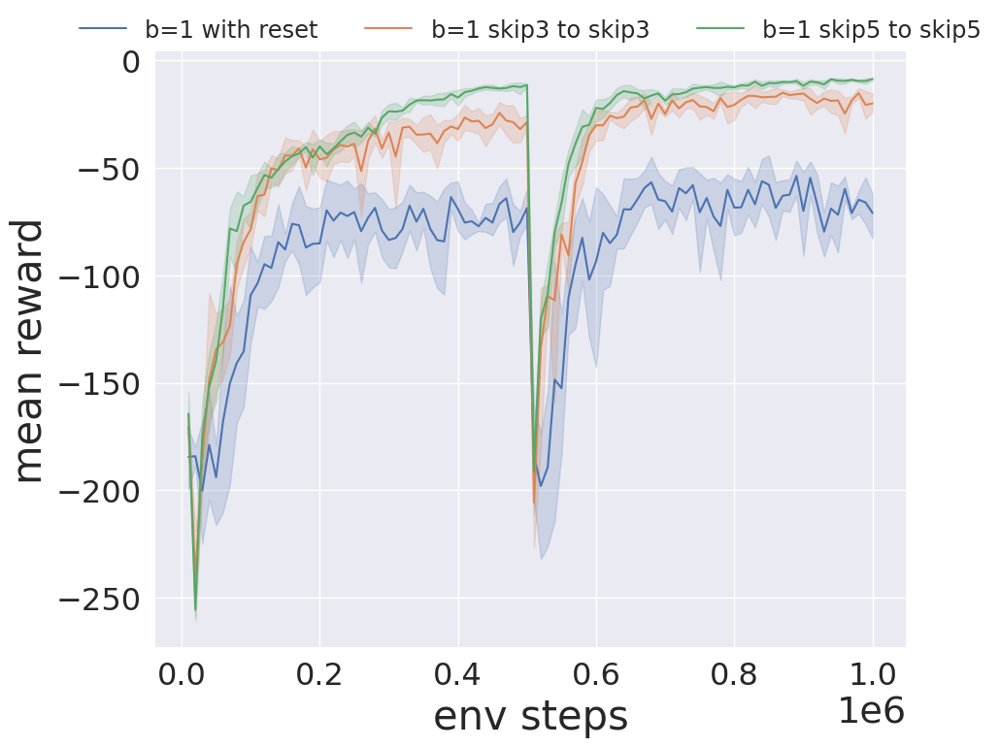

In [32]:
first_files = [
   "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_seed_5_singleRL",

]
second_files = [
    "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_to_skip_3_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_to_skip_3_seed_2_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_to_skip_3_seed_3_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_to_skip_3_seed_4_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_3/sac_128_128_b_1_5e5steps_skip_3_to_skip_3_seed_5_singleRL", 

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip3_skip3 = pd.concat([load_two_stage_data("b=1 skip3 to skip3", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip3_skip3))


first_files = [
   "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_seed_5_singleRL",


]
second_files = [
    "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_to_skip_5_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_to_skip_5_seed_2_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_to_skip_5_seed_3_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_to_skip_5_seed_4_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_5/sac_128_128_b_1_5e5steps_skip_5_to_skip_5_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip5_skip5 = pd.concat([load_two_stage_data("b=1 skip5 to skip5", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip5_skip5))


data_plot = pd.concat([
df_b_1_with_reset,
df_two_stage_b_1_skip3_skip3,
df_two_stage_b_1_skip5_skip5
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_with_reset,
df_two_stage_b_1_skip3_skip3,
df_two_stage_b_1_skip5_skip5
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## two stage 1e6 

500
500
1000


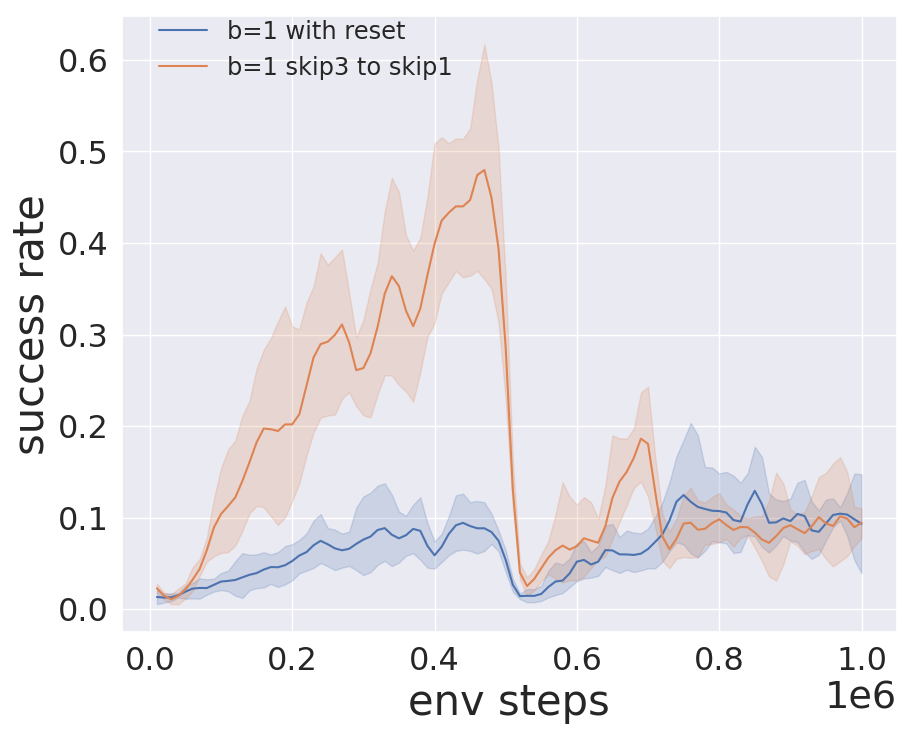

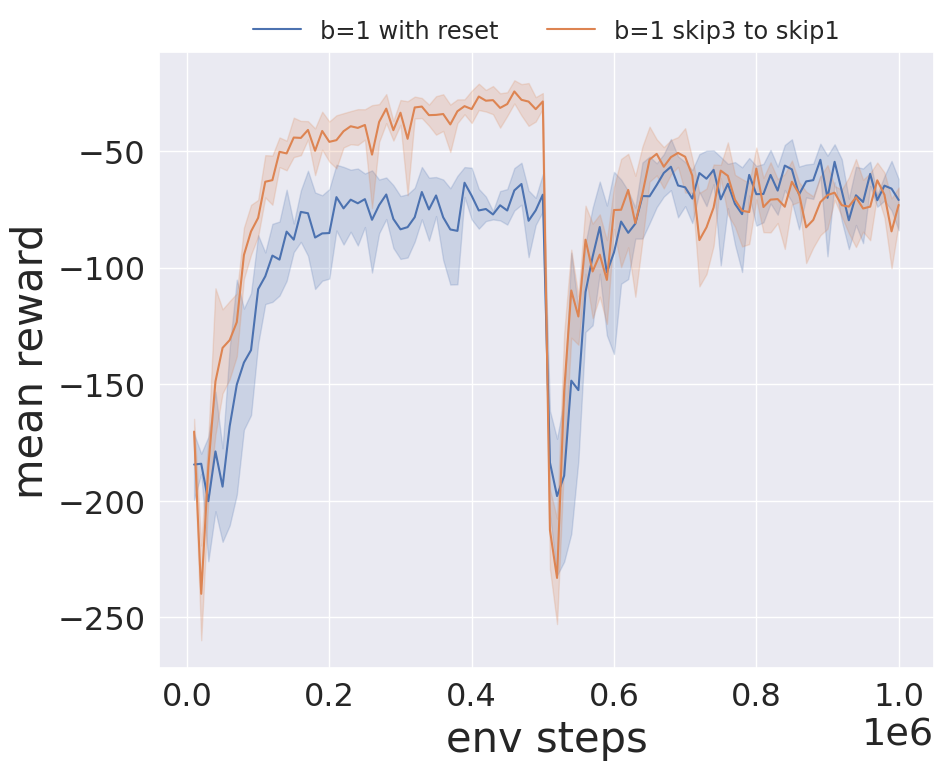

In [33]:
first_files = [
   "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_seed_5_singleRL",


]
second_files = [
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_to_skip_1_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_to_skip_1_seed_2_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_to_skip_1_seed_3_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_to_skip_1_seed_4_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/sac_128_128_b_1_5e5steps_skip_3_to_skip_1_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip3_skip1 = pd.concat([load_two_stage_data("b=1 skip3 to skip1", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip3_skip1))


first_files = [
   "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_seed_5_singleRL",


]
second_files = [
    "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_to_skip_1_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_to_skip_1_seed_2_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_to_skip_1_seed_3_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_to_skip_1_seed_4_singleRL",
    "D2D/F2F/medium/b_1/skip_5_2_skip_1/sac_128_128_b_1_5e5steps_skip_5_to_skip_1_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip5_skip1 = pd.concat([load_two_stage_data("b=1 skip5 to skip1", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip5_skip1))



first_files = [
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_5_singleRL",

]

second_files = [
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_2_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_3_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_4_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip3_skip1_2e6 = pd.concat([load_two_stage_data("b=1 skip3 to skip1 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip3_skip1_2e6))



# first_files = [
#    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_1_singleRL",
#    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_2_singleRL",
#    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_3_singleRL",
#    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_4_singleRL",
#    "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_5_singleRL",

# ]

# second_files = [
#     "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_1_singleRL",
#     "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_2_singleRL",
#     "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_3_singleRL",
#     "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_4_singleRL",
#     "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_5_singleRL",

# ]
# seed_strs = [
#     "seed 1", 
#     "seed 2", 
#     "seed 3", 
#     "seed 4", 
#     "seed 5"
# ]
# df_two_stage_b_1_skip3_skip1_2e6_buffer_size5e5 = pd.concat([load_two_stage_data("b=1 skip3 to skip1 2e6 buffer size = 5e5", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
# print(len(df_two_stage_b_1_skip3_skip1_2e6_buffer_size5e5))


data_plot = pd.concat([
df_b_1_with_reset,
# df_b_1_with_reset_2e6,
df_two_stage_b_1_skip3_skip1,
# df_two_stage_b_1_skip3_skip1_2e6
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_with_reset,
# df_b_1_with_reset_2e6,
df_two_stage_b_1_skip3_skip1,
# df_two_stage_b_1_skip3_skip1_2e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


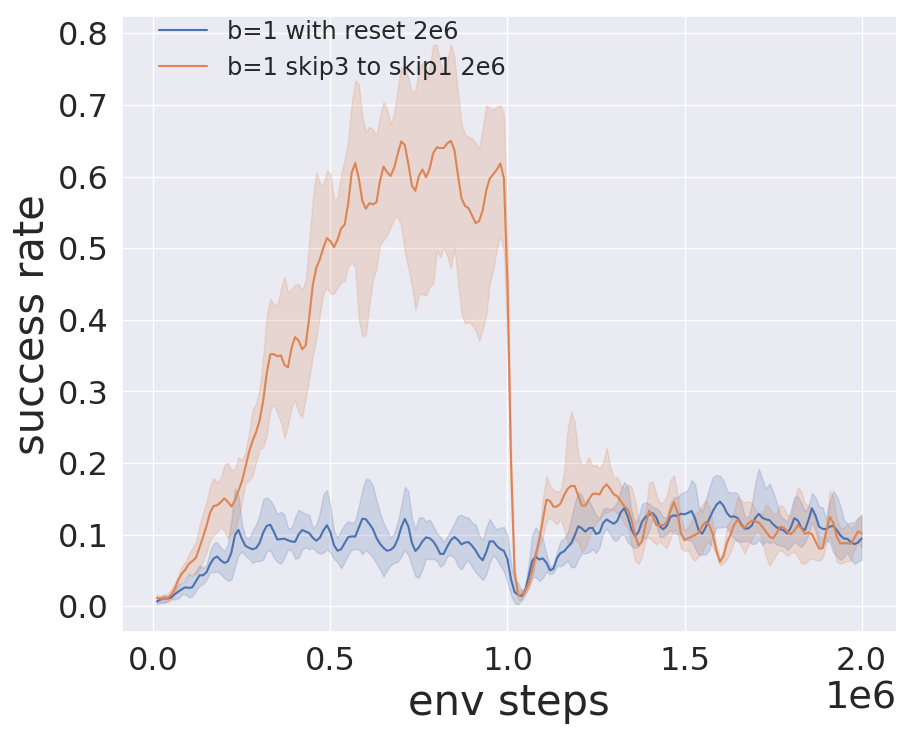

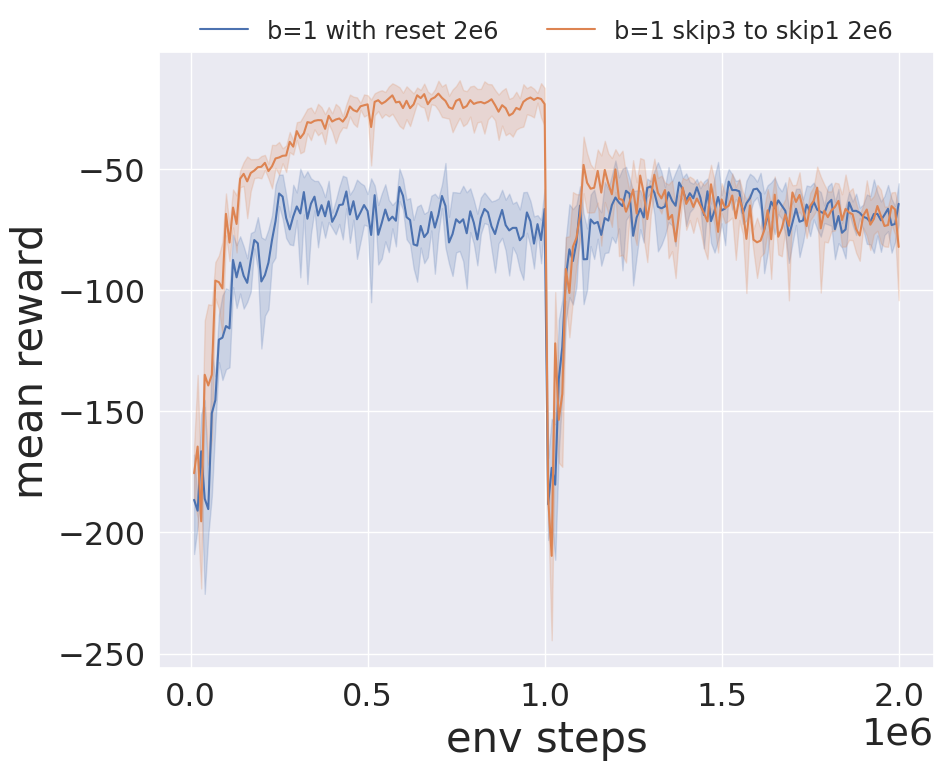

In [34]:
data_plot = pd.concat([
# df_b_1_with_reset,
df_b_1_with_reset_2e6,
# df_two_stage_b_1_skip3_skip1,
df_two_stage_b_1_skip3_skip1_2e6,
# df_two_stage_b_1_skip3_skip1_2e6_buffer_size5e5,
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
# df_b_1_with_reset,
df_b_1_with_reset_2e6,
# df_two_stage_b_1_skip3_skip1,
df_two_stage_b_1_skip3_skip1_2e6,
# df_two_stage_b_1_skip3_skip1_2e6_buffer_size5e5
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## goal sapce

## easy one stage without reset

500
500


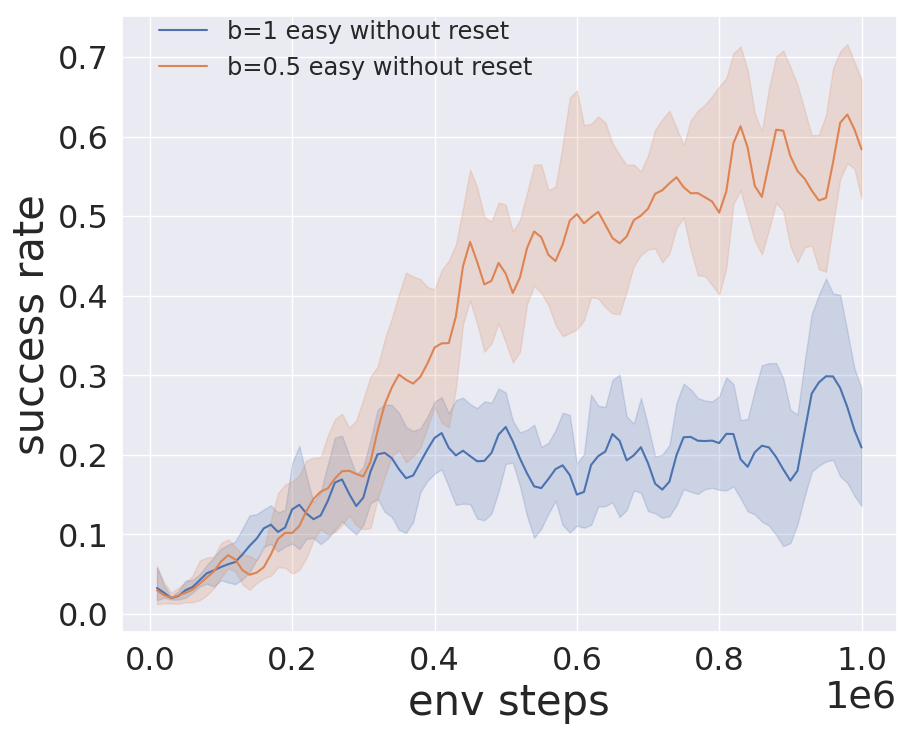

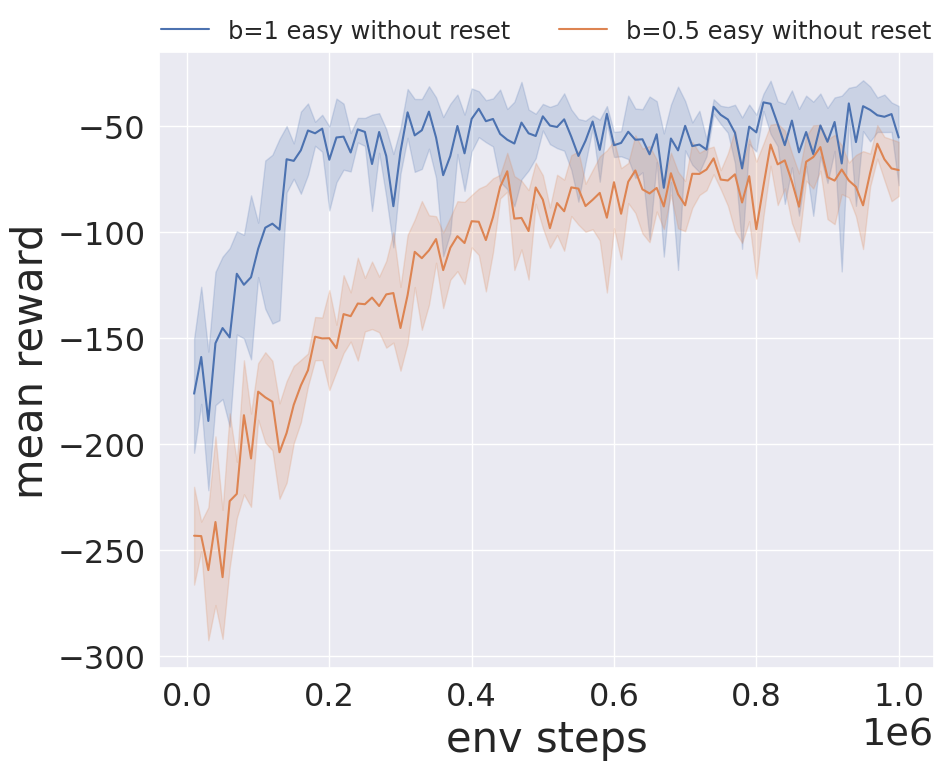

In [35]:
files = [
    "D2D/VVC/easy_sac/b_1/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
    "D2D/VVC/easy_sac/b_1/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/easy_sac/b_1/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/easy_sac/b_1/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/easy_sac/b_1/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",  

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1esay_without_reset = pd.concat([load_data("b=1 easy without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1esay_without_reset))


files = [
    "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL", 
    "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL", 
    "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL", 
    "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL", 
    "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05esay_without_reset = pd.concat([load_data("b=0.5 easy without reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_05esay_without_reset))


data_plot = pd.concat([
df_b_1esay_without_reset,
df_b_05esay_without_reset
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1esay_without_reset,
df_b_05esay_without_reset
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## two stage  with reset easy 2 easy 

500
500


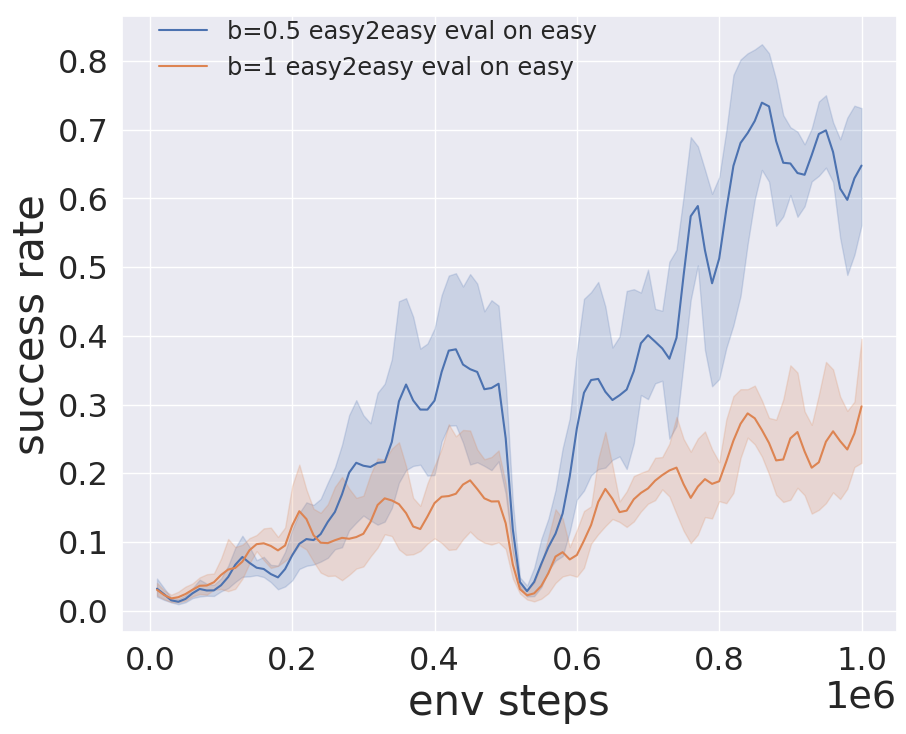

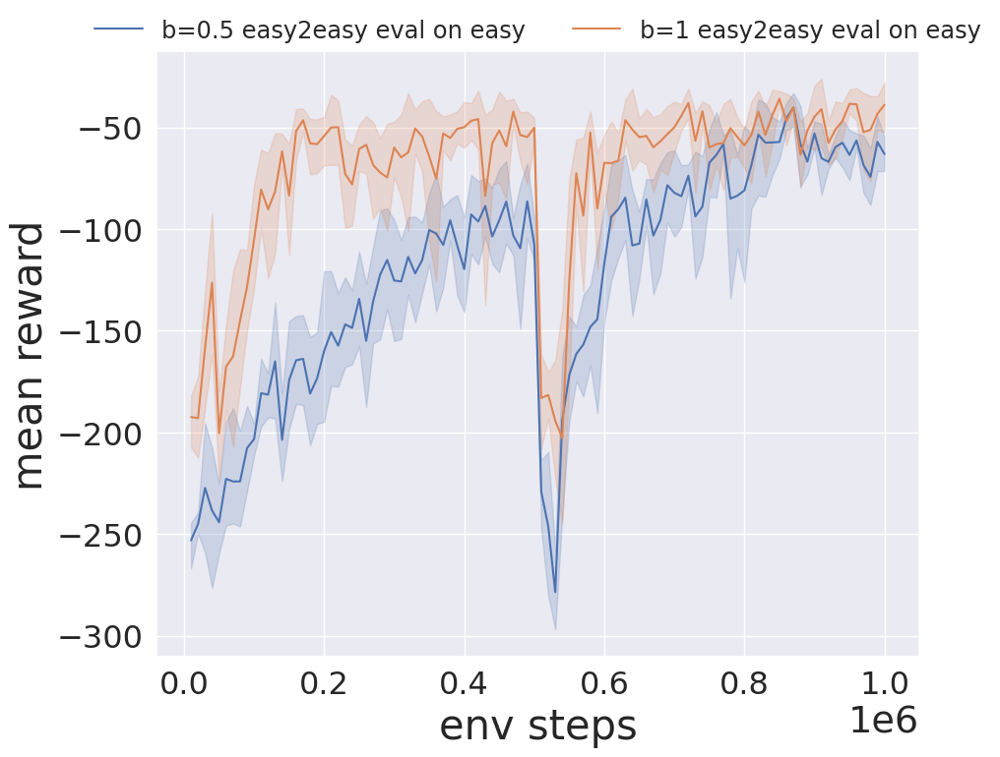

In [37]:
# train on easy eval on easy 

first_files = [
   "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",

]

second_files = [
    "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/easy_sac/baseline/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_easy2easy_eval_on_easy = pd.concat([load_two_stage_data("b=1 easy2easy eval on easy", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_easy2easy_eval_on_easy))


first_files = [
   "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",
  

]

second_files = [
    "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_1_singleRL",
    "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_2_singleRL",
    "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_3_singleRL",
    "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_4_singleRL",
    "D2D/VVC/easy_sac/baseline/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_5_singleRL",
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_easy2easy_eval_on_easy = pd.concat([load_two_stage_data("b=0.5 easy2easy eval on easy", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_easy2easy_eval_on_easy))

data_plot = pd.concat([
df_b_05_easy2easy_eval_on_easy,
df_b_1_easy2easy_eval_on_easy
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_easy2easy_eval_on_easy,
df_b_1_easy2easy_eval_on_easy
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# train on easy eval on medium

500
500


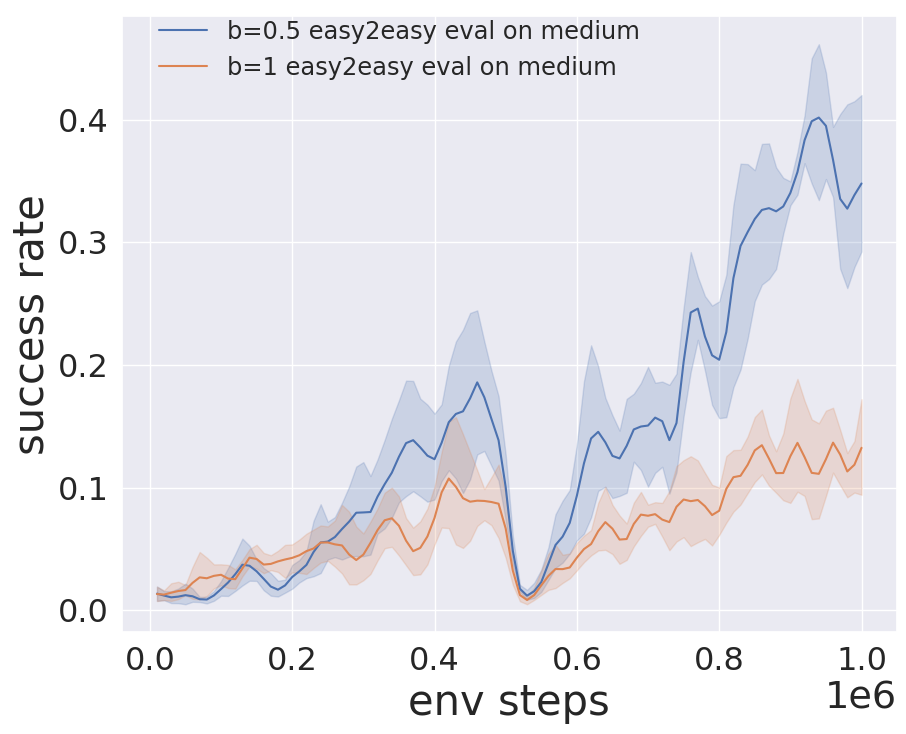

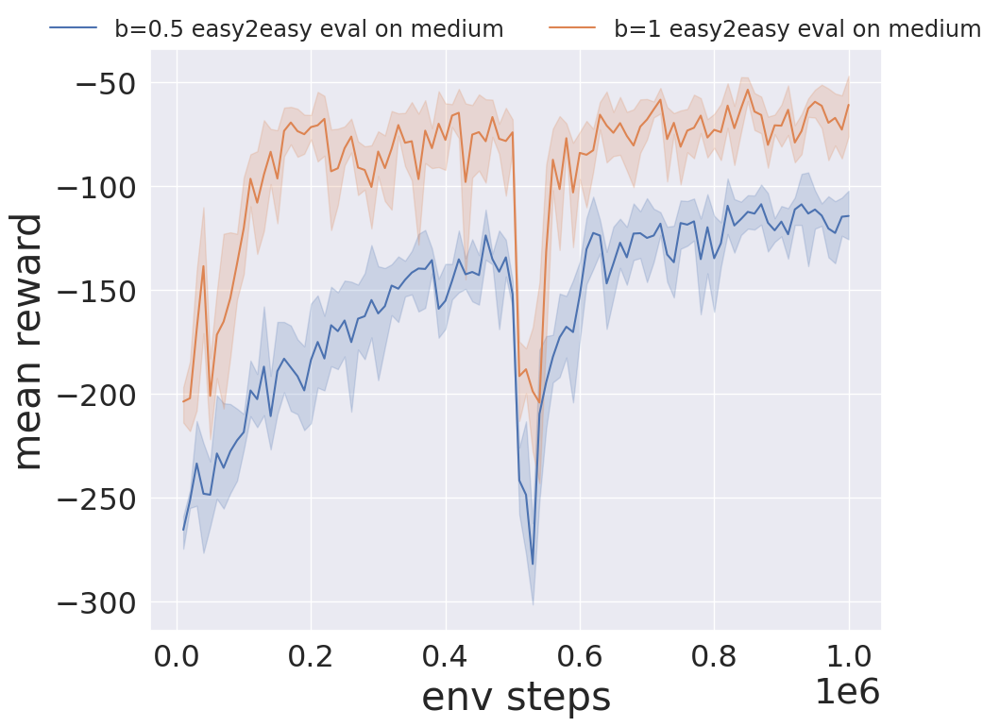

In [38]:
# train on easy eval on medium

first_files = [
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_seed_5_singleRL",
  

]

second_files = [
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_1/sac_10hz_128_128_b_1_5e5steps_b_1_5e5steps_seed_5_singleRL",
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_easy2easy_eval_on_medium = pd.concat([load_two_stage_data("b=1 easy2easy eval on medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_easy2easy_eval_on_medium))


first_files = [
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_seed_5_singleRL",

  

]

second_files = [
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_1_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_2_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_3_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_4_singleRL",
    "D2D/VVC/easy_sac/baseline/evaluate_medium/b_05/sac_10hz_128_128_b_05_5e5steps_b_05_5e5steps_seed_5_singleRL",
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_easy2easy_eval_on_medium = pd.concat([load_two_stage_data("b=0.5 easy2easy eval on medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_easy2easy_eval_on_medium))


data_plot = pd.concat([
df_b_05_easy2easy_eval_on_medium,
df_b_1_easy2easy_eval_on_medium
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_easy2easy_eval_on_medium,
df_b_1_easy2easy_eval_on_medium
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## two stage easy 2 medium

500
500


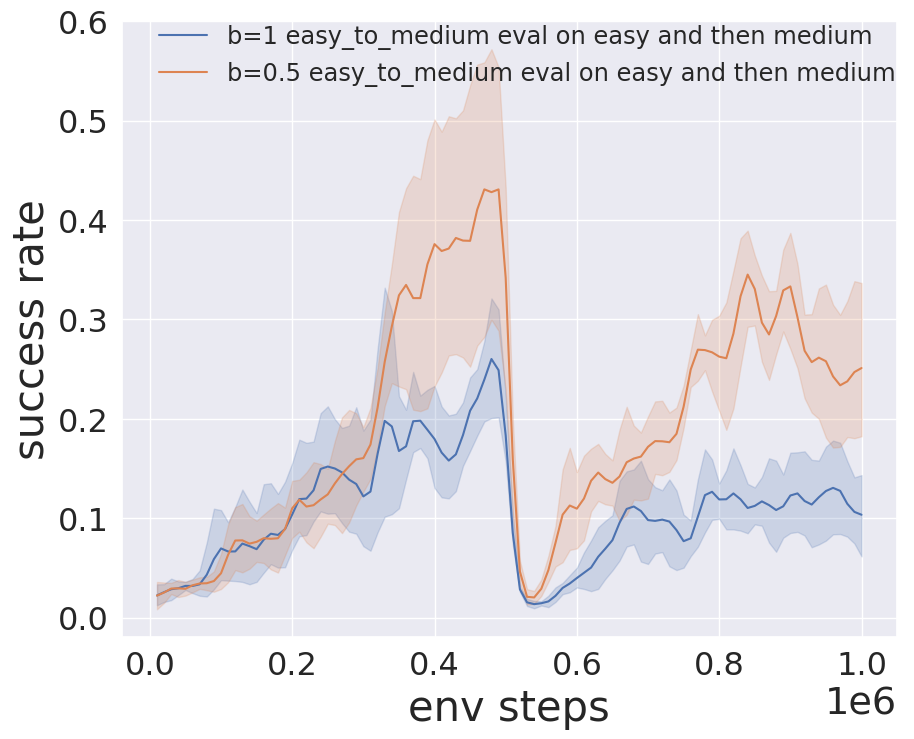

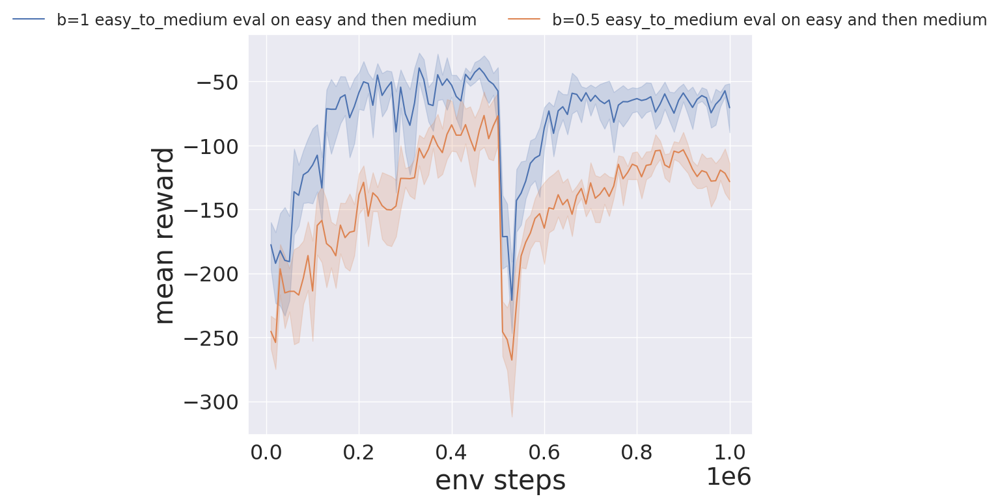

In [39]:
# first train on easy  eval on easy，second  train on medium eval on medium


first_files = [
   "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_1_singleRL",
   "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_2_singleRL",
   "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_3_singleRL",
   "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_4_singleRL",
   "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_1_singleRL", 
    "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_2_singleRL",
    "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_3_singleRL", 
    "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_4_singleRL", 
    "D2D/goal_sapce/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_5_singleRL",    
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_two_stage_easy_to_medium_eval_on_easy_then_medium = pd.concat([load_two_stage_data("b=0.5 easy_to_medium eval on easy and then medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_two_stage_easy_to_medium_eval_on_easy_then_medium))


first_files = [
   "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_5e5steps_seed_1_singleRL",
   "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_5e5steps_seed_2_singleRL",
   "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_5e5steps_seed_3_singleRL",
   "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_5e5steps_seed_4_singleRL",
   "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_5e5steps_seed_5_singleRL",
]
second_files = [
    "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_1_singleRL", 
    "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_2_singleRL", 
    "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_3_singleRL",
    "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_4_singleRL", 
    "D2D/goal_sapce/easy_to_medium/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_5_singleRL",   
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_two_stage_easy_to_medium_eval_on_easy_then_medium = pd.concat([load_two_stage_data("b=1 easy_to_medium eval on easy and then medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_two_stage_easy_to_medium_eval_on_easy_then_medium))



data_plot = pd.concat([
df_b_1_two_stage_easy_to_medium_eval_on_easy_then_medium,
df_b_05_two_stage_easy_to_medium_eval_on_easy_then_medium
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_easy_to_medium_eval_on_easy_then_medium,
df_b_05_two_stage_easy_to_medium_eval_on_easy_then_medium
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## first train on easy, second  train on medium, both eval on medium

500
500


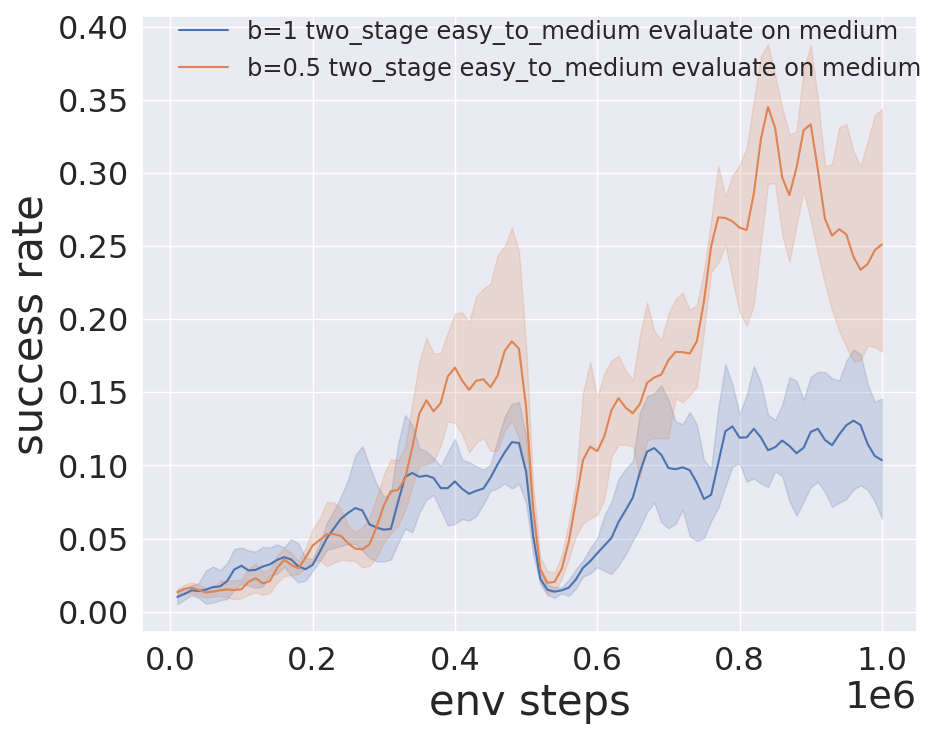

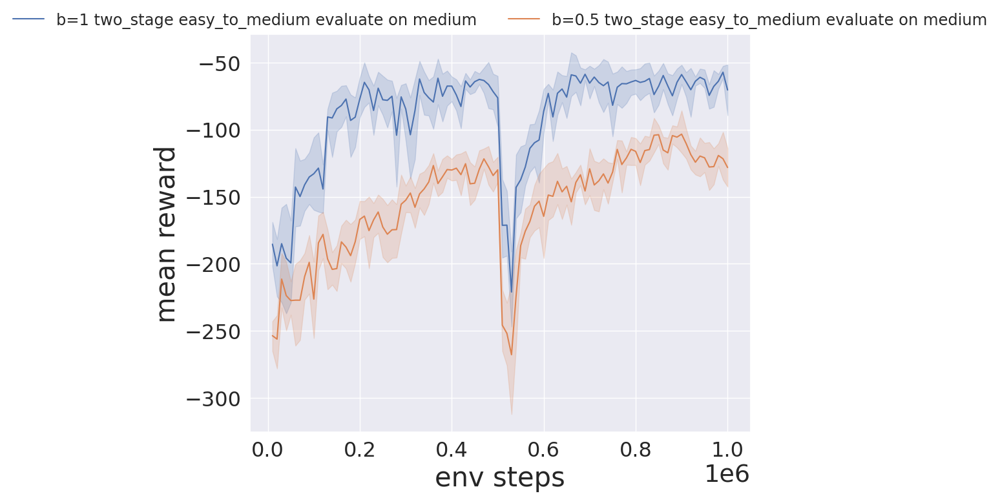

In [40]:
## first train on easy, second  train on medium, both eval on medium
first_files = [
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_5e5steps_seed_1_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_5e5steps_seed_2_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_5e5steps_seed_3_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_5e5steps_seed_4_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_5e5steps_seed_5_singleRL",

]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/sac_10hz_128_128_b_1_easy_to_medium_5e5steps_seed_5_singleRL", 
 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_two_stage_easy_to_medium_evaluate_on_medium = pd.concat([load_two_stage_data("b=1 two_stage easy_to_medium evaluate on medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_two_stage_easy_to_medium_evaluate_on_medium))



first_files = [
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_1_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_2_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_3_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_4_singleRL",
   "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_5e5steps_seed_5_singleRL",


]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_1_singleRL",
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/sac_10hz_128_128_b_05_easy_to_medium_5e5steps_seed_5_singleRL",  

 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_two_stage_easy_to_medium_evaluate_on_medium = pd.concat([load_two_stage_data("b=0.5 two_stage easy_to_medium evaluate on medium", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_two_stage_easy_to_medium_evaluate_on_medium))


data_plot = pd.concat([
df_b_1_two_stage_easy_to_medium_evaluate_on_medium,
df_b_05_two_stage_easy_to_medium_evaluate_on_medium
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_easy_to_medium_evaluate_on_medium,
df_b_05_two_stage_easy_to_medium_evaluate_on_medium
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

# reward devide medium

## One Stage 1e6 only angle reward 

500
500


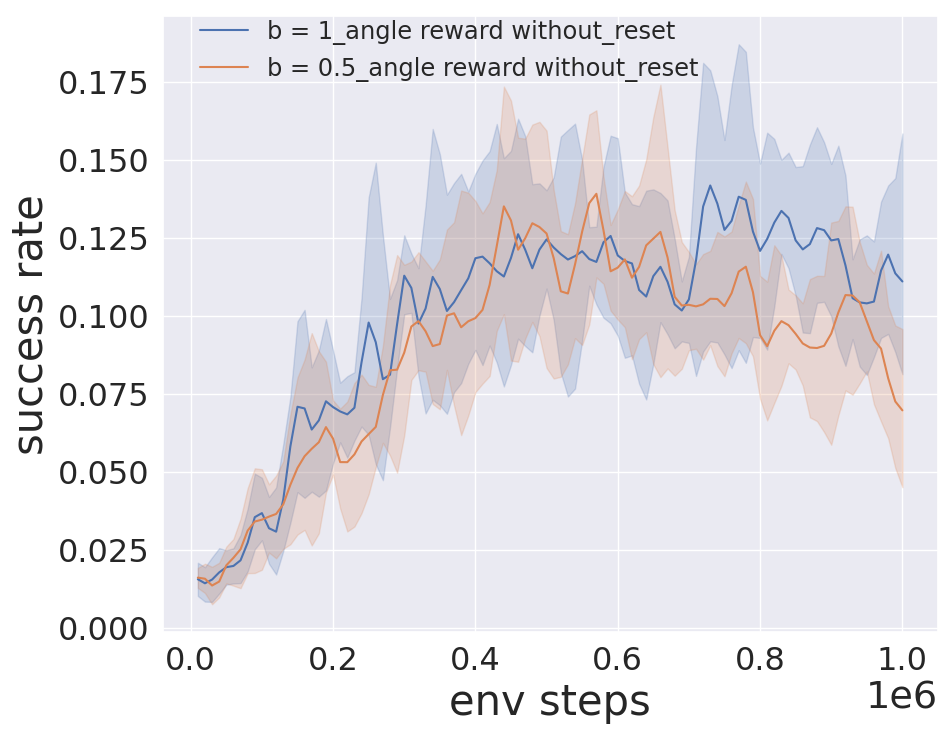

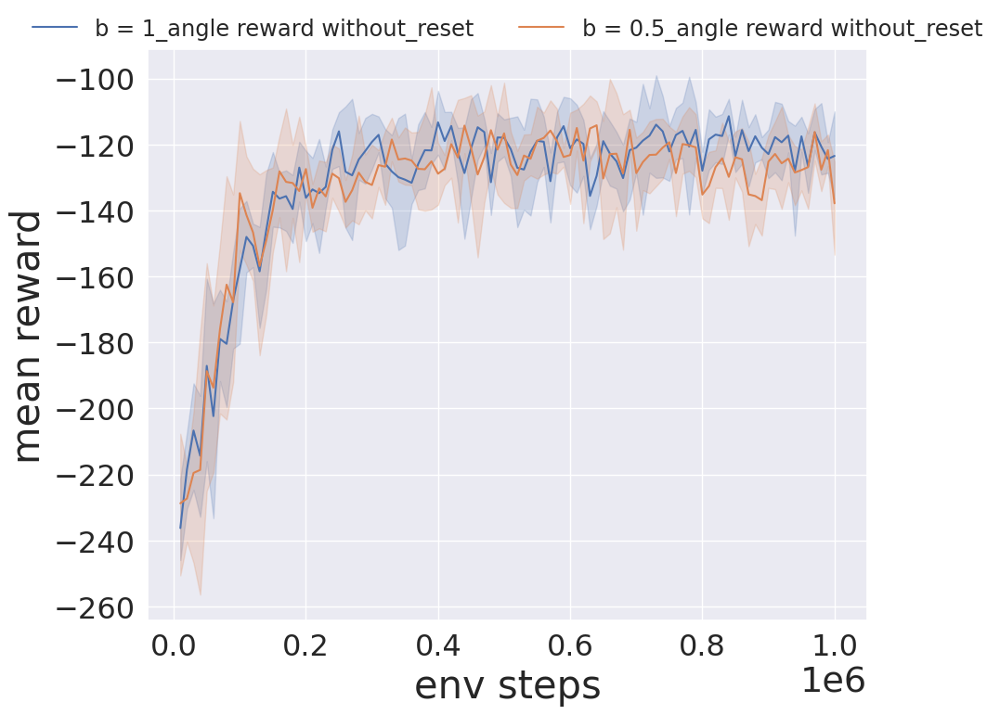

In [41]:
files = [
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_3_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_4_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_5_singleRL", 
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_angle_without_reset_reward  = pd.concat([load_data("b = 1_angle reward without_reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_angle_without_reset_reward))

files = [
    "D2D/reward_devide/medium/b_05_only/sac_10hz_128_128_b_05_angle_only_medium_1e6steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_05_only/sac_10hz_128_128_b_05_angle_only_medium_1e6steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_05_only/sac_10hz_128_128_b_05_angle_only_medium_1e6steps_seed_3_singleRL", 
    "D2D/reward_devide/medium/b_05_only/sac_10hz_128_128_b_05_angle_only_medium_1e6steps_seed_4_singleRL", 
    "D2D/reward_devide/medium/b_05_only/sac_10hz_128_128_b_05_angle_only_medium_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_angle_without_reset_reward  = pd.concat([load_data("b = 0.5_angle reward without_reset", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_05_angle_without_reset_reward))



data_plot = pd.concat([
df_b_1_angle_without_reset_reward,
df_b_05_angle_without_reset_reward
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_angle_without_reset_reward,
df_b_05_angle_without_reset_reward
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

##  two stage  1e6 with reset

## only angle 2 only angle

500
500


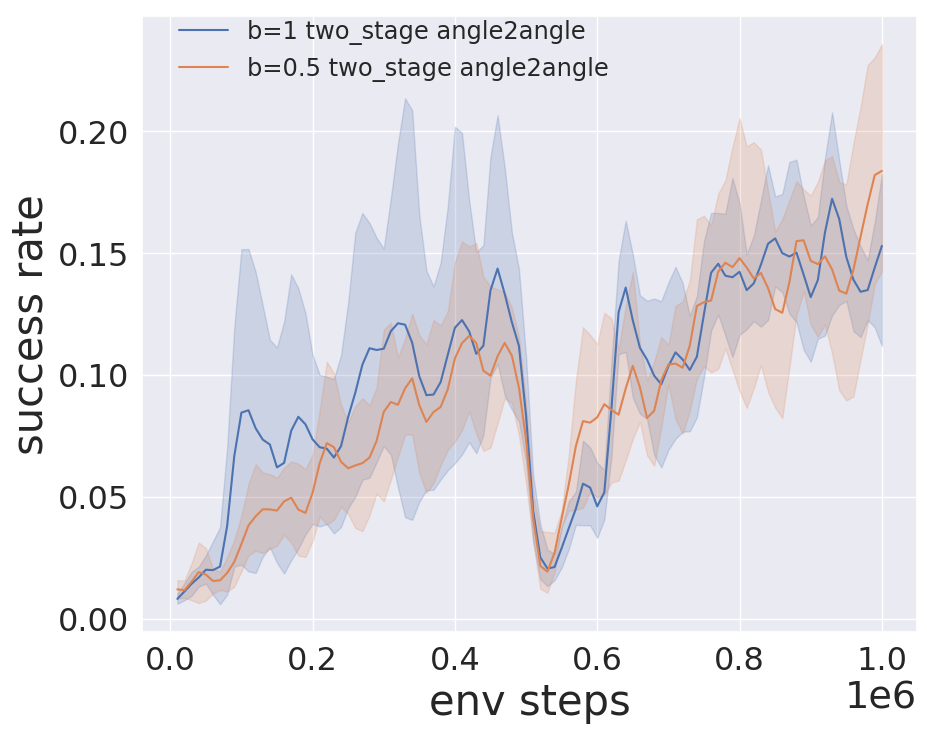

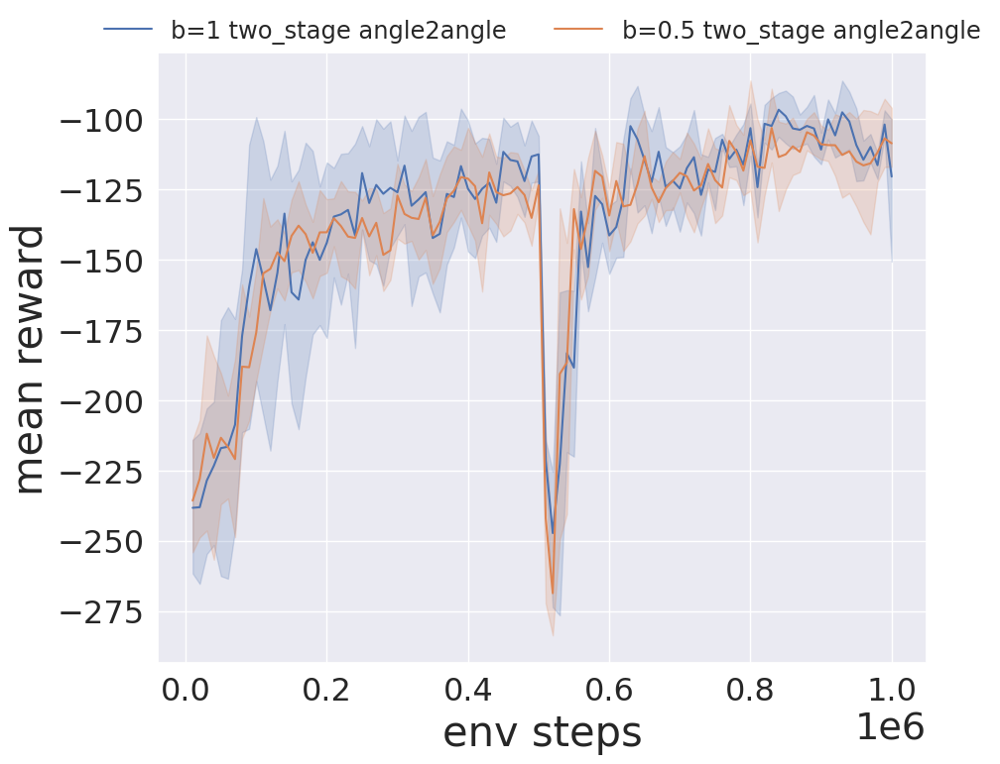

In [42]:
#only angle 2 only angle

first_files = [
   "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_1_singleRL",
   "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_2_singleRL",
   "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_3_singleRL",
   "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_4_singleRL",
   "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_5_singleRL",


]
second_files = [
    "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_to_b_05_only_5e5steps_seed_1_singleRL", 
    "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_to_b_05_only_5e5steps_seed_2_singleRL", 
    "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_to_b_05_only_5e5steps_seed_3_singleRL", 
    "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_to_b_05_only_5e5steps_seed_4_singleRL", 
    "D2D/reward_devide/baseline/b_05/sac_10hz_128_128_b_05_angle_only_to_b_05_only_5e5steps_seed_5_singleRL", 
 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_two_stage_angle_to_angle = pd.concat([load_two_stage_data("b=0.5 two_stage angle2angle", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_two_stage_angle_to_angle))



first_files = [
   "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_1_singleRL",
   "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_2_singleRL",
   "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_3_singleRL",
   "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_4_singleRL",
   "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_5_singleRL",



]
second_files = [
    "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_to_b_1_only_5e5steps_seed_1_singleRL", 
    "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_to_b_1_only_5e5steps_seed_2_singleRL",
    "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_to_b_1_only_5e5steps_seed_3_singleRL",
    "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_to_b_1_only_5e5steps_seed_4_singleRL",
    "D2D/reward_devide/baseline/b_1/sac_10hz_128_128_b_1_angle_only_to_b_1_only_5e5steps_seed_5_singleRL",
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_two_stage_angle_to_angle = pd.concat([load_two_stage_data("b=1 two_stage angle2angle", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_two_stage_angle_to_angle))


data_plot = pd.concat([
df_b_1_two_stage_angle_to_angle,
df_b_05_two_stage_angle_to_angle
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_angle_to_angle,
df_b_05_two_stage_angle_to_angle
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## two stage angle2both with reset

500
500


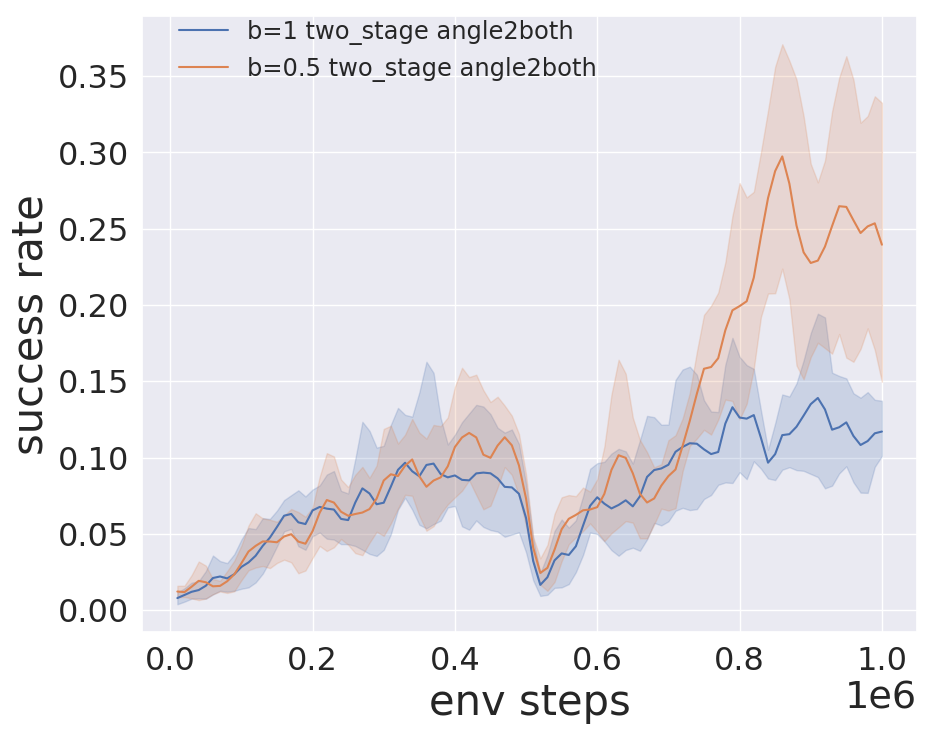

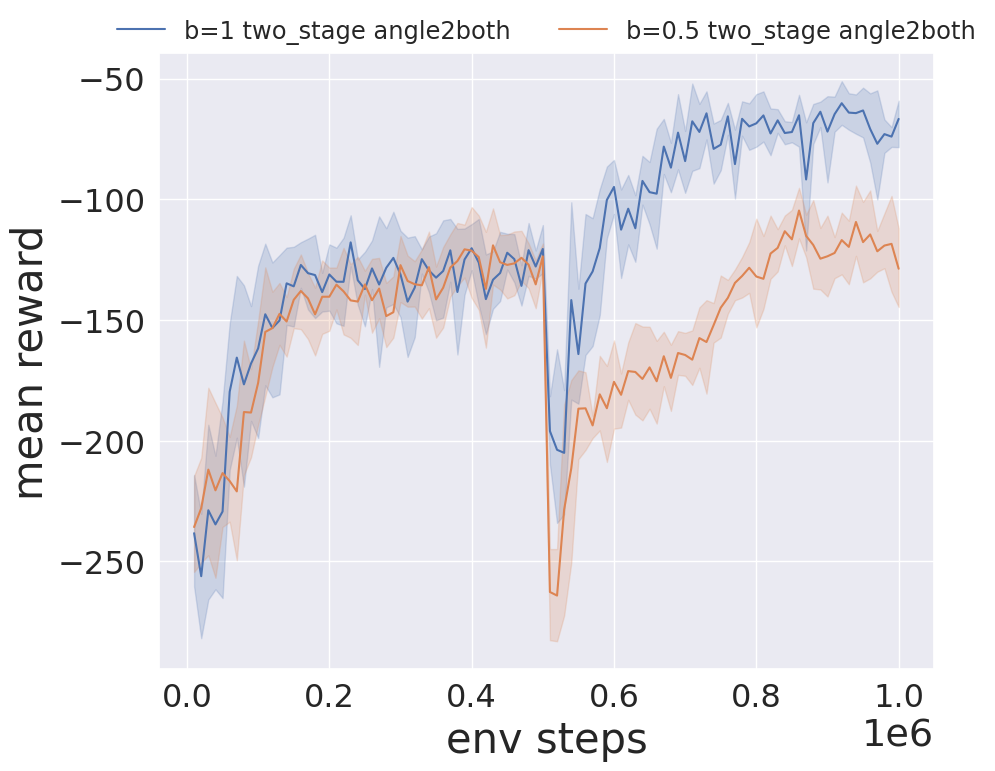

In [43]:
# angle 2 both 1e6
first_files = [
   "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_1_singleRL",
   "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_2_singleRL",
   "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_3_singleRL",
   "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_4_singleRL",
   "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_medium_5e5steps_seed_5_singleRL",

]
second_files = [
    "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_5e5steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_5e5steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_5e5steps_seed_3_singleRL", 
    "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_5e5steps_seed_4_singleRL", 
    "D2D/reward_devide/medium/b_1/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_5e5steps_seed_5_singleRL", 

 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_two_stage_angle_to_both = pd.concat([load_two_stage_data("b=1 two_stage angle2both", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_two_stage_angle_to_both))


# angle 2 both 1e6
first_files = [
   "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_1_singleRL",
   "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_2_singleRL",
   "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_3_singleRL",
   "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_4_singleRL",
   "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_medium_5e5steps_seed_5_singleRL",


]
second_files = [
    "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_to_both_reward_medium_5e5steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_to_both_reward_medium_5e5steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_to_both_reward_medium_5e5steps_seed_3_singleRL",
    "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_to_both_reward_medium_5e5steps_seed_4_singleRL",
    "D2D/reward_devide/medium/b_05/sac_10hz_128_128_b_05_angle_only_to_both_reward_medium_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_two_stage_angle_to_both = pd.concat([load_two_stage_data("b=0.5 two_stage angle2both", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=500000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_two_stage_angle_to_both))


data_plot = pd.concat([
df_b_1_two_stage_angle_to_both,
df_b_05_two_stage_angle_to_both
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_angle_to_both,
df_b_05_two_stage_angle_to_both
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## two stage angle2both with reset 2e6

1000


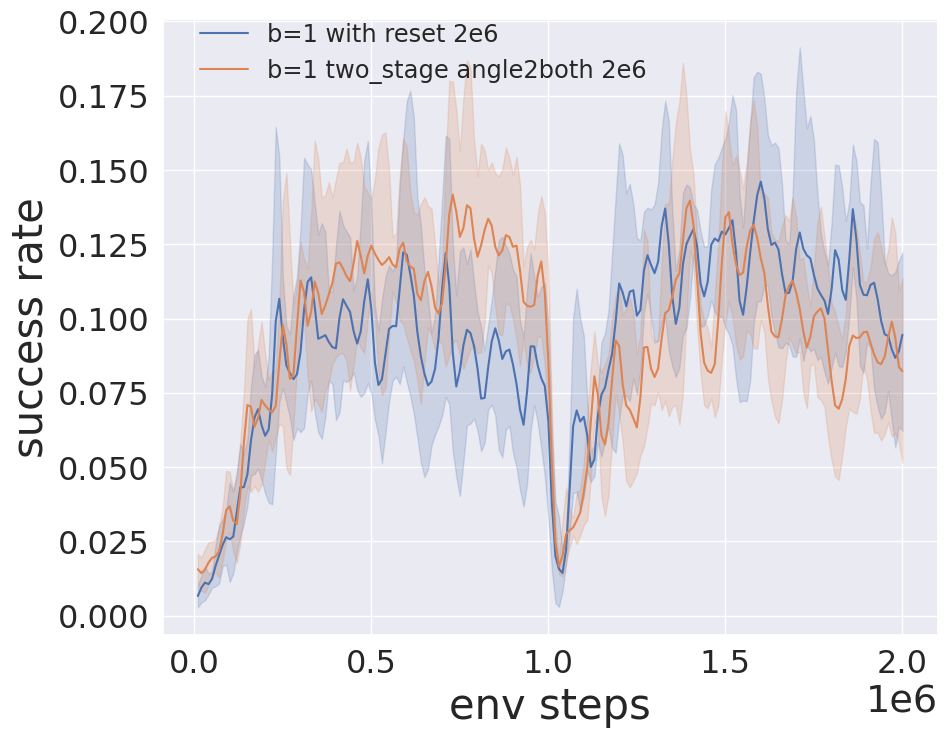

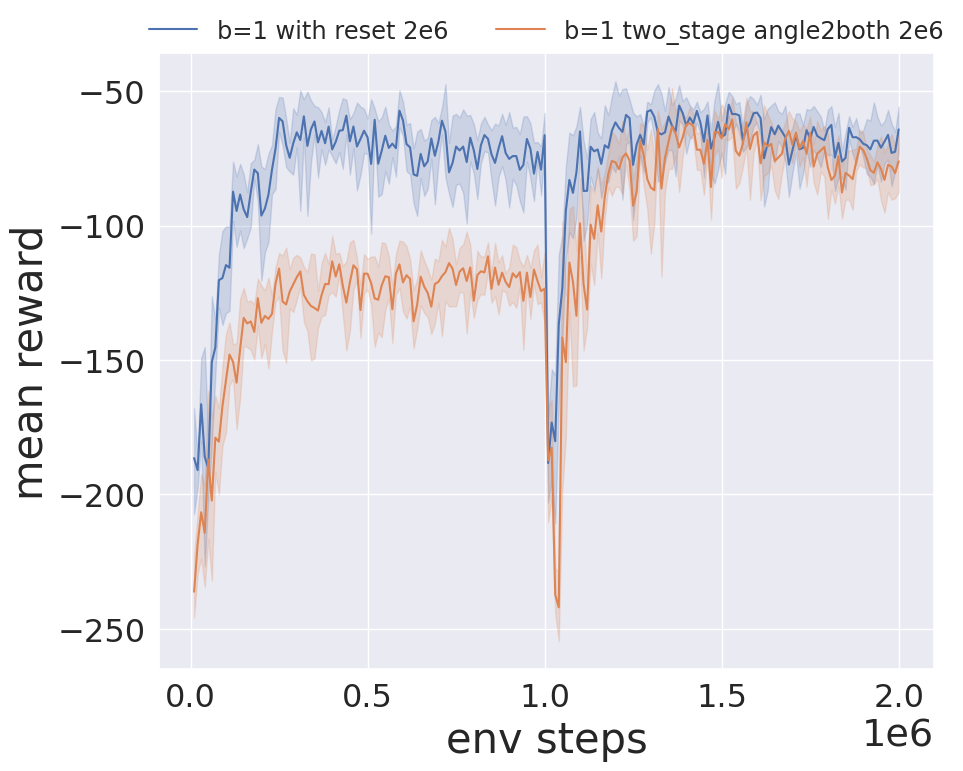

In [44]:
## two stage angle2both with reset 2e6 b = 1

first_files = [
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_3_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_4_singleRL", 
    "D2D/reward_devide/medium/b_1_only/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_5_singleRL", 

]
second_files = [
    "D2D/reward_devide/medium/b_1/2e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_1/2e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_2_singleRL", 
    "D2D/reward_devide/medium/b_1/2e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_3_singleRL", 
    "D2D/reward_devide/medium/b_1/2e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_4_singleRL", 
    "D2D/reward_devide/medium/b_1/2e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_5_singleRL", 

 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_two_stage_angle_to_both_2e6 = pd.concat([load_two_stage_data("b=1 two_stage angle2both 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_two_stage_angle_to_both_2e6))



data_plot = pd.concat([
df_b_1_with_reset_2e6,
df_b_1_two_stage_angle_to_both_2e6
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_with_reset_2e6,
df_b_1_two_stage_angle_to_both_2e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# E2D

## E2D aug1 +aug 4

In [45]:
def load_data_add_step(algo: str, filename: str, seed_str: str, insert_no: int=19, algo_dir: str="rl" ,smooth_success_rate: bool=True, time_steps_add:int=500000):
    df = pd.read_csv(PROJECT_ROOT_DIR / "logs" / algo_dir / filename / "progress.csv")
    df = df[pd.notnull(df["eval/success_rate"])]
    df.insert(insert_no, "seed", [seed_str] * len(df))
    df.insert(insert_no+1, "algo", [algo] * len(df))
    df["time/total_timesteps"] = df["time/total_timesteps"] + time_steps_add

    # 平滑！！！
    if smooth_success_rate:
        # df["eval/success_rate"] = smooth(df["eval/success_rate"], 5)
        df["eval/success_rate"] = gaussian_filter1d(df["eval/success_rate"], sigma=1)

    return df

250
500
250
500


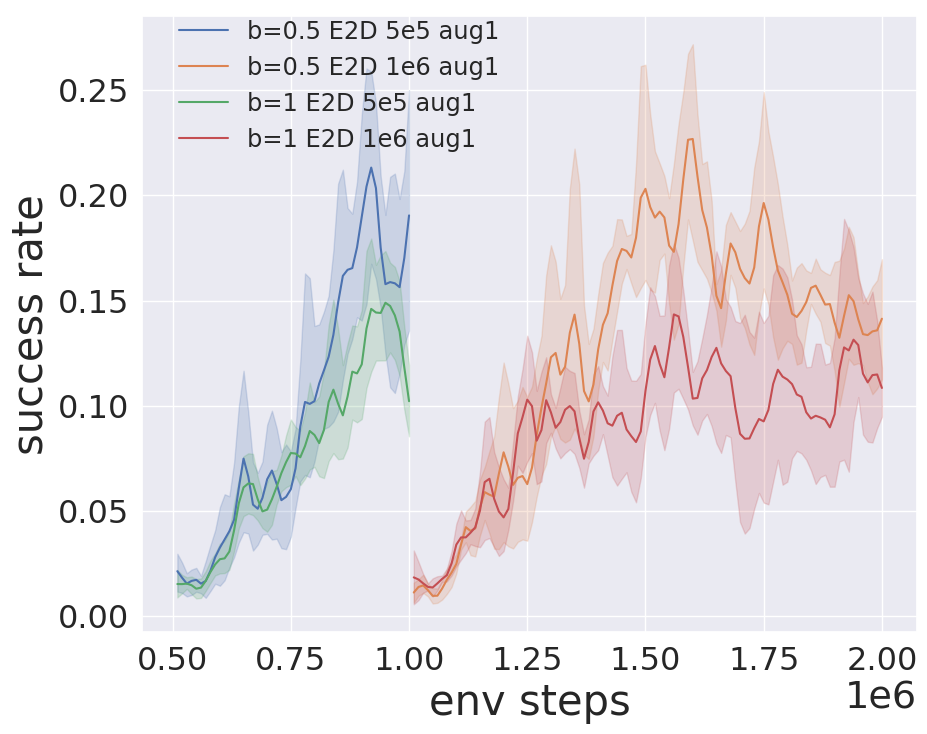

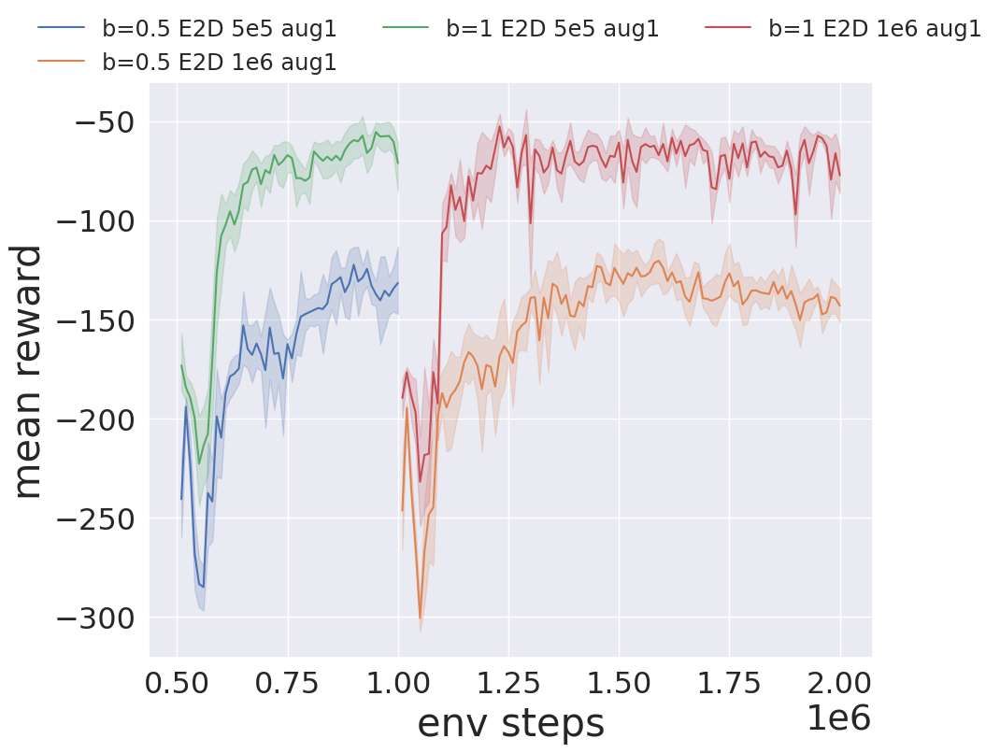

In [50]:
files = [
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_5e5steps_seed_5_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5",


]
df_E2D_b_05_medium_5e5_aug1 = pd.concat([load_data_add_step("b=0.5 E2D 5e5 aug1", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=500000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_05_medium_5e5_aug1))

files = [
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05/sac_medium_10hz_128_128_b_05_1e6steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_05_medium_1e6_aug1 = pd.concat([load_data_add_step("b=0.5 E2D 1e6 aug1", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_05_medium_1e6_aug1))



files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_5_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_6_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_7_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_8_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_9_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_5e5steps_seed_10_singleRL",


]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5",
    "seed 6", 
    "seed 7", 
    "seed 8", 
    "seed 9", 
    "seed 10",


]
df_E2D_b_1_medium_5e5_aug1 = pd.concat([load_data_add_step("b=1 E2D 5e5 aug1", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=500000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_05_medium_5e5_aug1))


files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1/sac_medium_10hz_128_128_b_1_1e6steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_1_medium_1e6_aug1 = pd.concat([load_data_add_step("b=1 E2D 1e6 aug1", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_1_medium_1e6_aug1))


data_plot = pd.concat([
df_E2D_b_05_medium_5e5_aug1,
df_E2D_b_05_medium_1e6_aug1,
df_E2D_b_1_medium_5e5_aug1,
df_E2D_b_1_medium_1e6_aug1
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_E2D_b_05_medium_5e5_aug1,
df_E2D_b_05_medium_1e6_aug1,
df_E2D_b_1_medium_5e5_aug1,
df_E2D_b_1_medium_1e6_aug1
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# E2D aug 4 

250
500
250
500


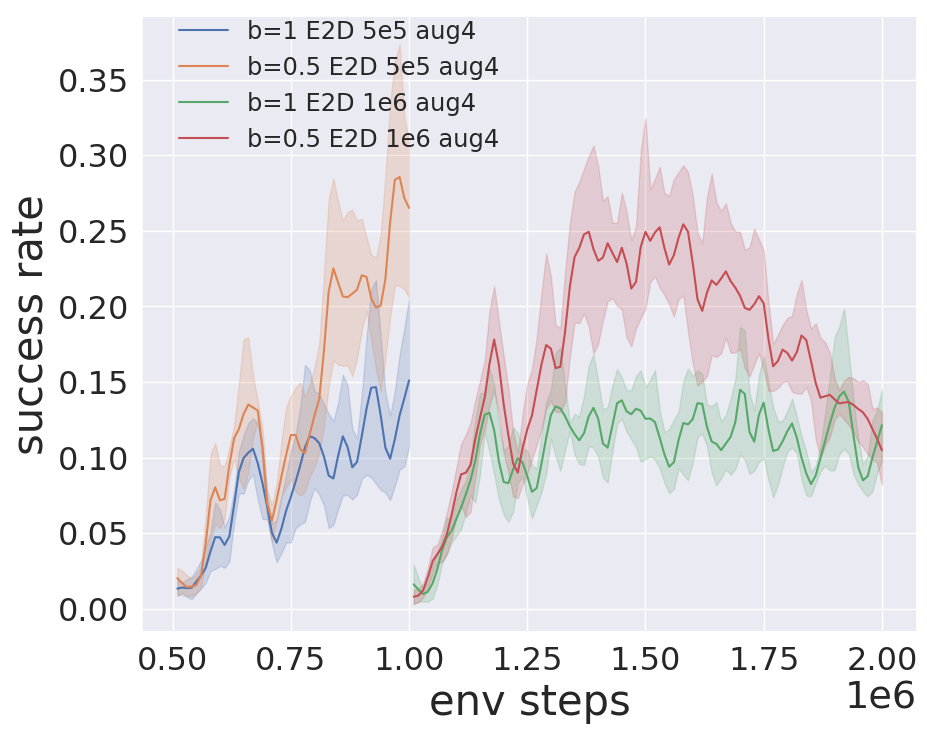

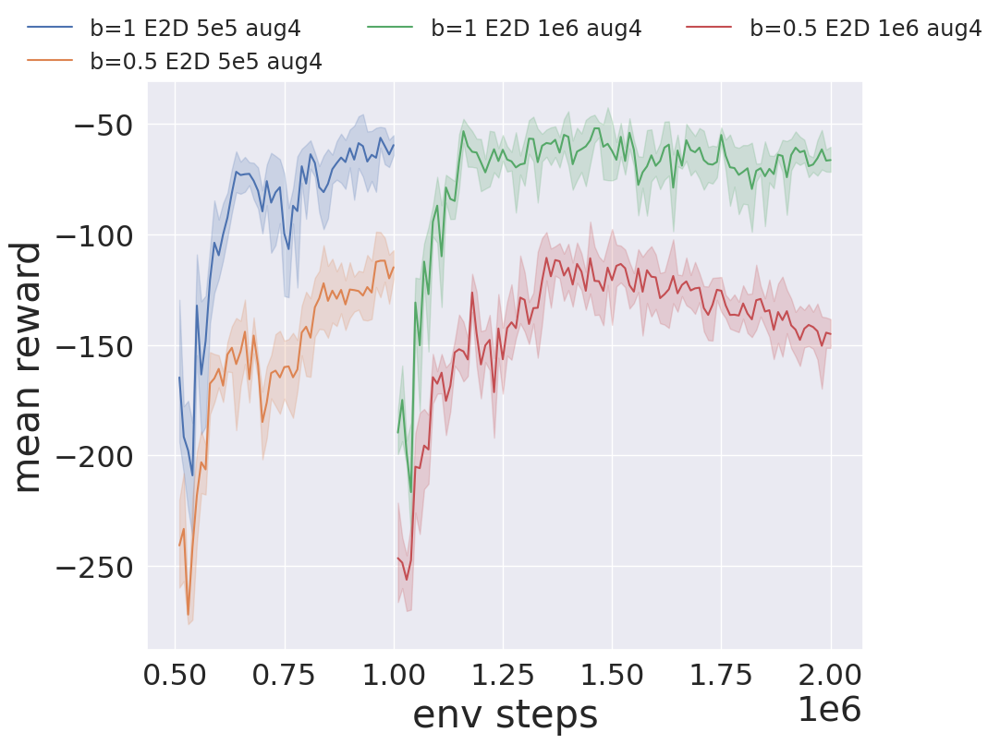

In [46]:
files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_1_medium_5e5_aug4 = pd.concat([load_data_add_step("b=1 E2D 5e5 aug4", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=500000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_1_medium_5e5_aug4))


files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/sac_medium_10hz_128_128_b_1_1e6steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_1_medium_1e6_aug4 = pd.concat([load_data_add_step("b=1 E2D 1e6 aug4", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_1_medium_1e6_aug4))


files = [
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_5e5steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_5e5steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_5e5steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_5e5steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_5e5steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_05_medium_5e5_aug4 = pd.concat([load_data_add_step("b=0.5 E2D 5e5 aug4", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=500000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_05_medium_5e5_aug4))


files = [
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
    "D2D/VVC/medium/sac/E2D_medium_b_05_aug4/sac_medium_10hz_128_128_b_05_1e6steps_seed_5_singleRL",

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_E2D_b_05_medium_1e6_aug4 = pd.concat([load_data_add_step("b=0.5 E2D 1e6 aug4", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_E2D_b_05_medium_1e6_aug4))


data_plot = pd.concat([
df_E2D_b_1_medium_5e5_aug4,
df_E2D_b_05_medium_5e5_aug4,
df_E2D_b_1_medium_1e6_aug4,
df_E2D_b_05_medium_1e6_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_E2D_b_1_medium_5e5_aug4,
df_E2D_b_05_medium_5e5_aug4,
df_E2D_b_1_medium_1e6_aug4,
df_E2D_b_05_medium_1e6_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

******
# Start Compare  and Draw Picture

## D2D

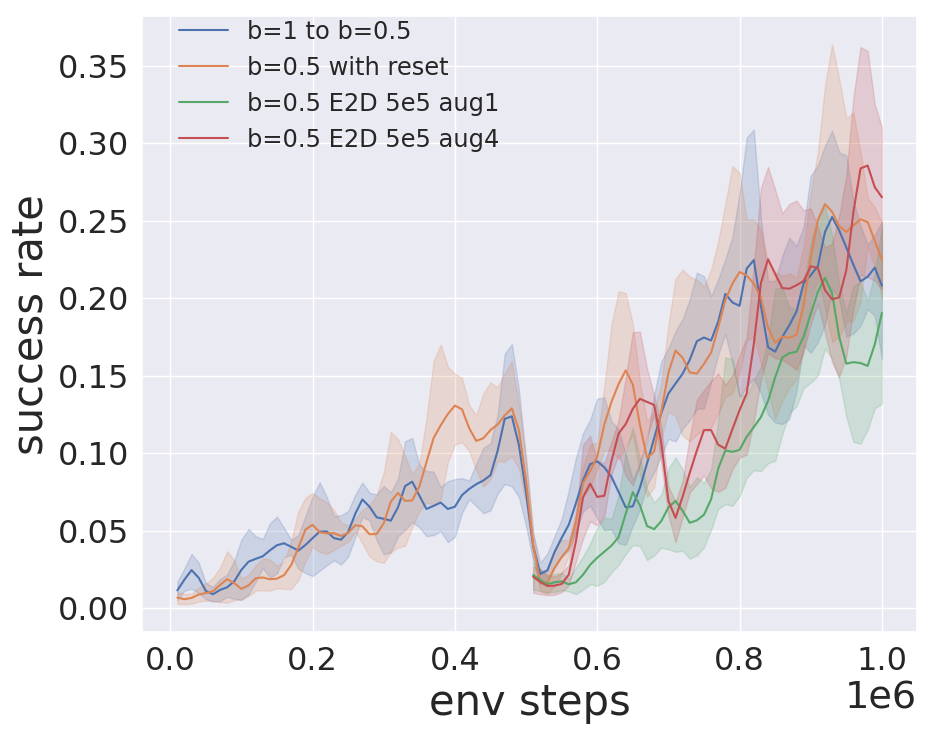

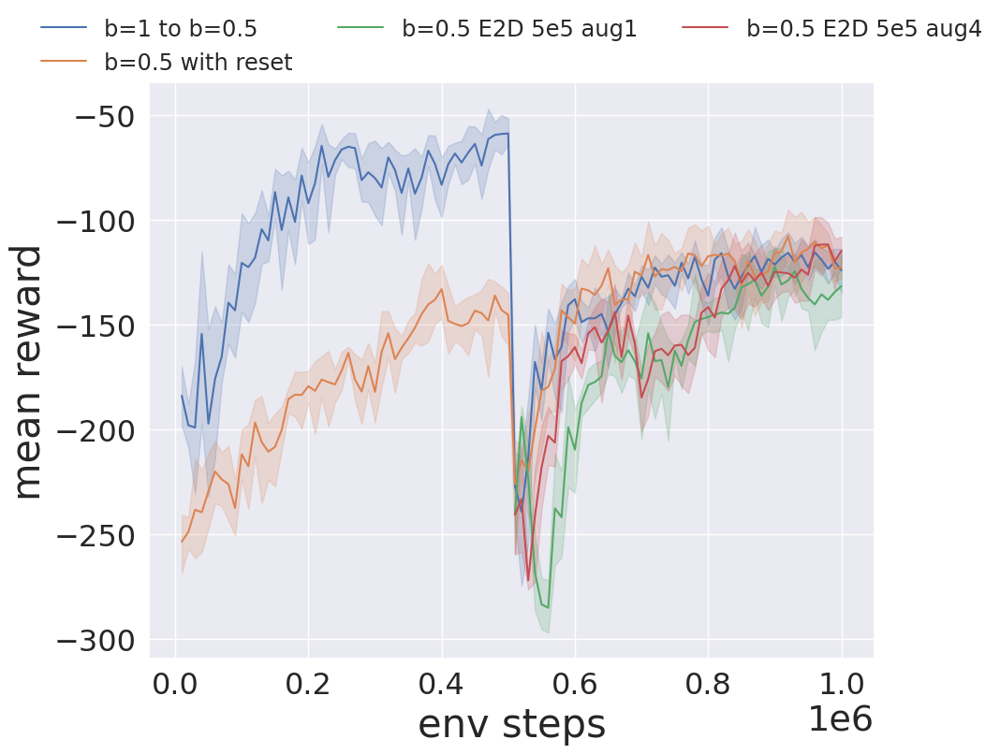

In [51]:
# b1 to b05
data_plot = pd.concat([
df_two_stage_b_1_b05,
#df_b_1_with_reset,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug1,
df_E2D_b_05_medium_5e5_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_b05,
#df_b_1_with_reset,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug1,
df_E2D_b_05_medium_5e5_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

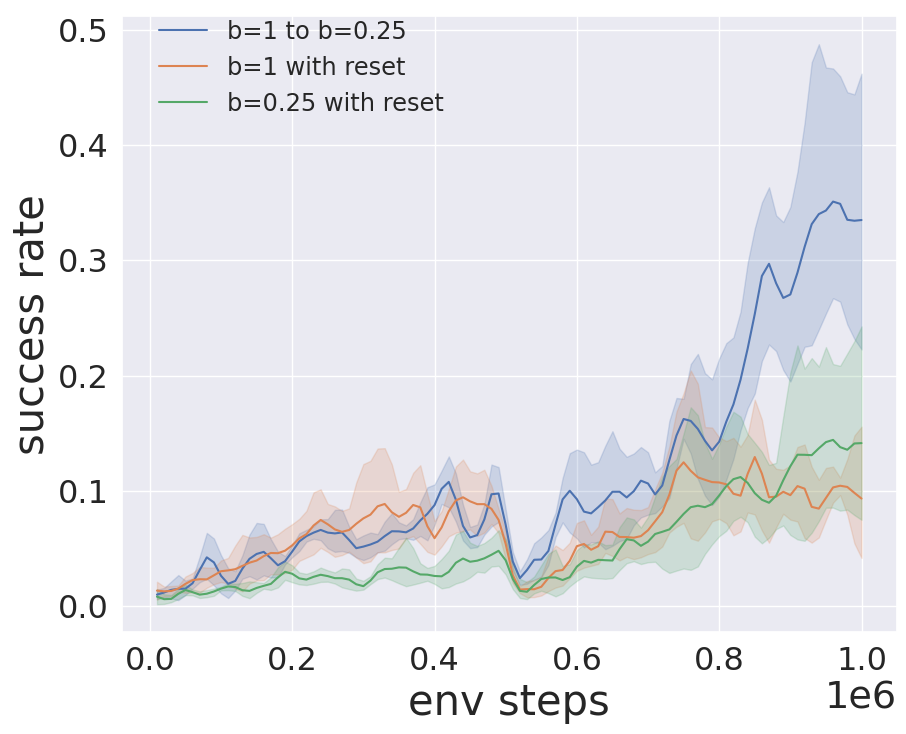

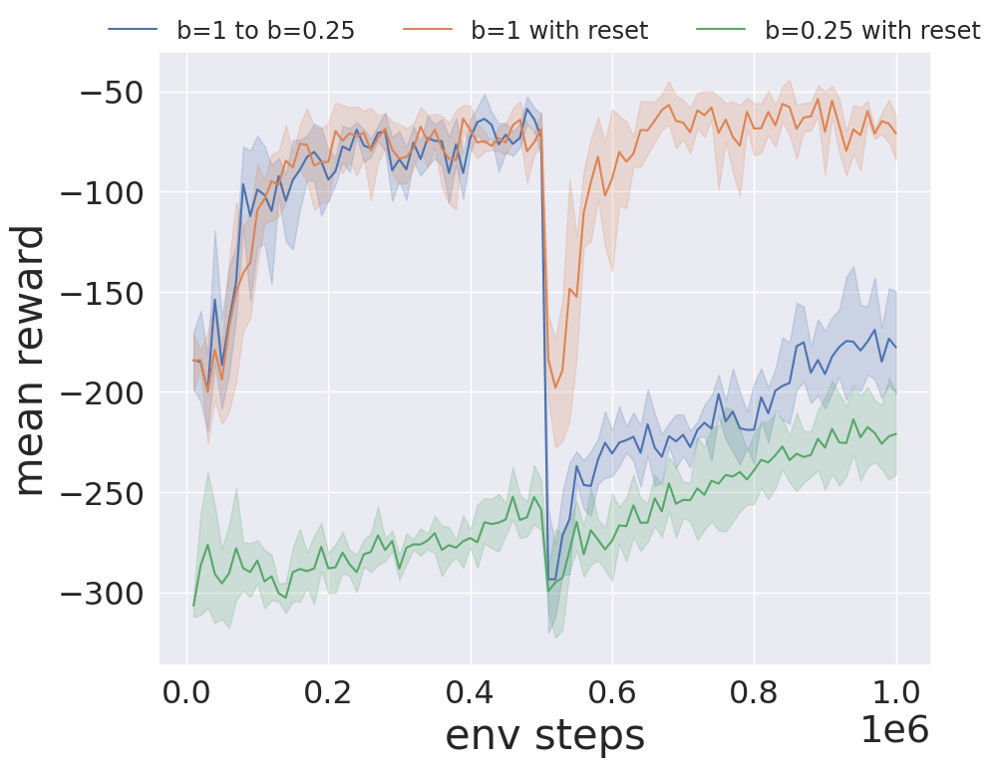

In [52]:
# b1 to b0.25
data_plot = pd.concat([
df_two_stage_b_1_b025,
df_b_1_with_reset,
df_b_025_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_b025,
df_b_1_with_reset,
df_b_025_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

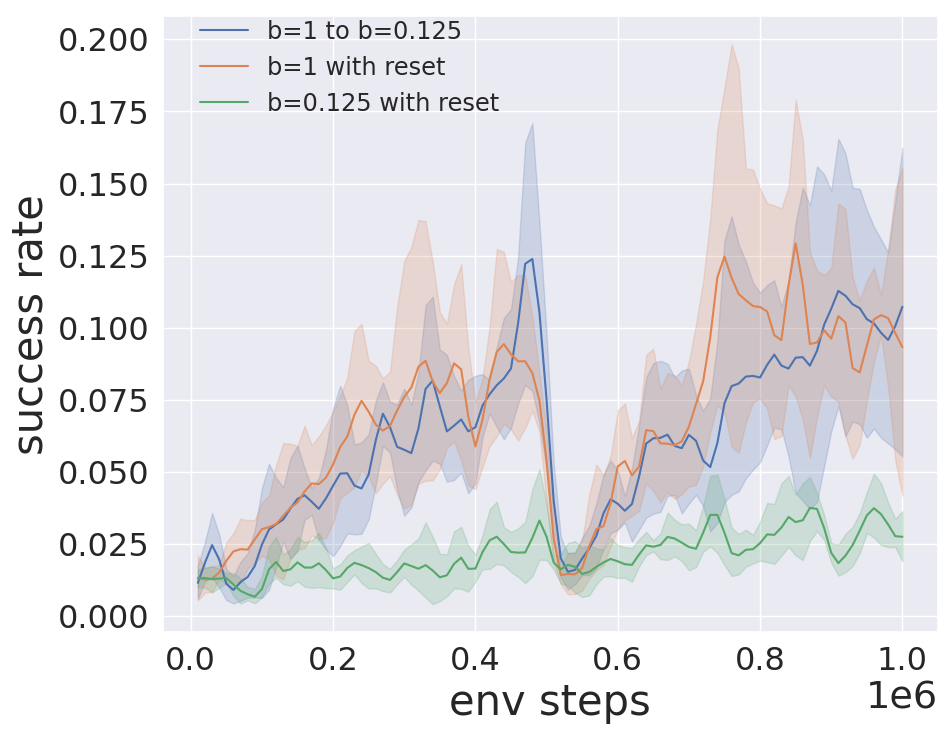

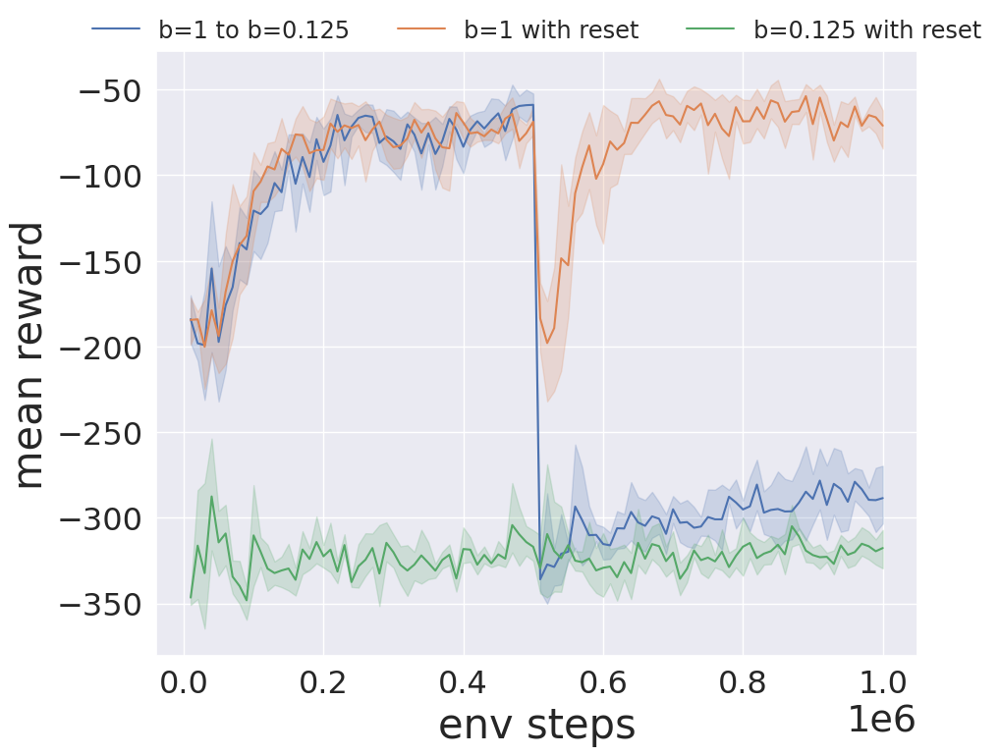

In [53]:
# b1 to b0.125
data_plot = pd.concat([
df_two_stage_b_1_b0125,
df_b_1_with_reset,
df_b_0125_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_b0125,
df_b_1_with_reset,
df_b_0125_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## b = 0.5 to b = X

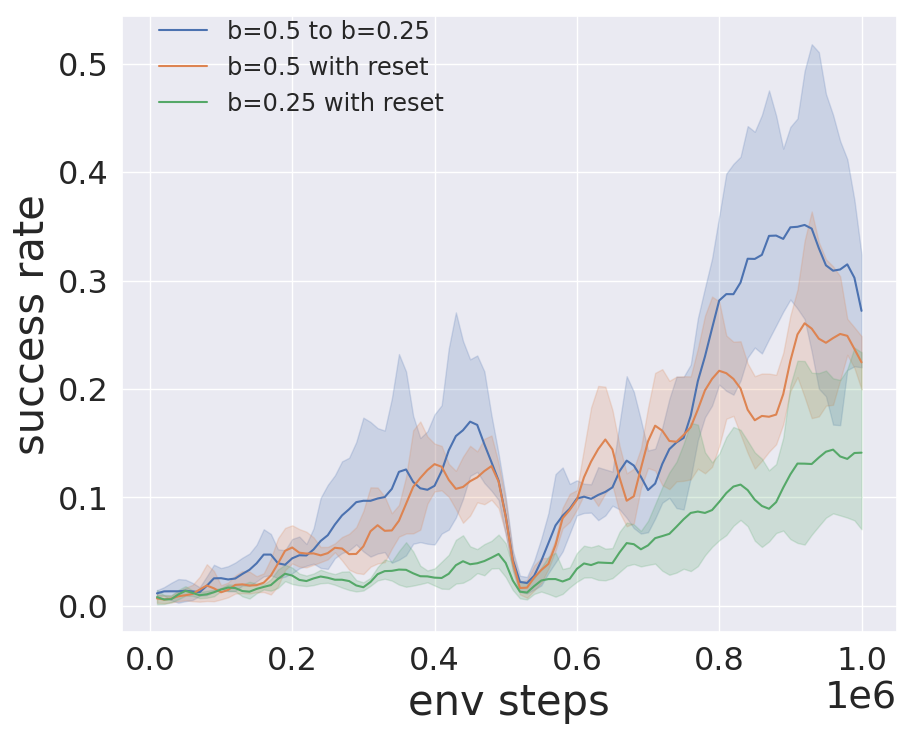

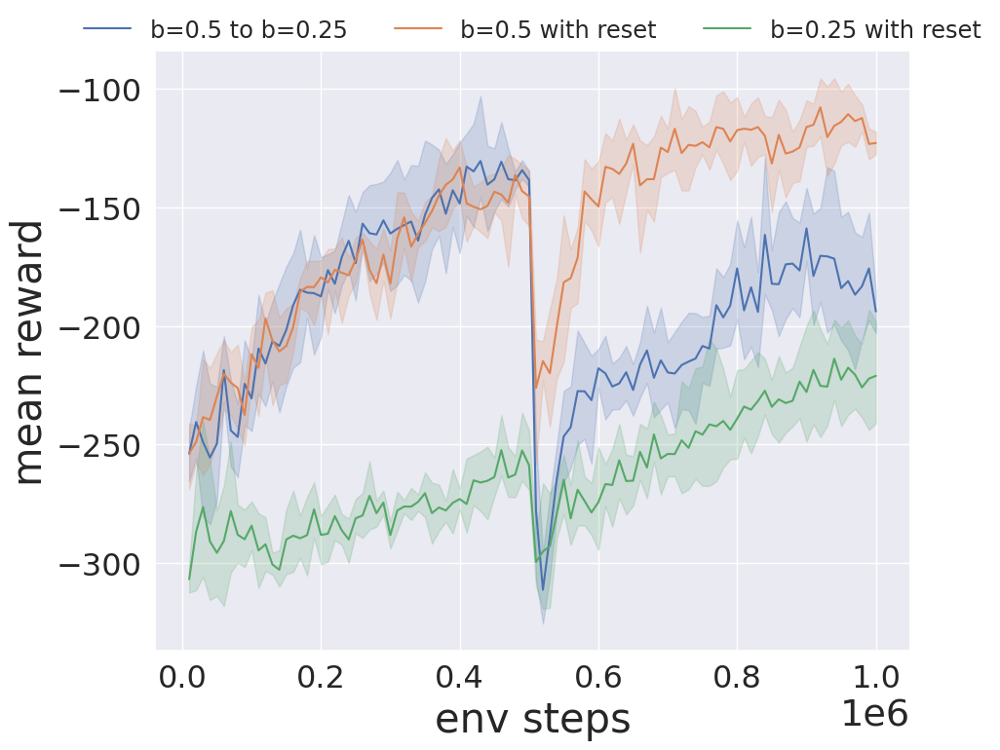

In [54]:
# b0.5 to b0.25
data_plot = pd.concat([
df_two_stage_b_05_b025,
df_b_05_with_reset,
df_b_025_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_b025,
df_b_05_with_reset,
df_b_025_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

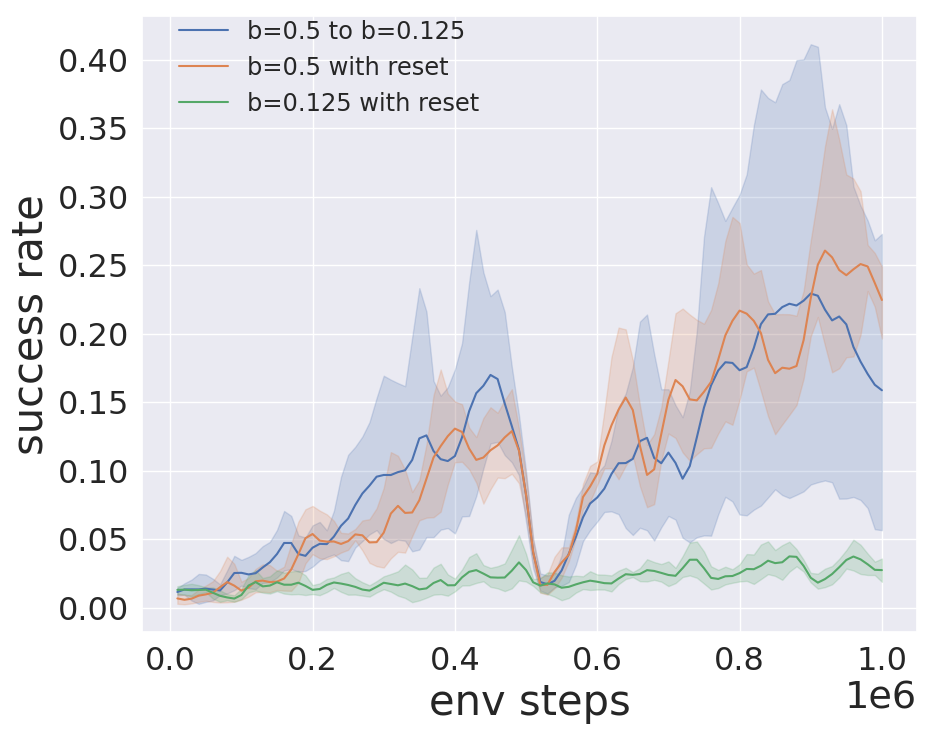

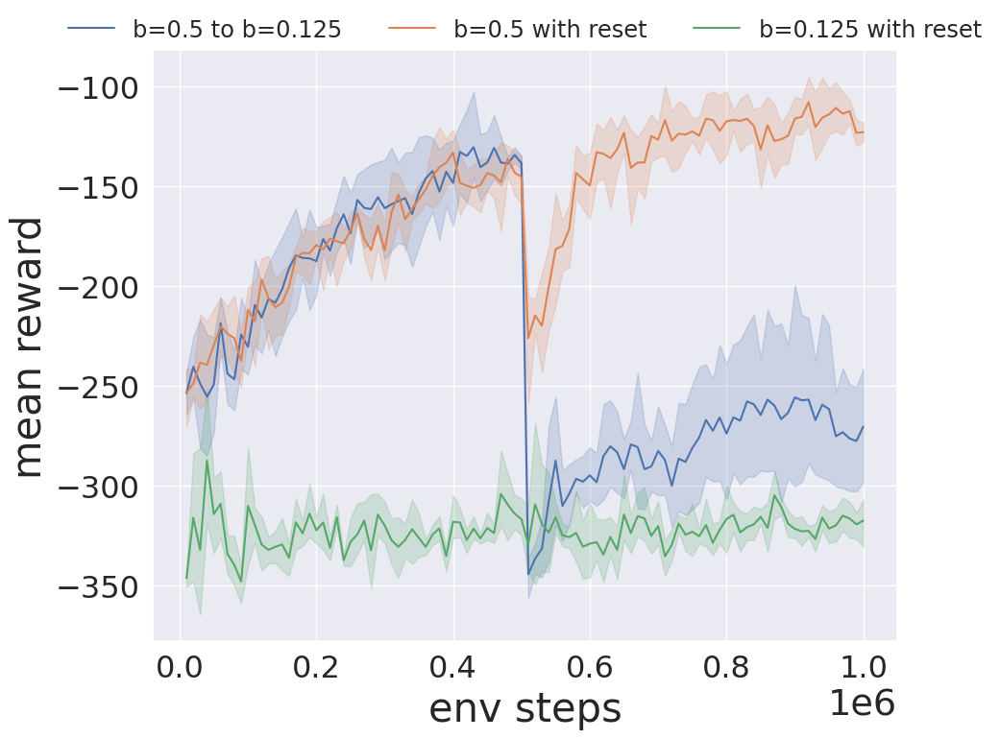

In [55]:
# b0.5 to b0.125
data_plot = pd.concat([
df_two_stage_b_05_b0125,
df_b_05_with_reset,
df_b_0125_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_b0125,
df_b_05_with_reset,
df_b_0125_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

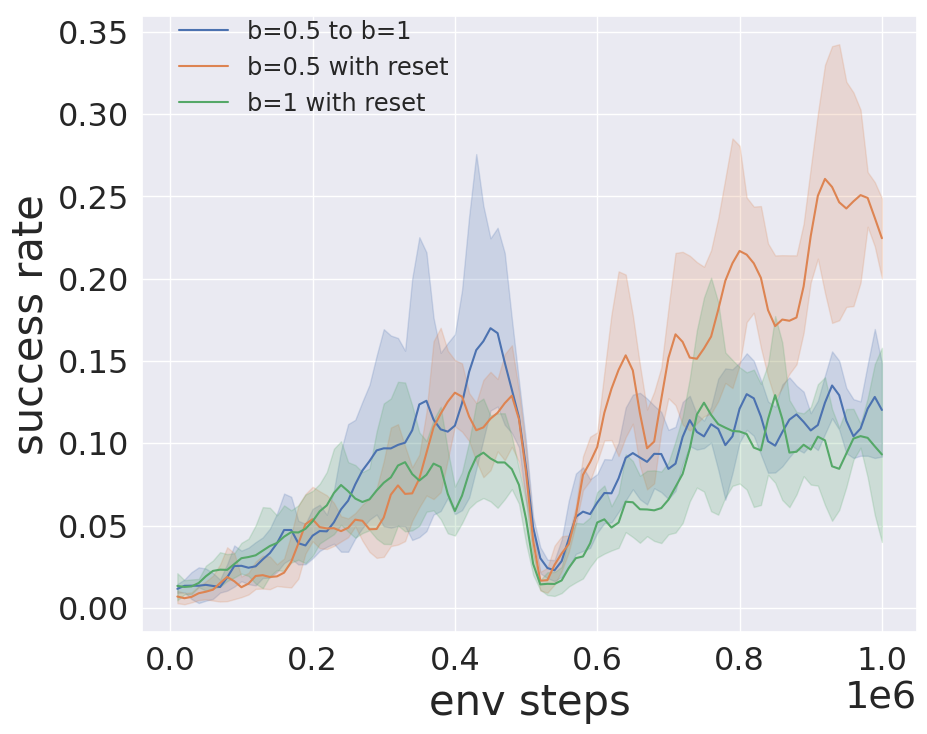

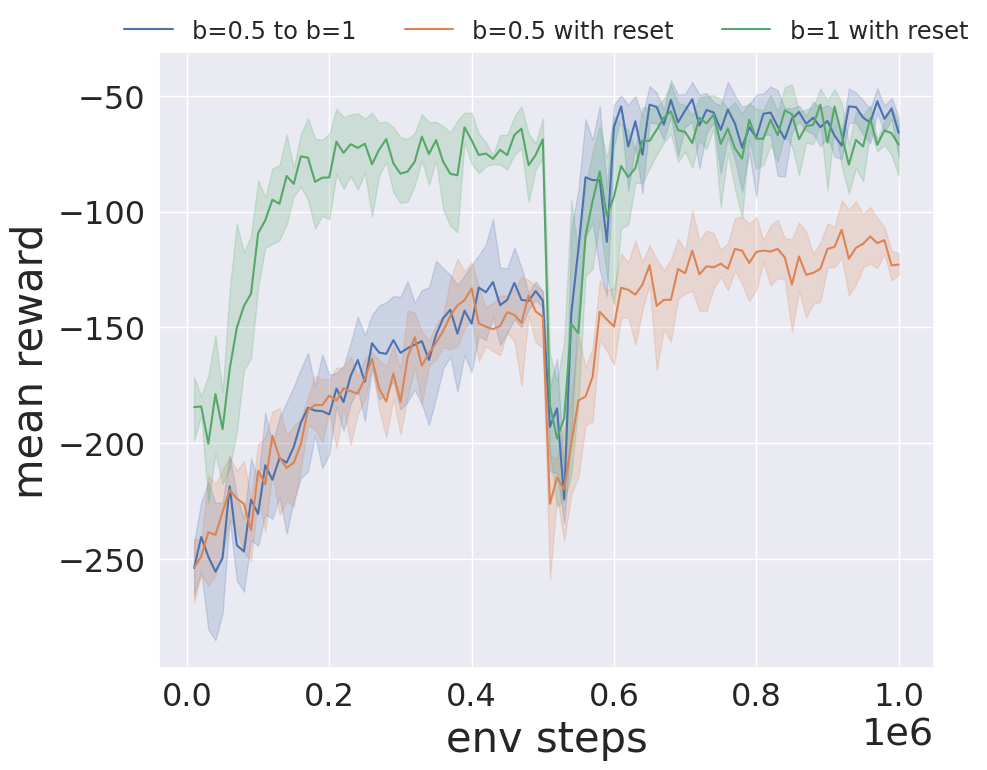

In [56]:
# b0.5 to b1
data_plot = pd.concat([
df_two_stage_b_05_b1,
df_b_05_with_reset,
df_b_1_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_b1,
df_b_05_with_reset,
df_b_1_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

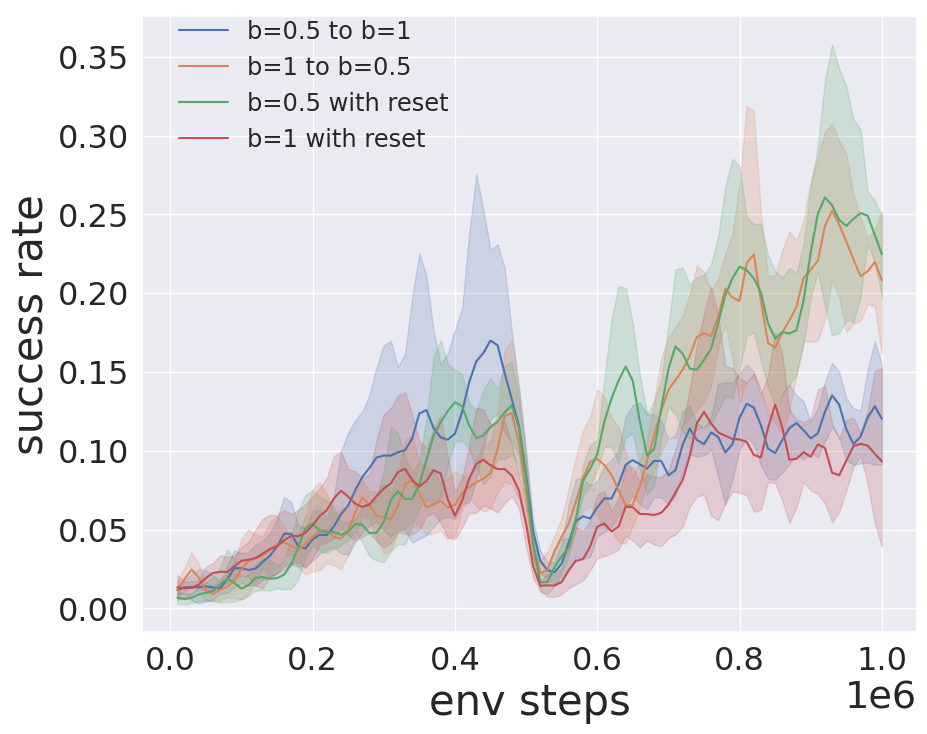

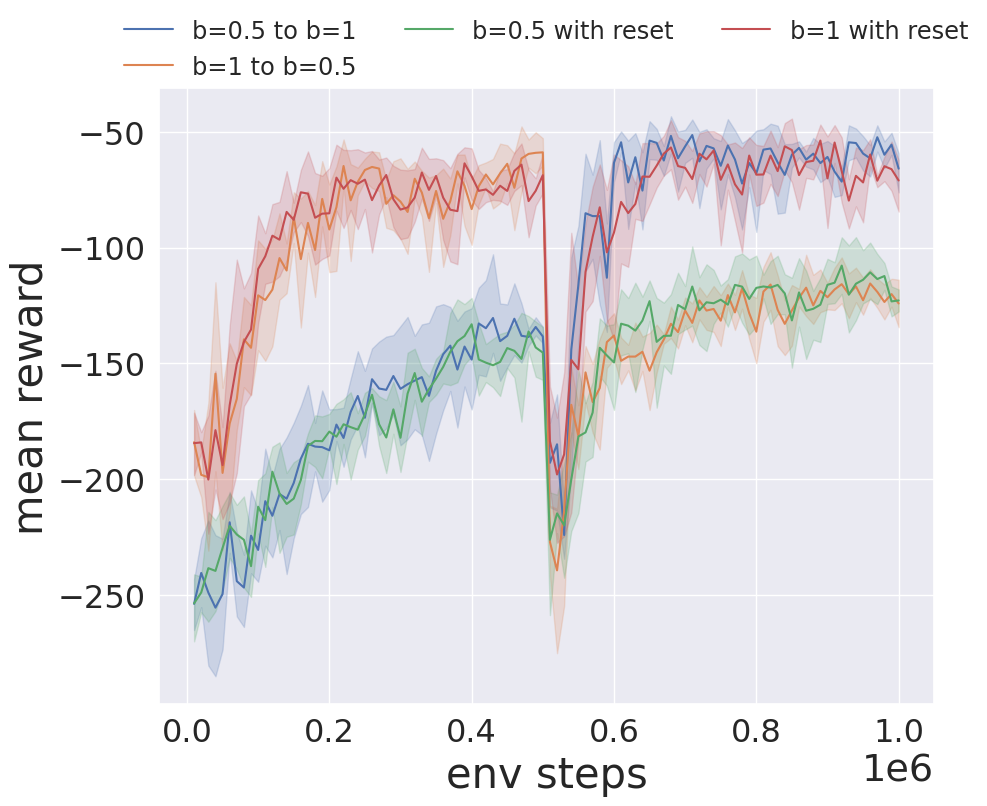

In [57]:
# b0.5 to b1
data_plot = pd.concat([
df_two_stage_b_05_b1,
df_two_stage_b_1_b05,
df_b_05_with_reset,
df_b_1_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_b1,
df_two_stage_b_1_b05,
df_b_05_with_reset,
df_b_1_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

# change gamma

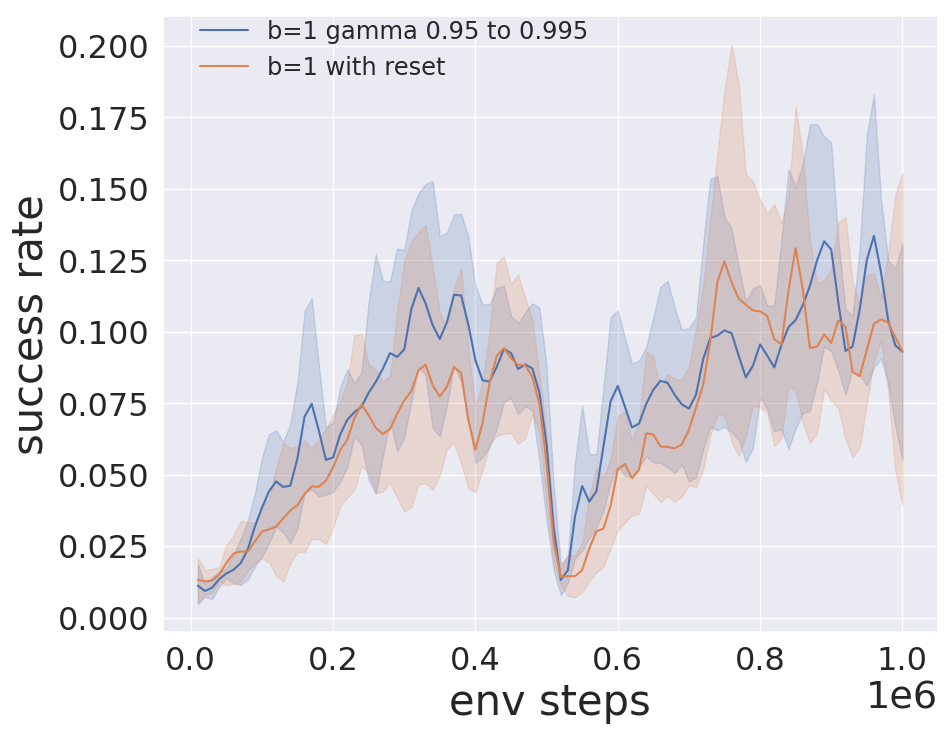

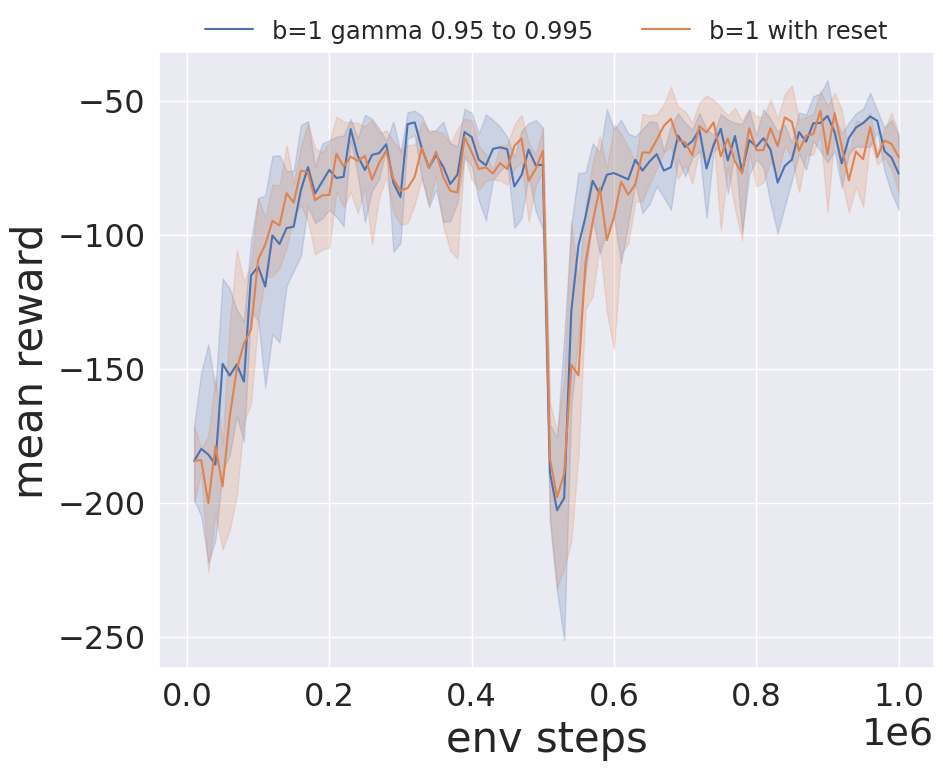

In [58]:
# b0.5 to b1
data_plot = pd.concat([
df_two_stage_b_1_gamma095to0995,
df_b_1_with_reset,

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_gamma095to0995,
df_b_1_with_reset,
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## F2F

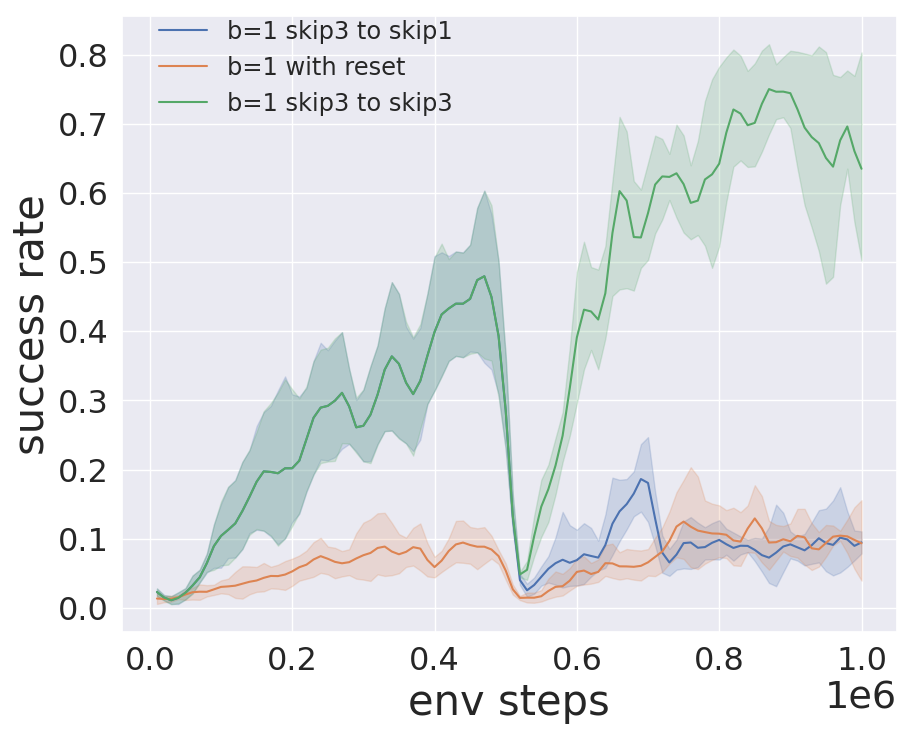

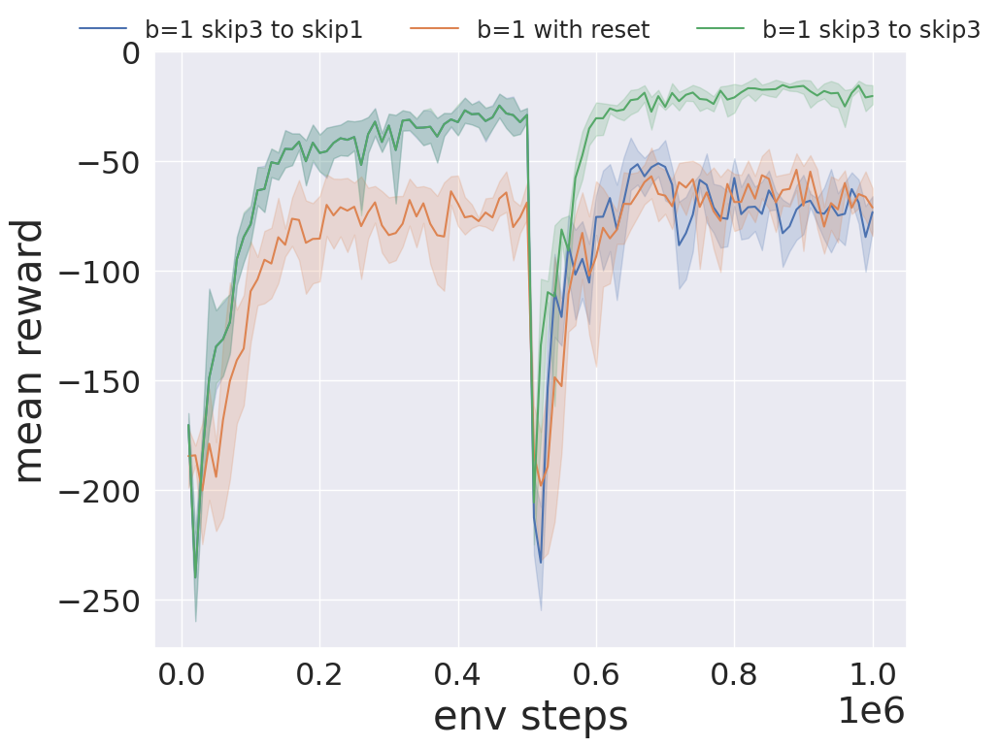

In [59]:
# skip 3 to skip 1
data_plot = pd.concat([
df_two_stage_b_1_skip3_skip1,
df_b_1_with_reset,
df_two_stage_b_1_skip3_skip3
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip3_skip1,
df_b_1_with_reset,
df_two_stage_b_1_skip3_skip3

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

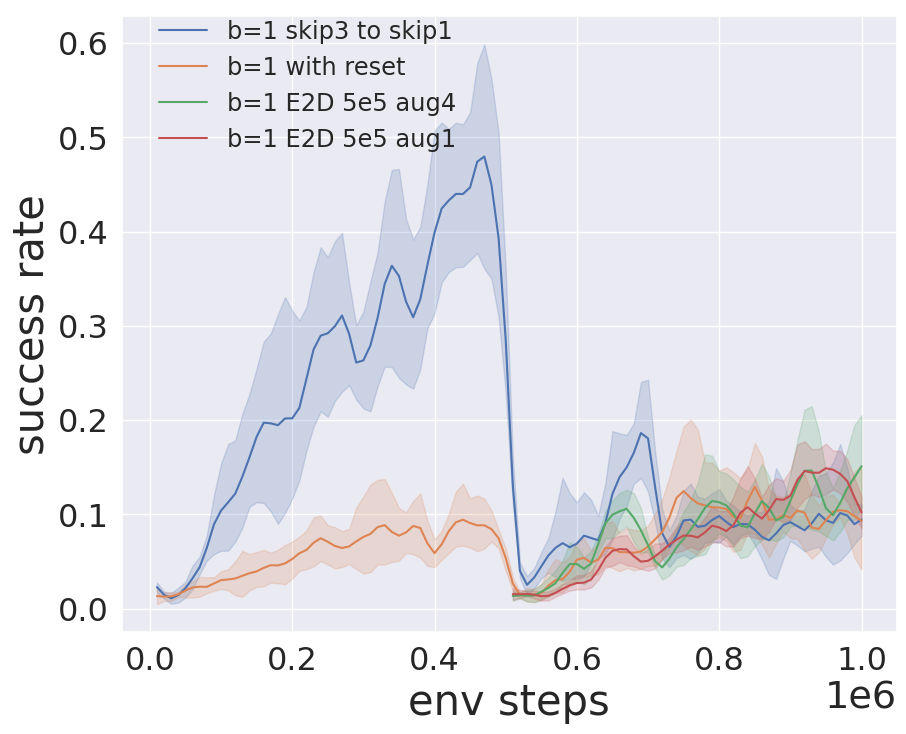

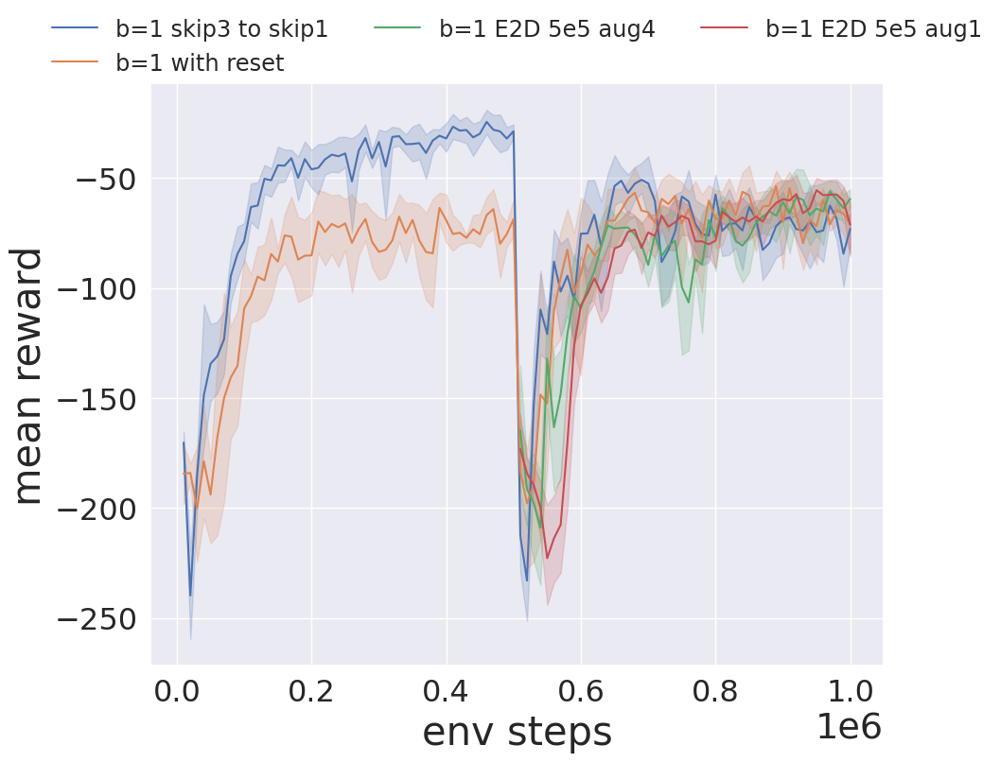

In [60]:
# skip 3 to skip 1
data_plot = pd.concat([
df_two_stage_b_1_skip3_skip1,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4,
df_E2D_b_1_medium_5e5_aug1
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip3_skip1,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4,
df_E2D_b_1_medium_5e5_aug1

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

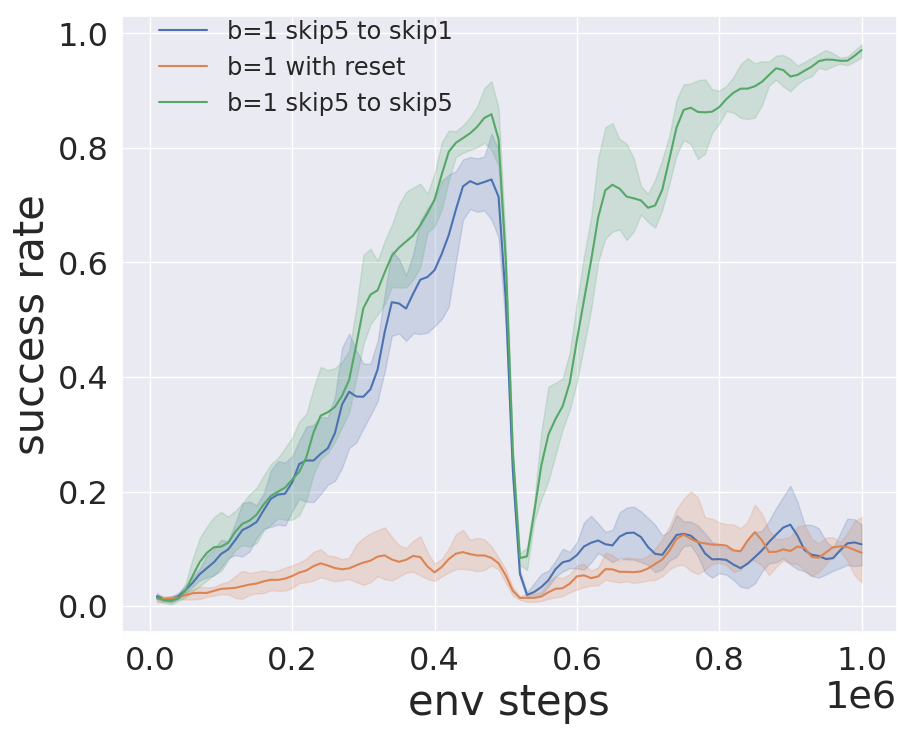

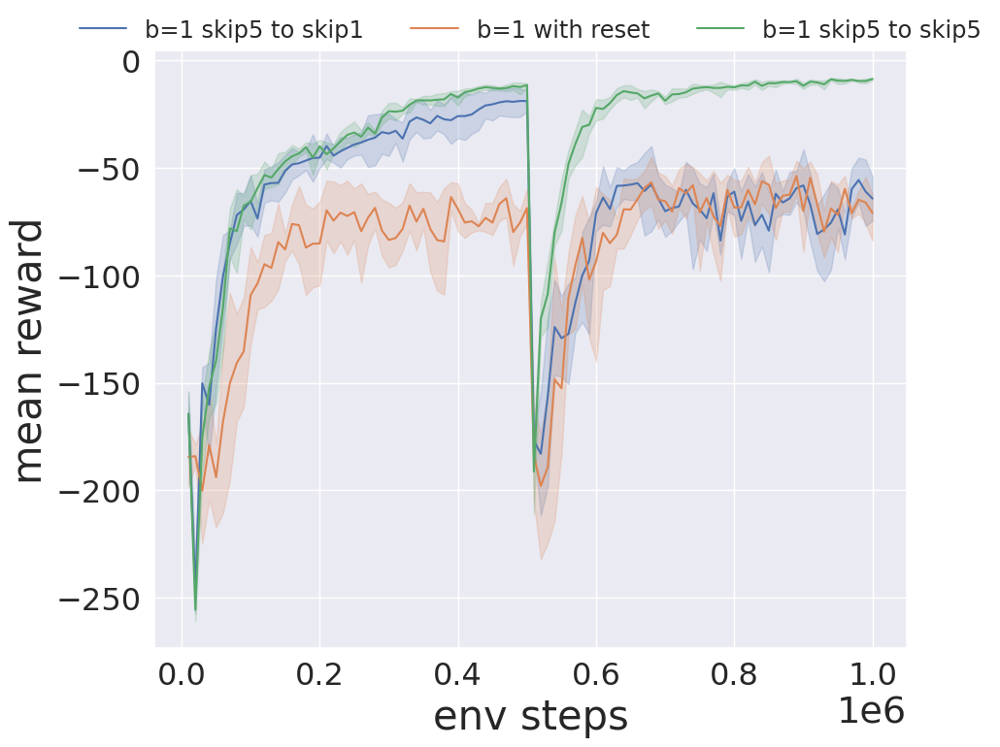

In [61]:
# skip 3 to skip 1
data_plot = pd.concat([
df_two_stage_b_1_skip5_skip1,
df_b_1_with_reset,
df_two_stage_b_1_skip5_skip5
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip5_skip1,
df_b_1_with_reset,
df_two_stage_b_1_skip5_skip5

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

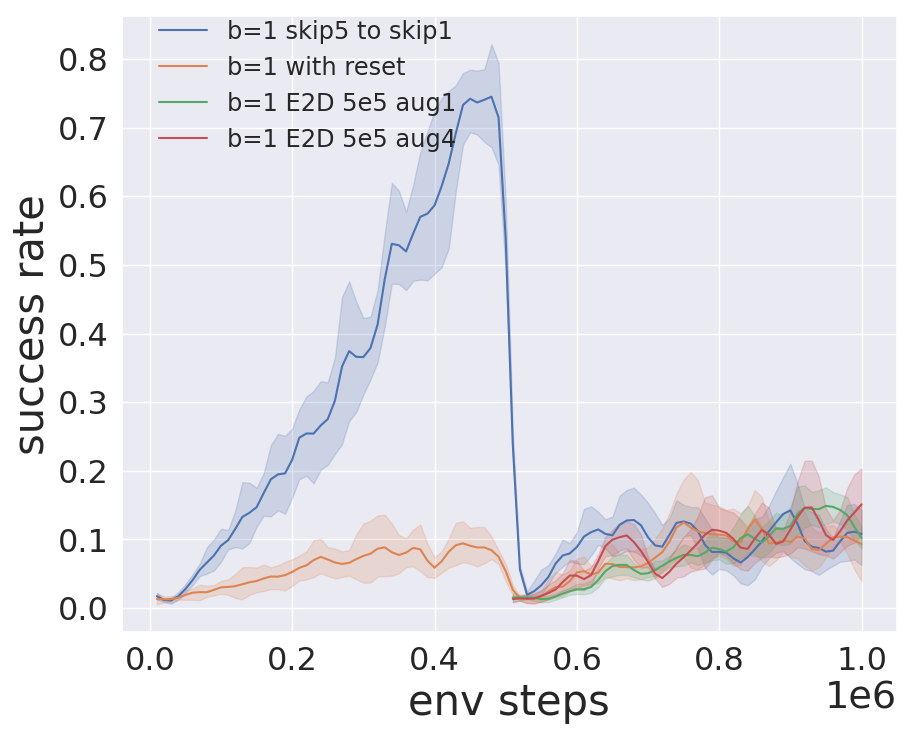

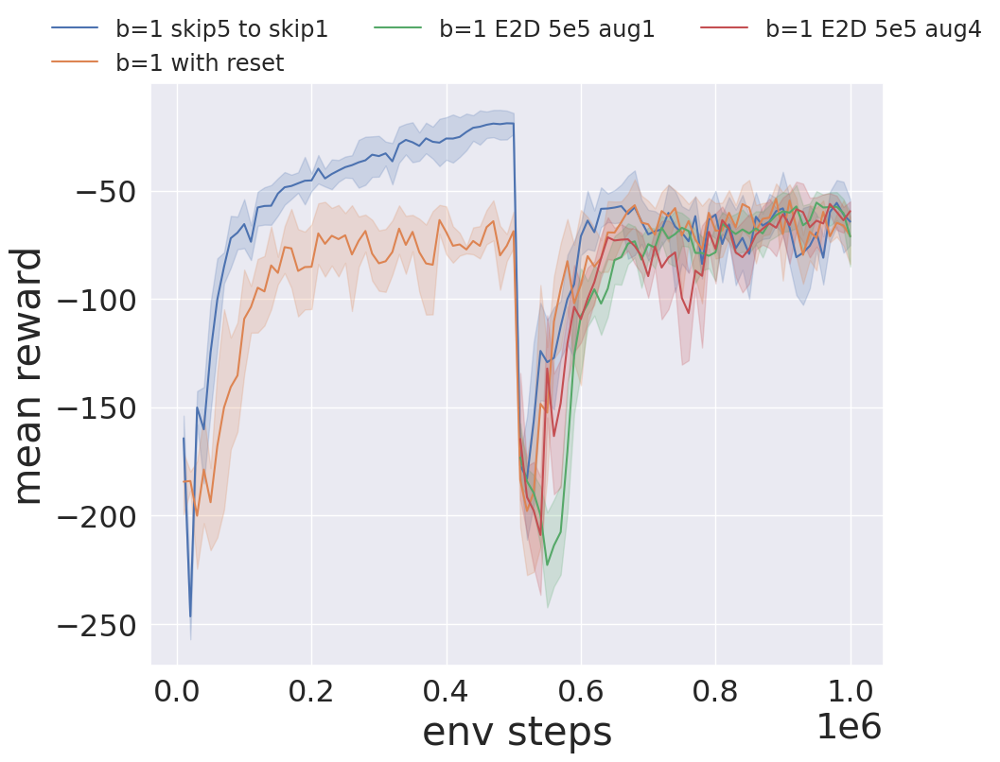

In [62]:
# skip 3 to skip 1
data_plot = pd.concat([
df_two_stage_b_1_skip5_skip1,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug1,
df_E2D_b_1_medium_5e5_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip5_skip1,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug1,
df_E2D_b_1_medium_5e5_aug4

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

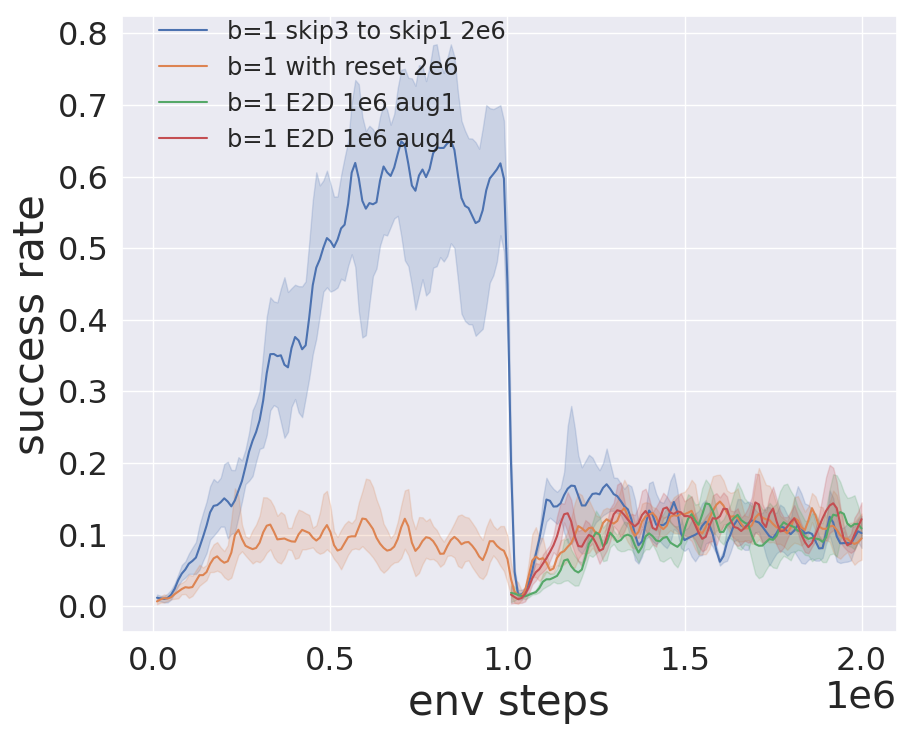

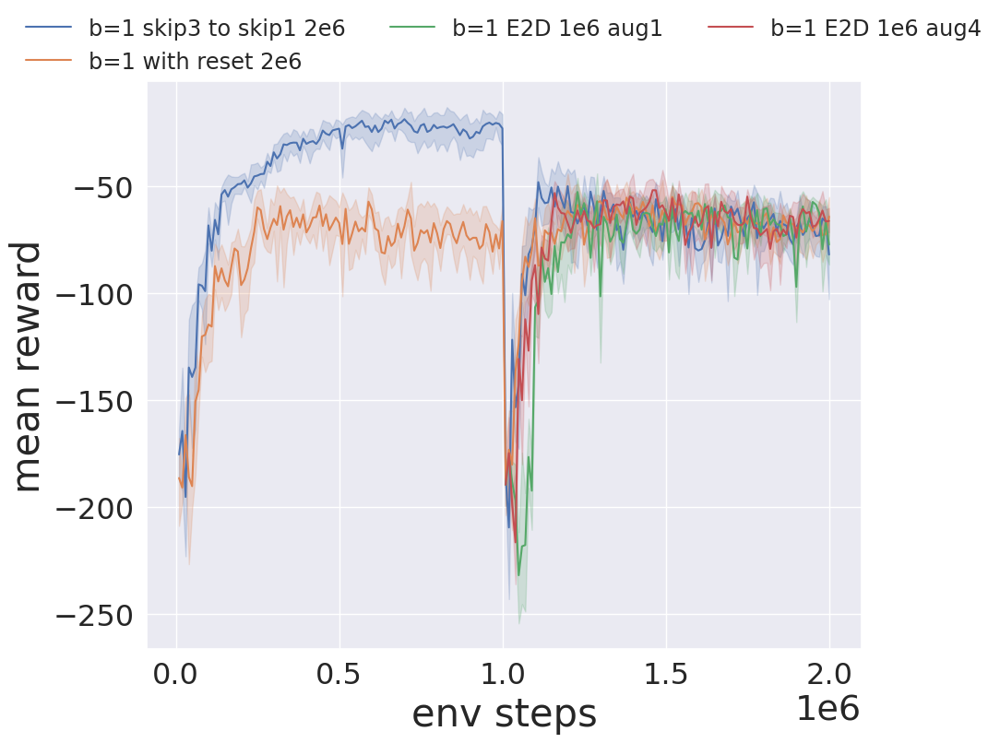

In [63]:
# skip 3 to skip 1
data_plot = pd.concat([
df_two_stage_b_1_skip3_skip1_2e6,
df_b_1_with_reset_2e6,
df_E2D_b_1_medium_1e6_aug1,
df_E2D_b_1_medium_1e6_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip3_skip1_2e6,
df_b_1_with_reset_2e6,
df_E2D_b_1_medium_1e6_aug1,
df_E2D_b_1_medium_1e6_aug4

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## goal space

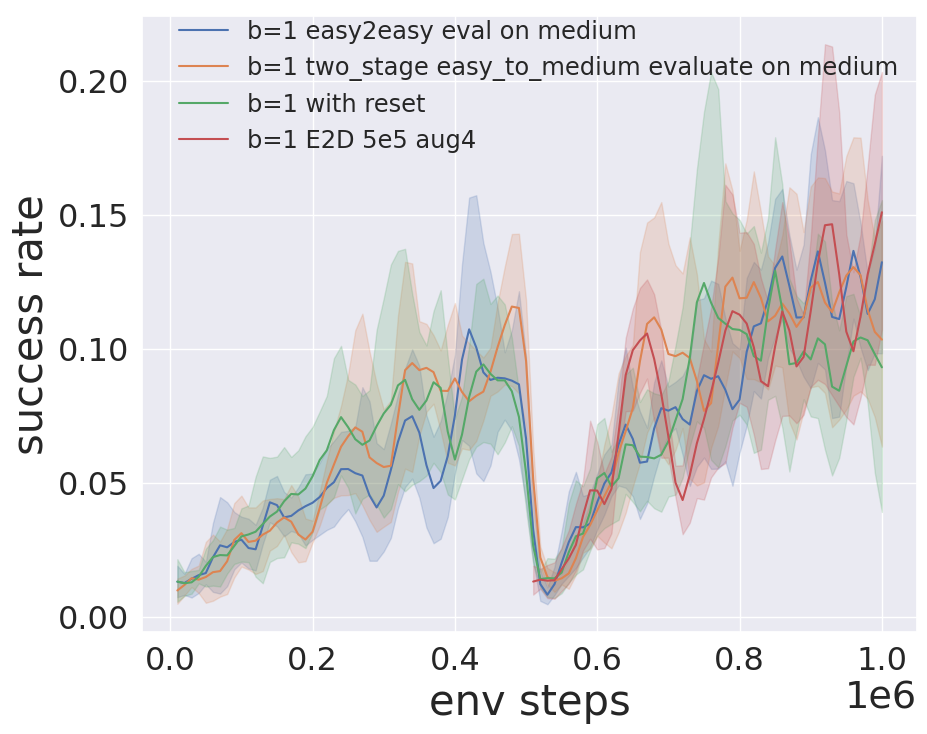

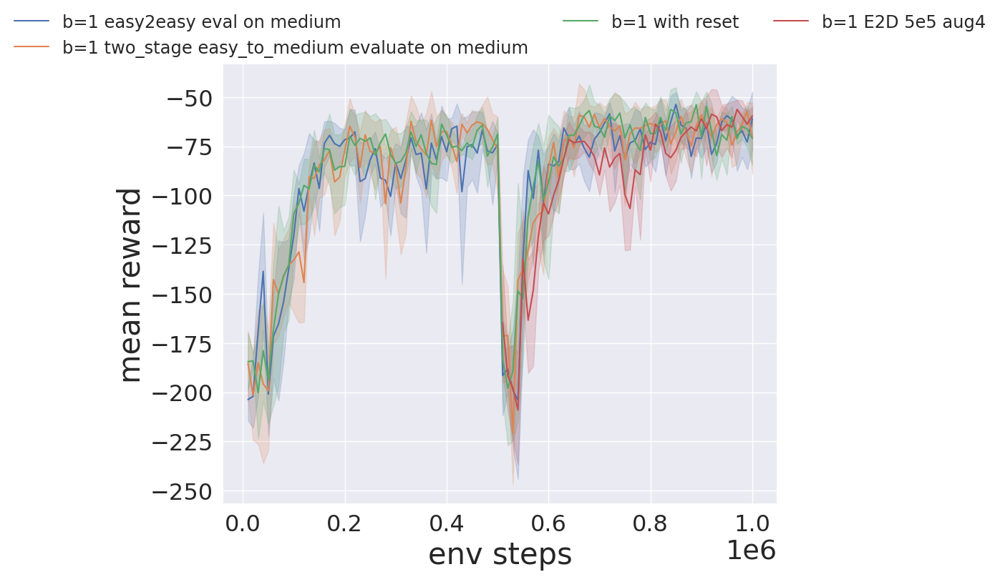

In [64]:
# skip 3 to skip 1
data_plot = pd.concat([
df_b_1_easy2easy_eval_on_medium,
df_b_1_two_stage_easy_to_medium_evaluate_on_medium,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_easy2easy_eval_on_medium,
df_b_1_two_stage_easy_to_medium_evaluate_on_medium,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

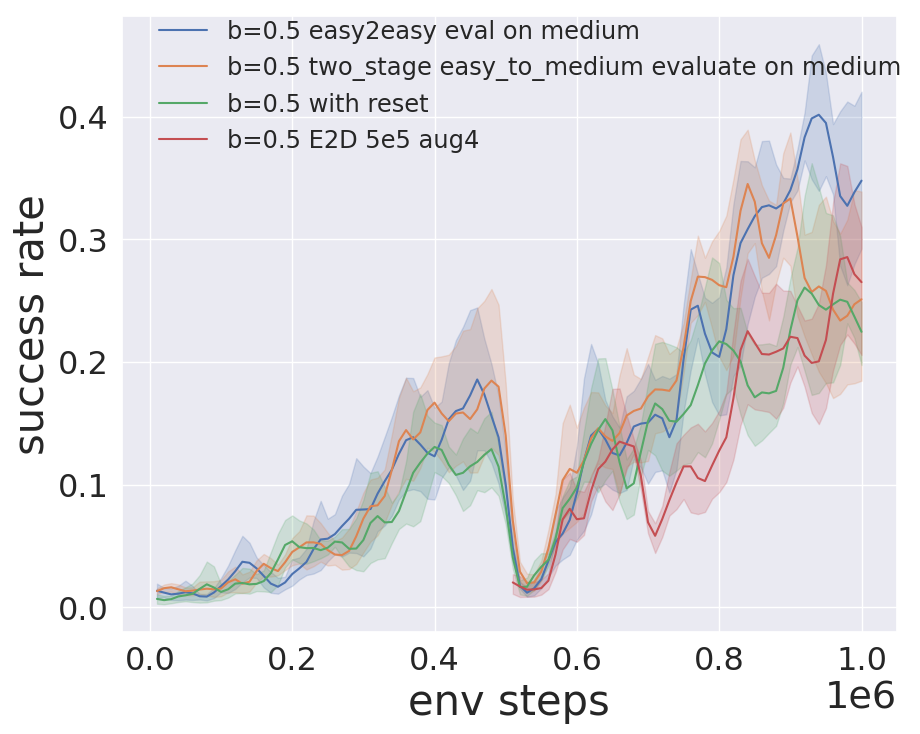

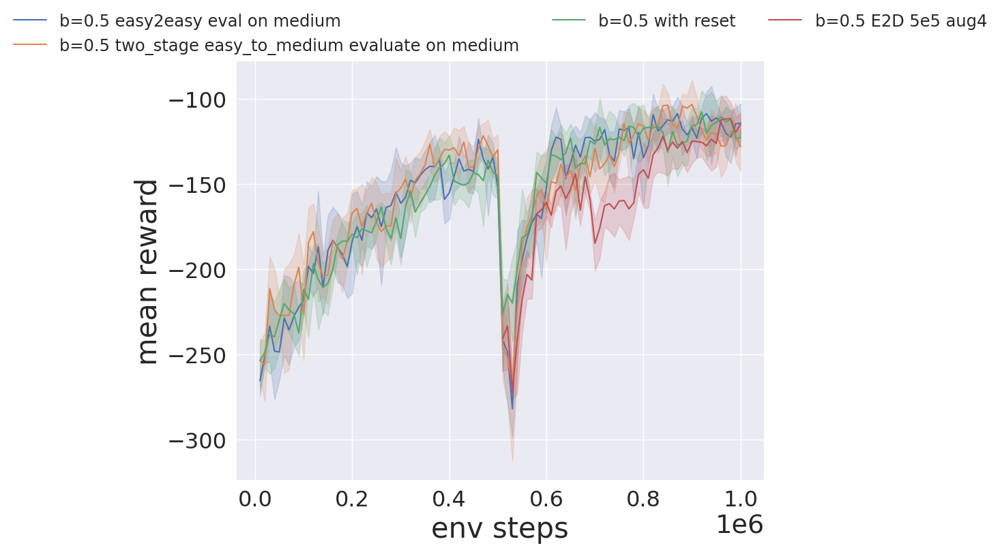

In [65]:
# skip 3 to skip 1
data_plot = pd.concat([
df_b_05_easy2easy_eval_on_medium,
df_b_05_two_stage_easy_to_medium_evaluate_on_medium,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug4

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_easy2easy_eval_on_medium,
df_b_05_two_stage_easy_to_medium_evaluate_on_medium,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

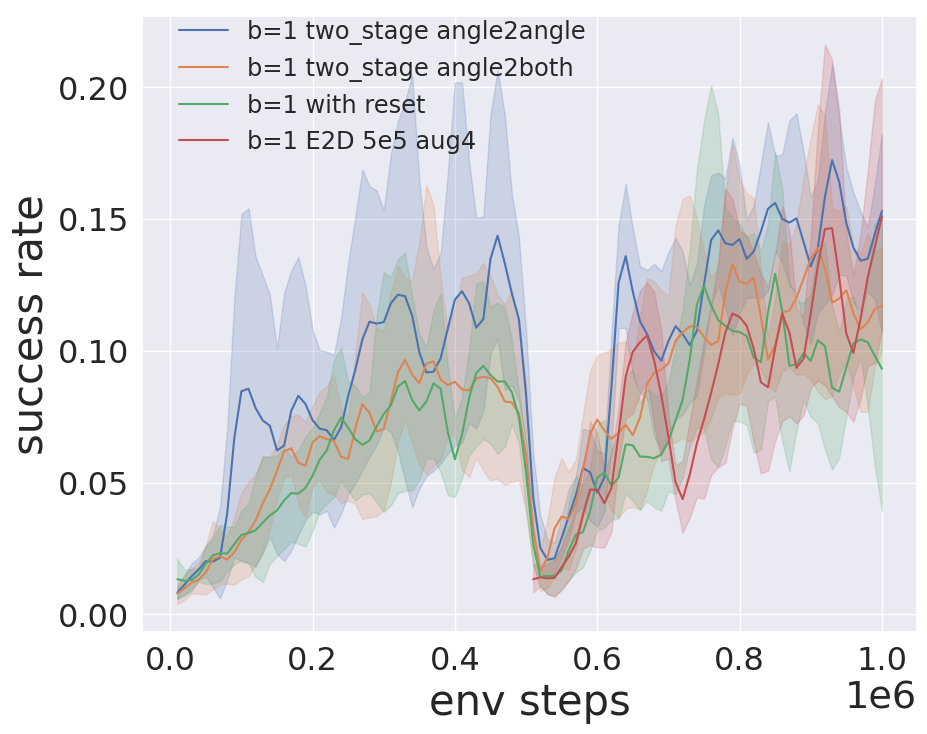

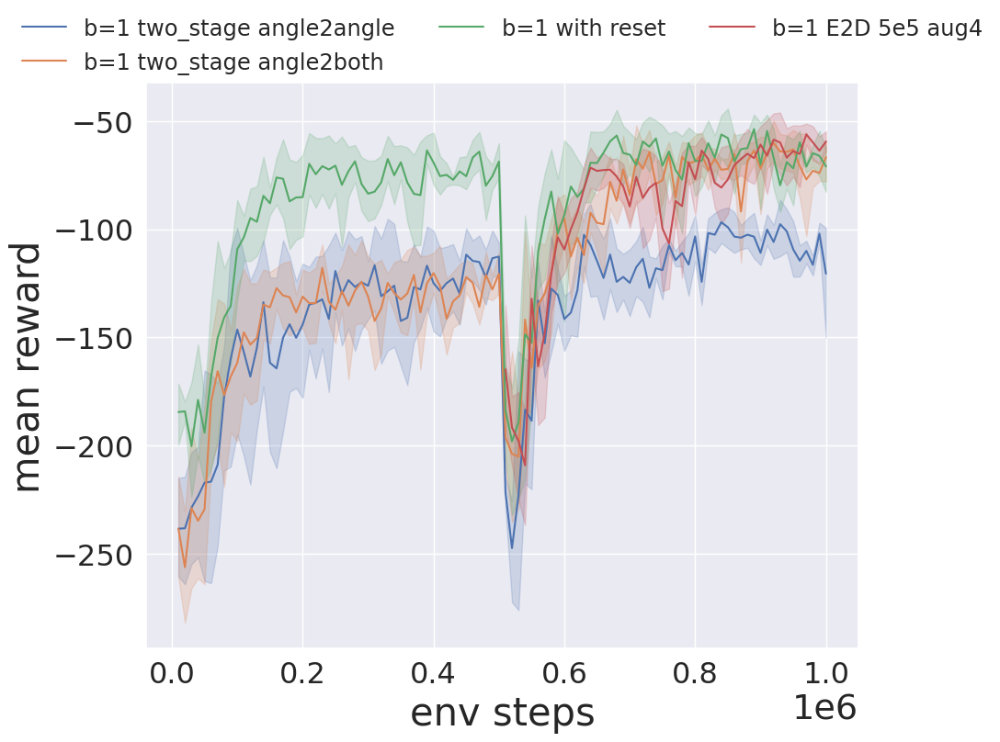

In [66]:
data_plot = pd.concat([
df_b_1_two_stage_angle_to_angle,
df_b_1_two_stage_angle_to_both,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_angle_to_angle,
df_b_1_two_stage_angle_to_both,
df_b_1_with_reset,
df_E2D_b_1_medium_5e5_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

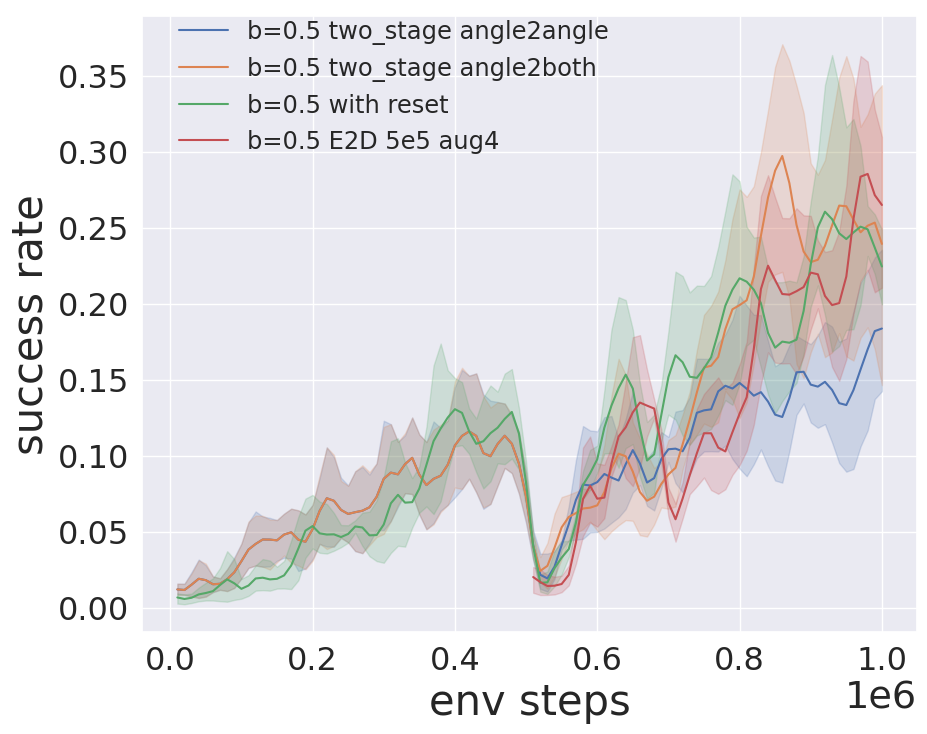

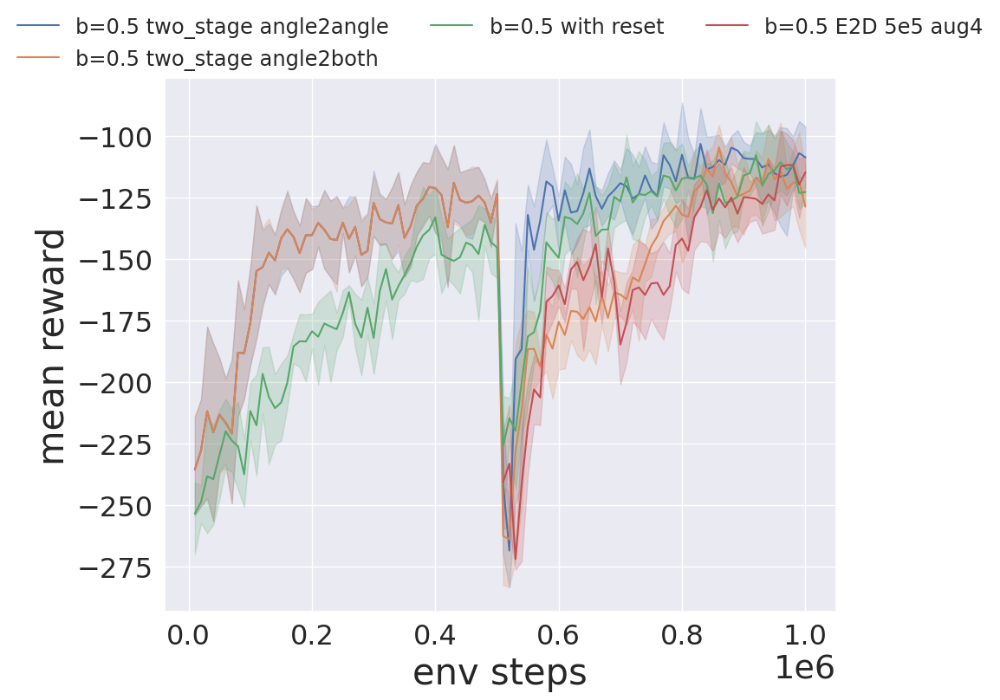

In [67]:
data_plot = pd.concat([
df_b_05_two_stage_angle_to_angle,
df_b_05_two_stage_angle_to_both,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug4
    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_two_stage_angle_to_angle,
df_b_05_two_stage_angle_to_both,
df_b_05_with_reset,
df_E2D_b_05_medium_5e5_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

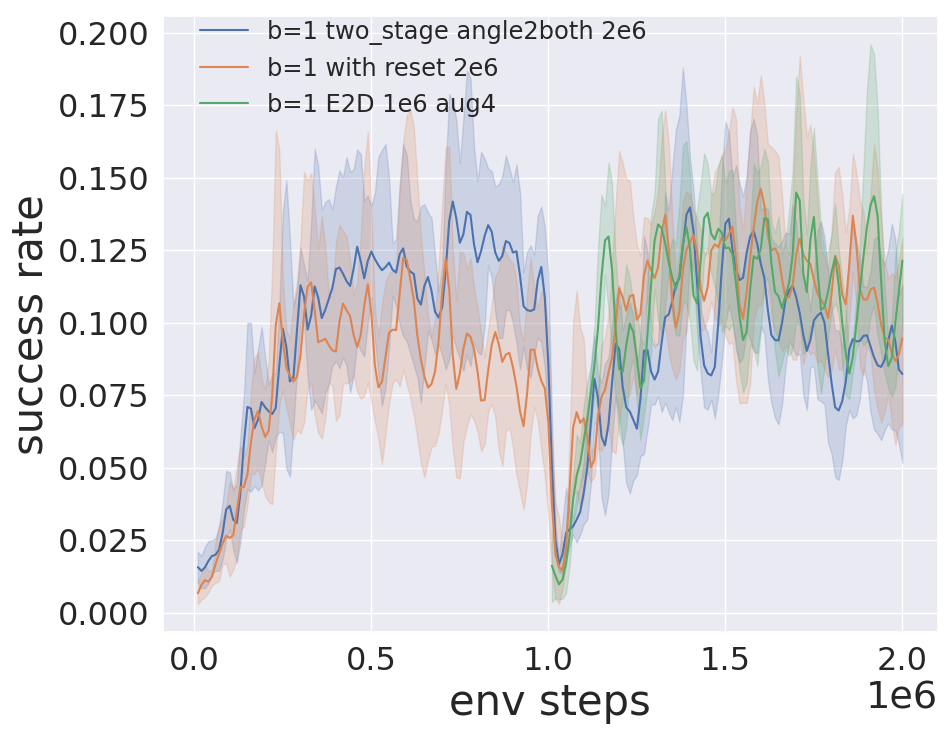

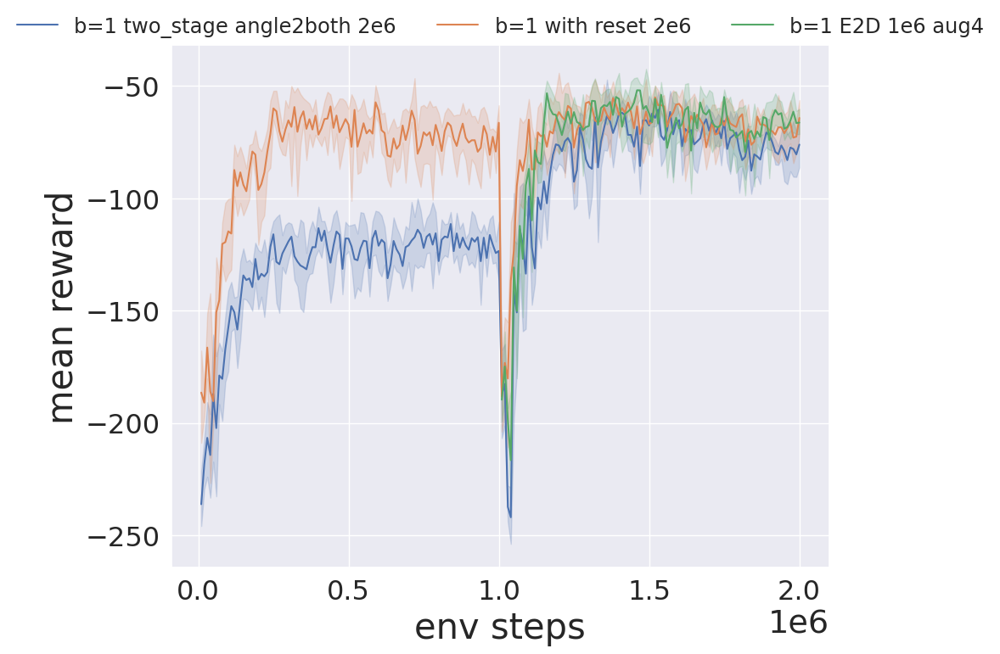

In [68]:
data_plot = pd.concat([
df_b_1_two_stage_angle_to_both_2e6,
df_b_1_with_reset_2e6,
df_E2D_b_1_medium_1e6_aug4

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_two_stage_angle_to_both_2e6,
df_b_1_with_reset_2e6,
df_E2D_b_1_medium_1e6_aug4
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

# skip 3 to skip 1 buffer size = 5e5

1000


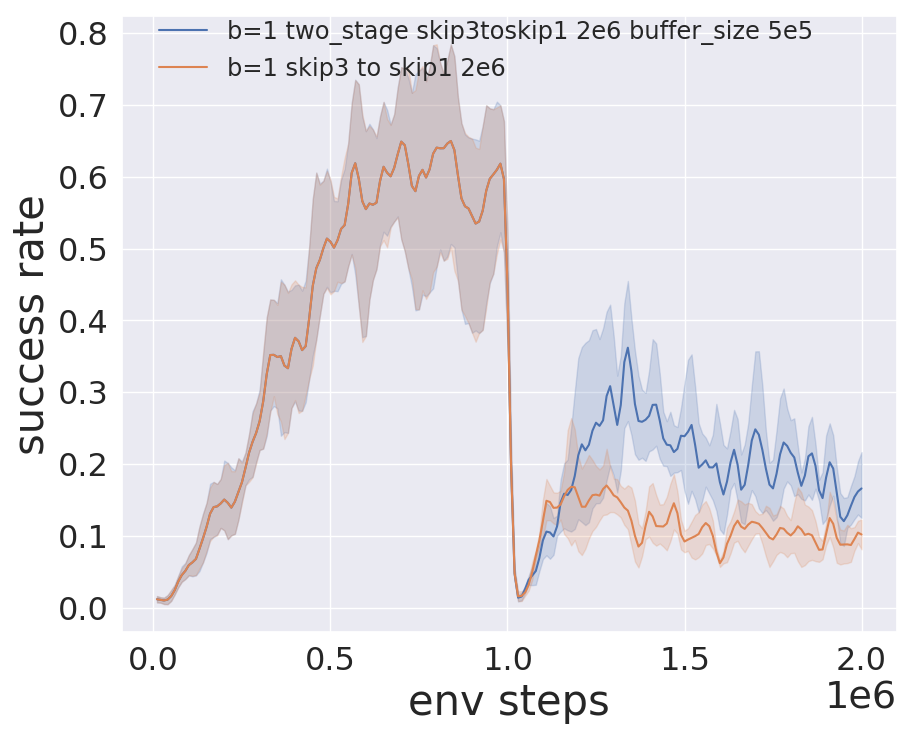

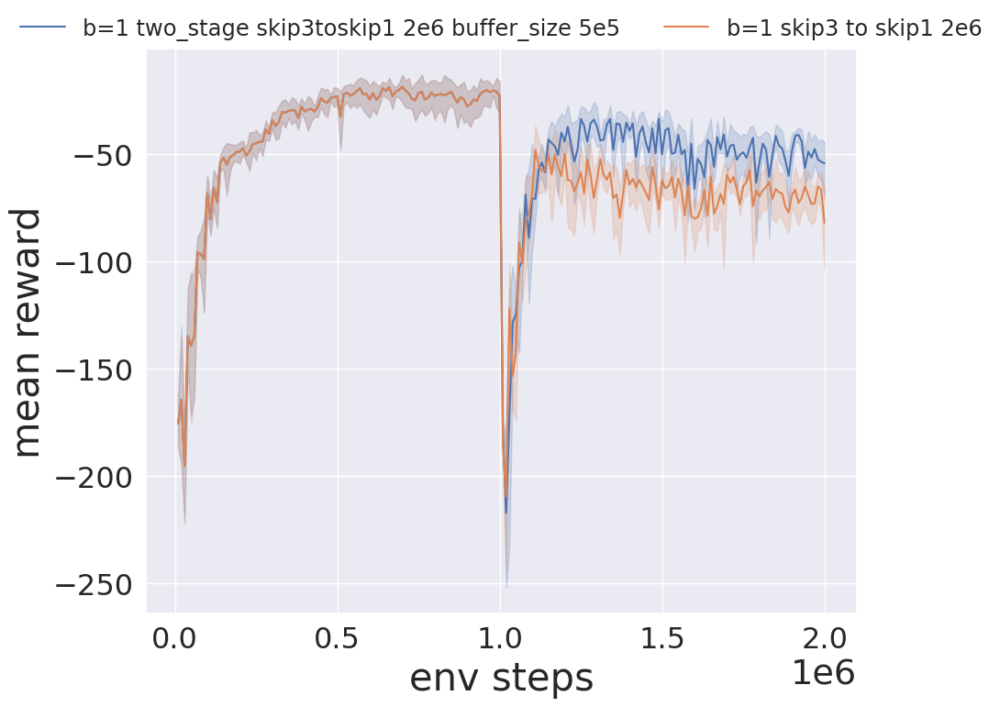

In [69]:
first_files = [
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_1_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_2_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_3_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_4_singleRL",
   "D2D/F2F/medium/b_1/skip_3/sac_128_128_b_1_1e6steps_skip_3_seed_5_singleRL",

]
second_files = [
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_1_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_2_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_3_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_4_singleRL", 
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_5e5/sac_128_128_b_1_1e6steps_skip_3_to_skip_1_seed_5_singleRL", 

 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_skip3_skip1_2e6_buffersize5e5 = pd.concat([load_two_stage_data("b=1 two_stage skip3toskip1 2e6 buffer_size 5e5", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_skip3_skip1_2e6_buffersize5e5))


data_plot = pd.concat([
df_two_stage_b_1_skip3_skip1_2e6_buffersize5e5,
df_two_stage_b_1_skip3_skip1_2e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_skip3_skip1_2e6_buffersize5e5,
df_two_stage_b_1_skip3_skip1_2e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## easy2medium 2e6 

1000
1000


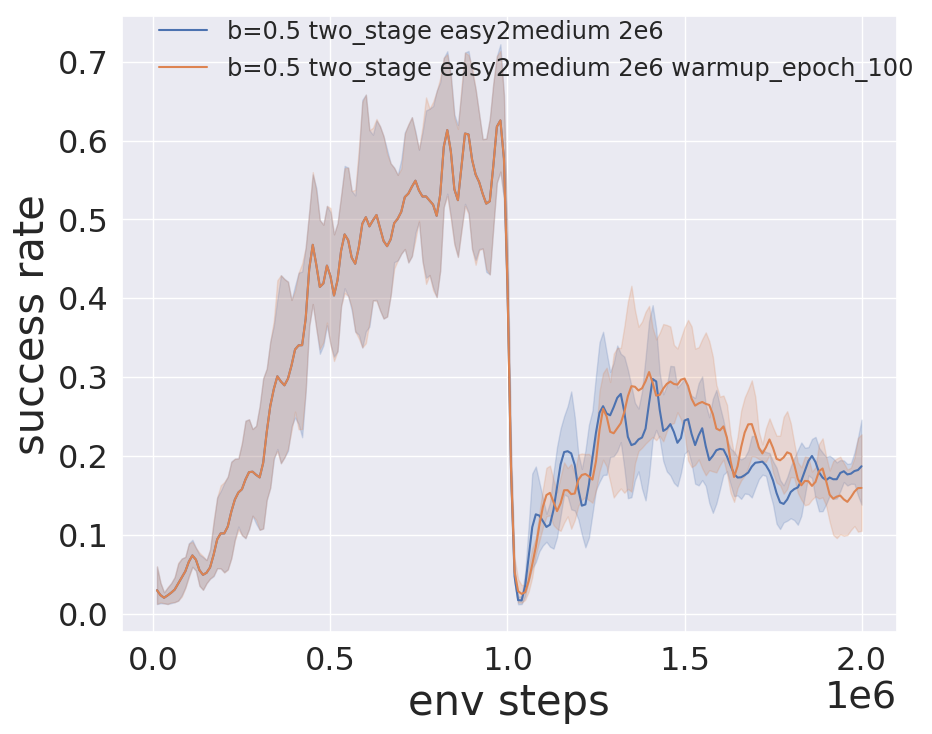

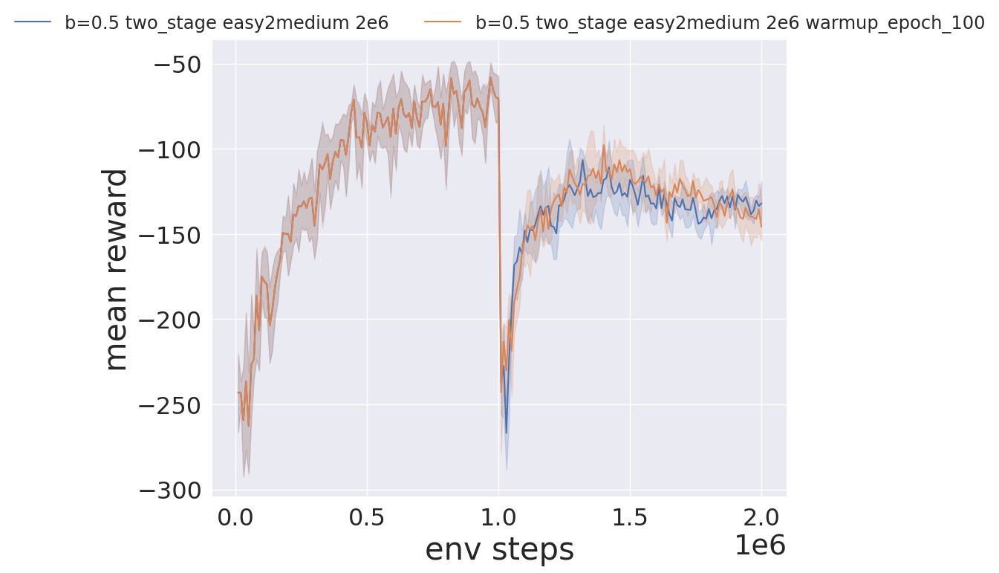

In [70]:
first_files = [
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",

]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_2_singleRL",
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_5_singleRL", 
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_2e6_easy2medium = pd.concat([load_two_stage_data("b=0.5 two_stage easy2medium 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_2e6_easy2medium))


first_files = [
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_05/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",

]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/warmup_epochs_100/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/warmup_epochs_100/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/warmup_epochs_100/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/warmup_epochs_100/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/warmup_epochs_100/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_5_singleRL", 
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_2e6_easy2medium_warmup_epoch_100 = pd.concat([load_two_stage_data("b=0.5 two_stage easy2medium 2e6 warmup_epoch_100", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_2e6_easy2medium_warmup_epoch_100))


data_plot = pd.concat([
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_warmup_epoch_100

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_warmup_epoch_100
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


1000
1000


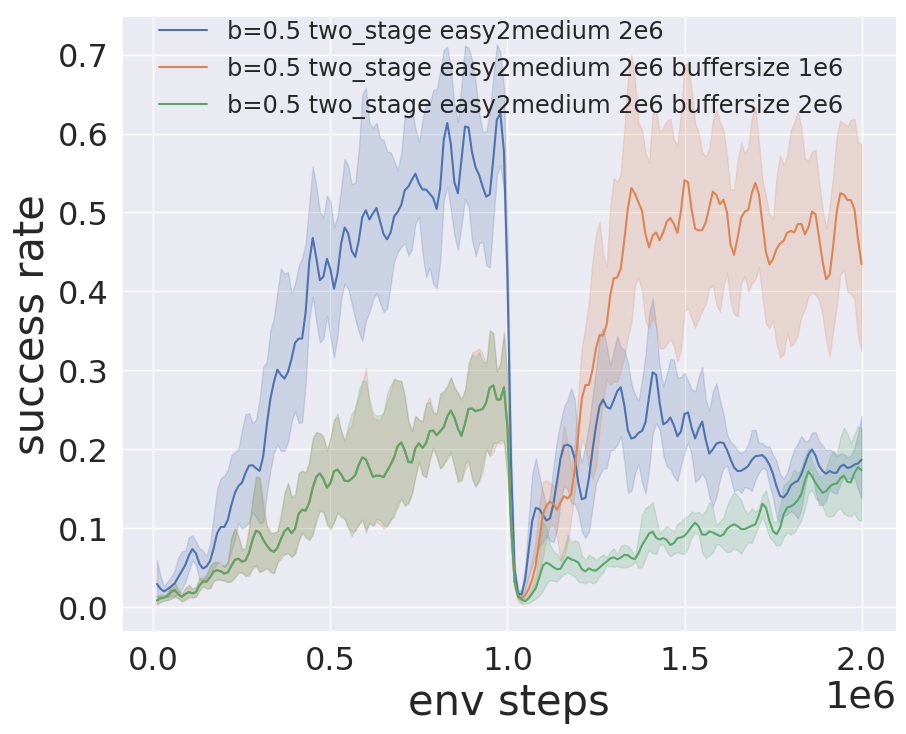

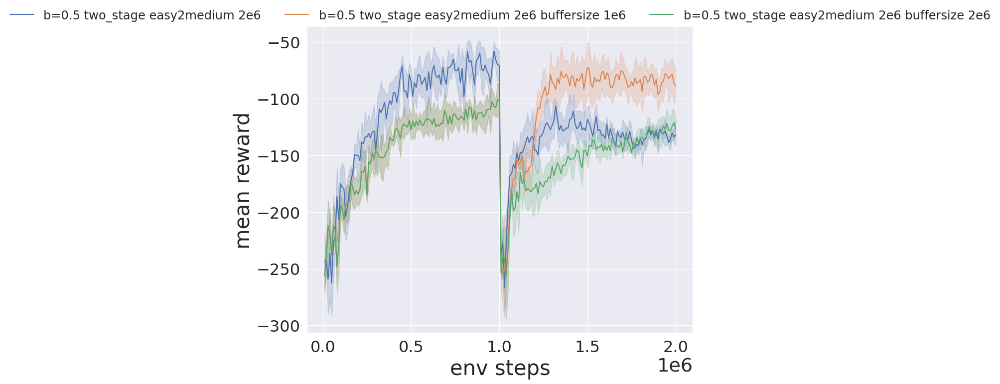

In [71]:
first_files = [
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",



]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_5_singleRL", 
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_2e6_easy2medium_buffersize1e6 = pd.concat([load_two_stage_data("b=0.5 two_stage easy2medium 2e6 buffersize 1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_2e6_easy2medium_buffersize1e6))


first_files = [
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",



]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_2e6/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_2e6_easy2medium_buffersize2e6 = pd.concat([load_two_stage_data("b=0.5 two_stage easy2medium 2e6 buffersize 2e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_2e6_easy2medium_buffersize2e6))






data_plot = pd.concat([
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_buffersize1e6,
df_two_stage_b_05_2e6_easy2medium_buffersize2e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_buffersize1e6,
df_two_stage_b_05_2e6_easy2medium_buffersize2e6
])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


# buffer size = 1e6  train 1e6

## easy 2 medium b = 1 buffersize=1e6

1000
1000
1000


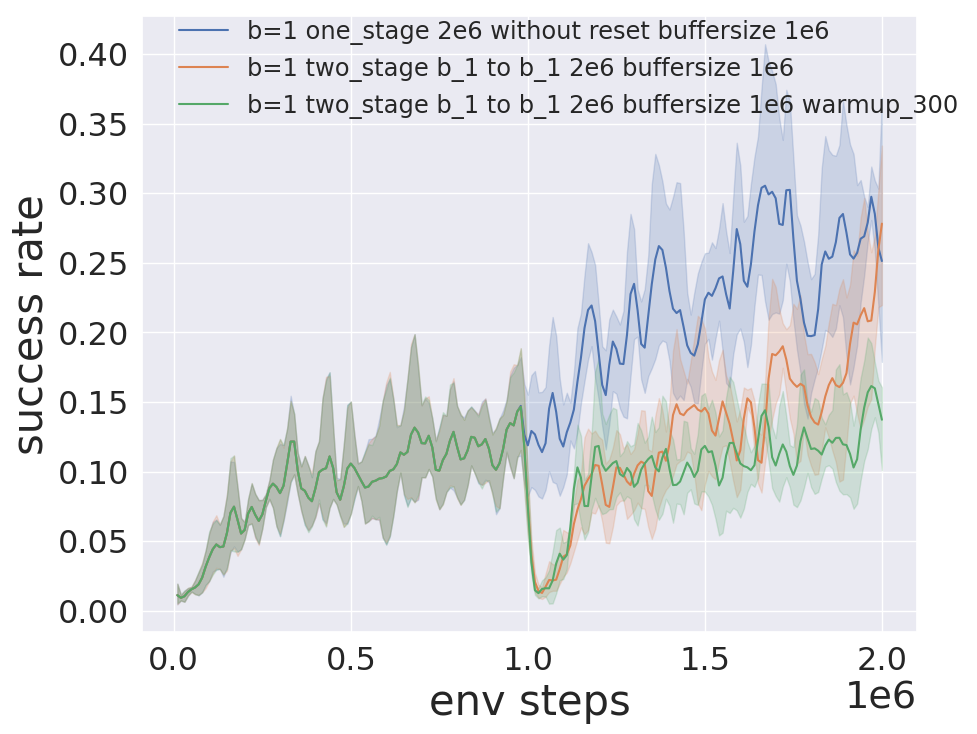

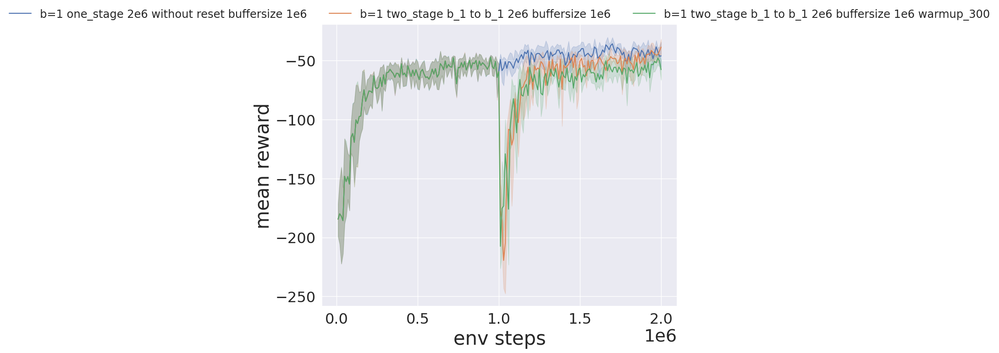

In [72]:
#  b=  1  medium2medium without reset buffer size = 1e6 

first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",


]
second_files = [
    "D2D/VVC/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_2e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_2e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_2e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_2e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_2e6steps_seed_5_singleRL", 
]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_one_stage_b_1_2e6_without_reset_buffersize2e6 = pd.concat([load_two_stage_data("b=1 one_stage 2e6 without reset buffersize 1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_one_stage_b_1_2e6_without_reset_buffersize2e6))




first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",




]
second_files = [
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_to_b_1_2e6_buffersize1e6 = pd.concat([load_two_stage_data("b=1 two_stage b_1 to b_1 2e6 buffersize 1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_to_b_1_2e6_buffersize1e6))



# warmup 300

first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",




]
second_files = [
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_to_b_1_2e6_buffersize1e6_warmup_300 = pd.concat([load_two_stage_data("b=1 two_stage b_1 to b_1 2e6 buffersize 1e6 warmup_300", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_to_b_1_2e6_buffersize1e6_warmup_300))




data_plot = pd.concat([
df_one_stage_b_1_2e6_without_reset_buffersize2e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6_warmup_300

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_one_stage_b_1_2e6_without_reset_buffersize2e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6_warmup_300

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")



## frame skip3 to 1 


492


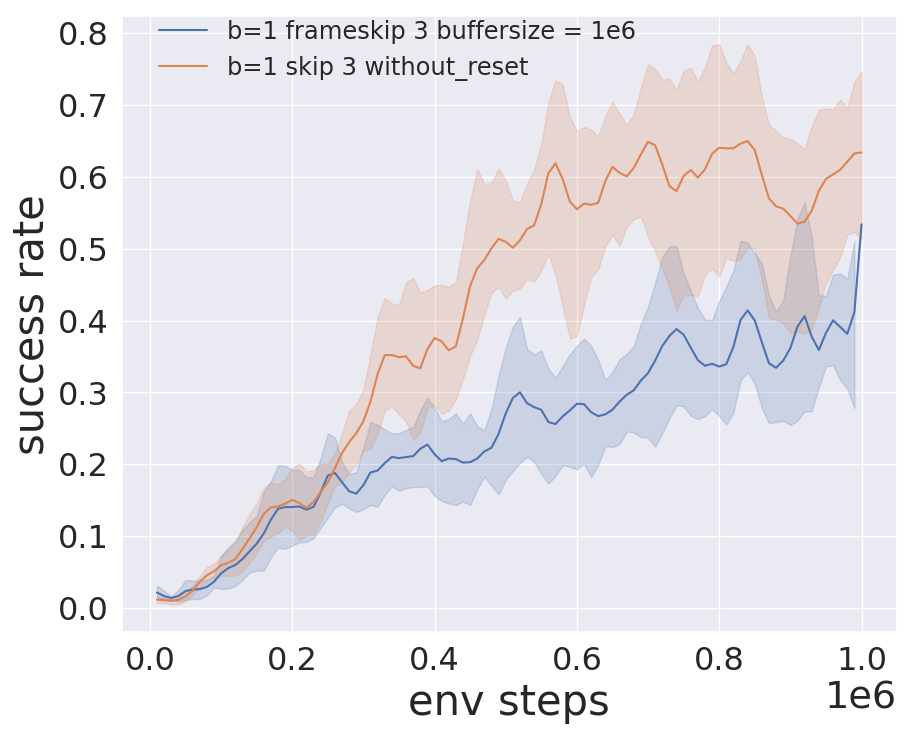

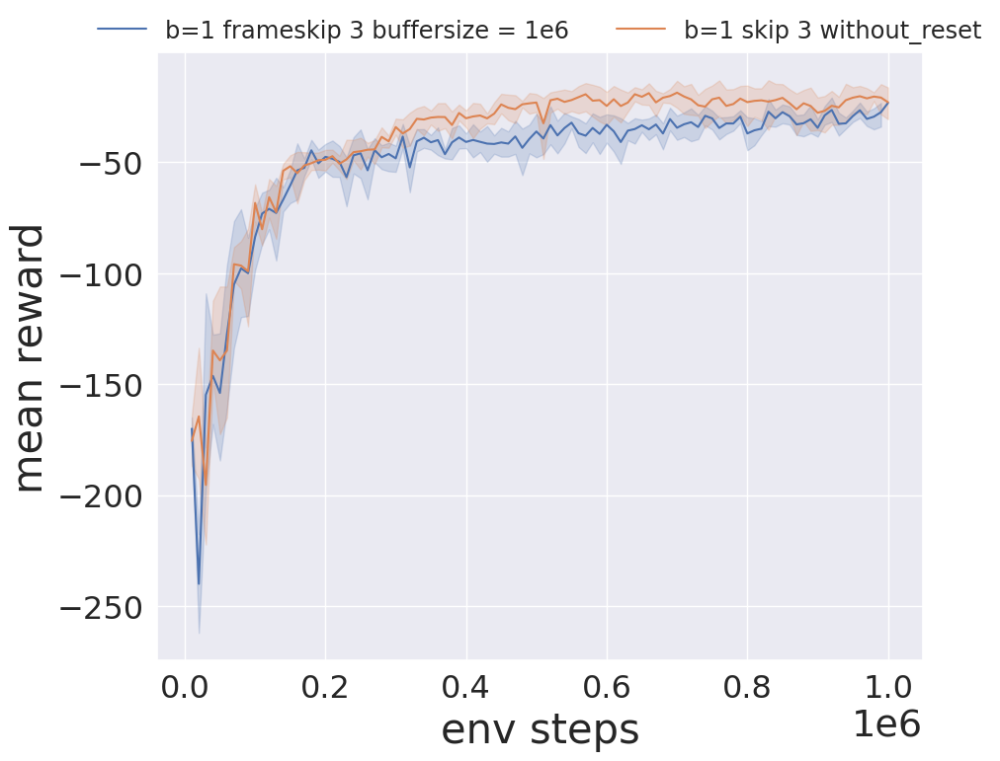

In [73]:
files = [
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_1e6/sac_128_128_b_1_1e6steps_skip_3_seed_1_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_1e6/sac_128_128_b_1_1e6steps_skip_3_seed_2_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_1e6/sac_128_128_b_1_1e6steps_skip_3_seed_3_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_1e6/sac_128_128_b_1_1e6steps_skip_3_seed_4_singleRL",
    "D2D/F2F/medium/b_1/skip_3_2_skip_1/2e6/buffer_size_1e6/sac_128_128_b_1_1e6steps_skip_3_seed_5_singleRL", 

]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_skip_3_buffersize1e6 = pd.concat([load_data("b=1 frameskip 3 buffersize = 1e6", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_skip_3_buffersize1e6))



data_plot = pd.concat([
df_b_1_skip_3_buffersize1e6,
df_b_1_skip_3_without_reset


    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_skip_3_buffersize1e6,evaluate_medium
df_b_1_skip_3_without_reset

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

##  gamma 0.95 to 0.995

1000


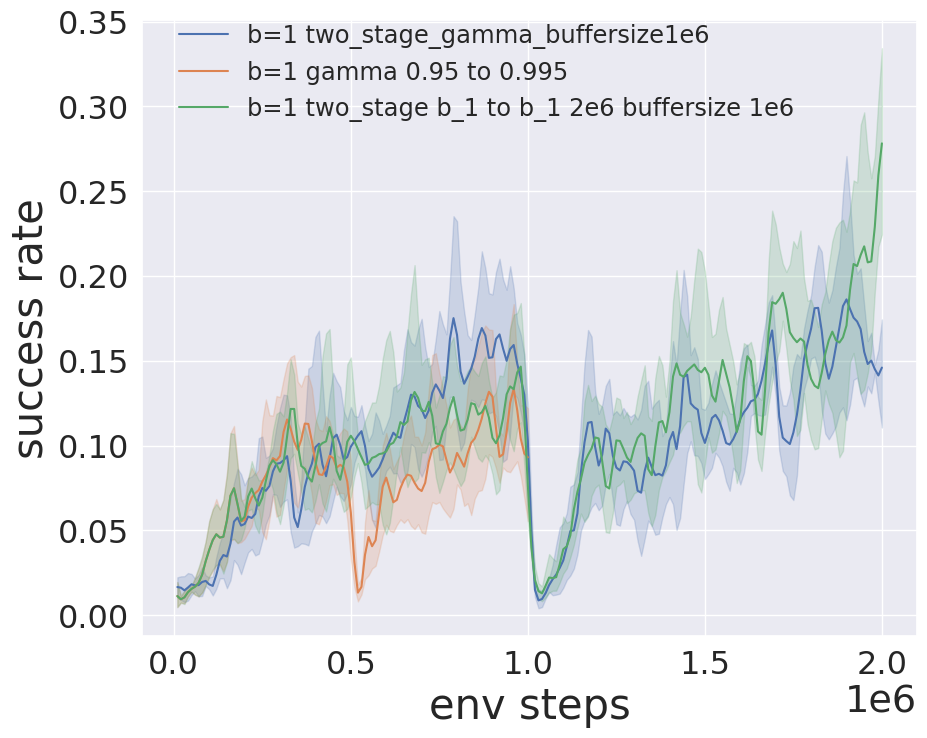

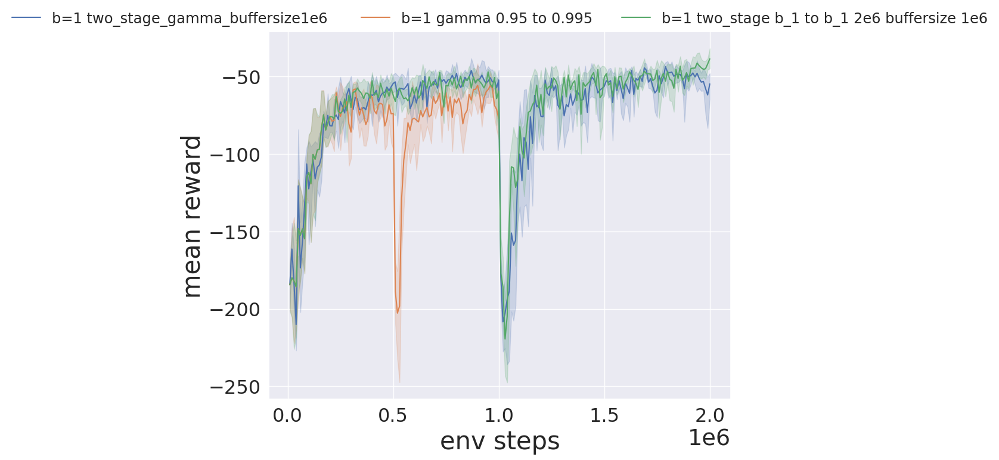

In [76]:
first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",




]
second_files = [
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/gamma095to0995/2e6/buffer_szie1e6/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_gamma_buffersize1e6 = pd.concat([load_two_stage_data("b=1 two_stage_gamma_buffersize1e6 ", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_gamma_buffersize1e6))



data_plot = pd.concat([
df_two_stage_gamma_buffersize1e6,
df_two_stage_b_1_gamma095to0995,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_gamma_buffersize1e6,
df_two_stage_b_1_gamma095to0995,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## easy 2 medium

1000


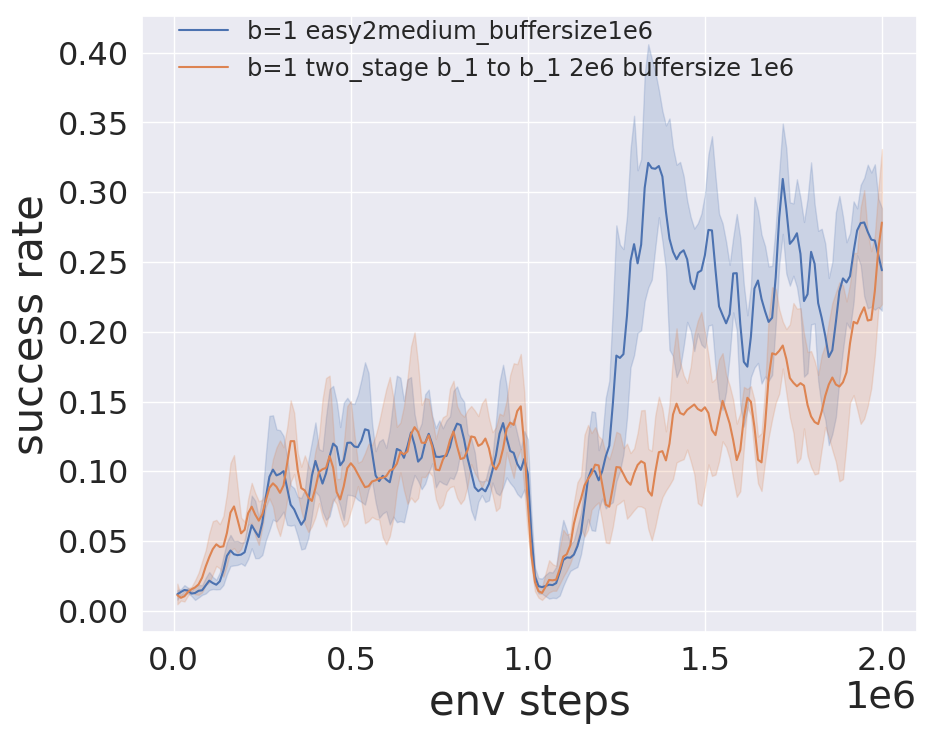

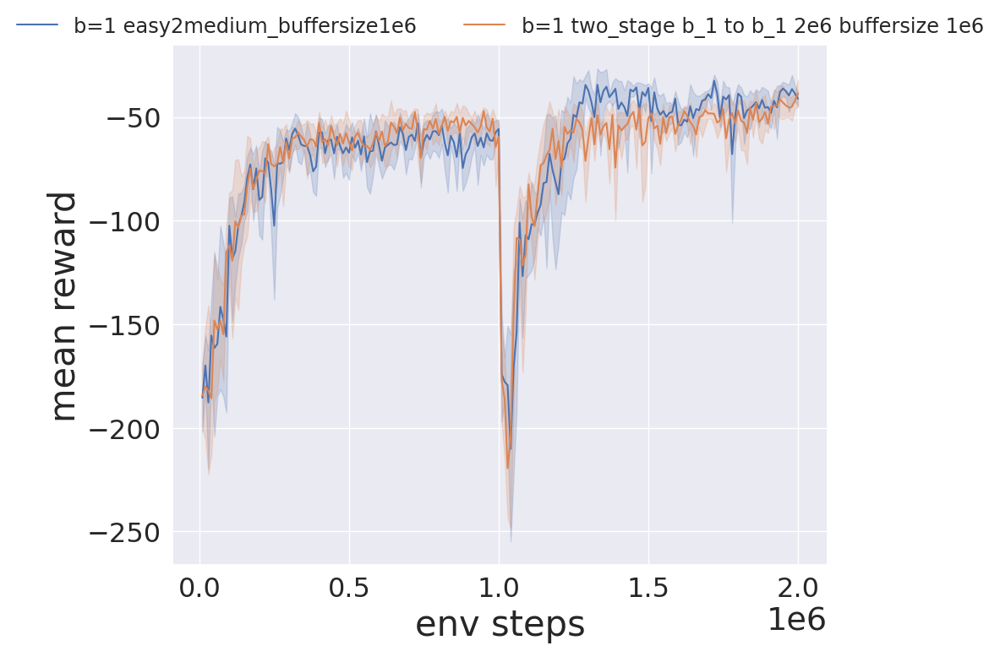

In [77]:
first_files = [
   "D2D/VVC/easy_sac/b_1/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_1/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_1/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_1/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_1/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",



]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_1_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_1_easy_to_medium_1e6steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_1_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_1_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_1/2e6/easy2medium_buffer_size_1e6/sac_10hz_128_128_b_1_easy_to_medium_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_easy2medium_buffersize1e6 = pd.concat([load_two_stage_data("b=1 easy2medium_buffersize1e6 ", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_easy2medium_buffersize1e6))


data_plot = pd.concat([
df_b_1_easy2medium_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_easy2medium_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

## reward devide

995


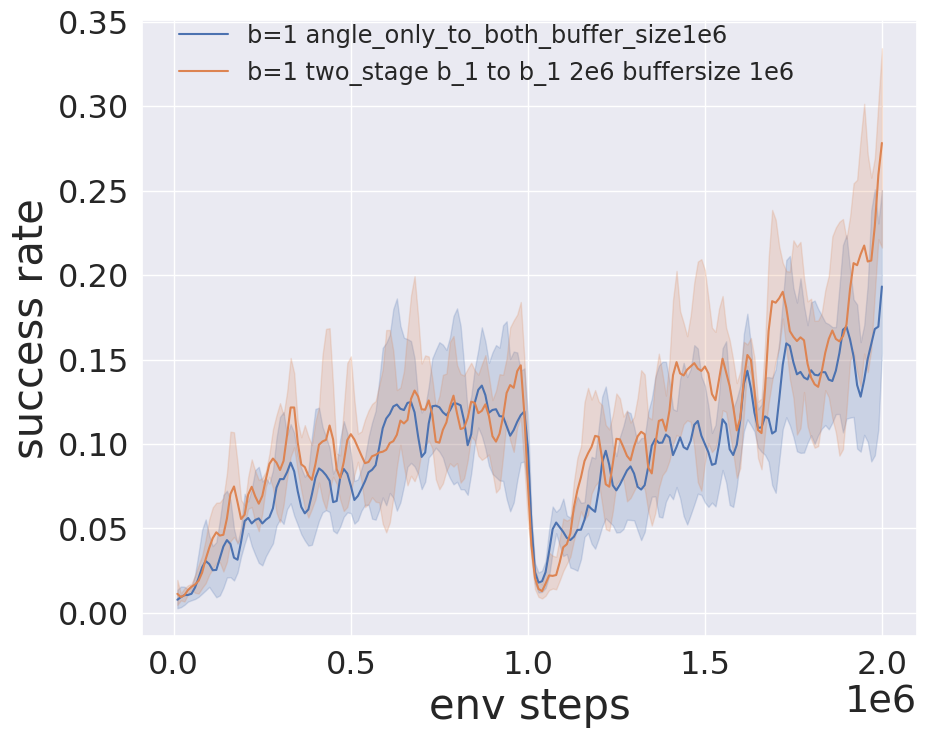

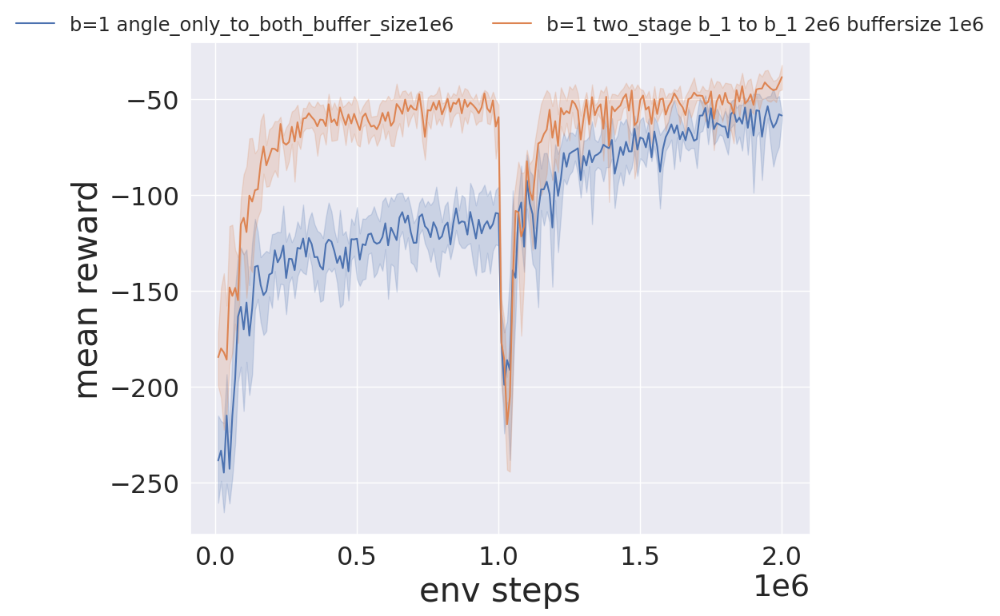

In [78]:
first_files = [
   "D2D/reward_devide/medium/b_1_only/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_1_singleRL",
   "D2D/reward_devide/medium/b_1_only/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_2_singleRL",
   "D2D/reward_devide/medium/b_1_only/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_3_singleRL",
   "D2D/reward_devide/medium/b_1_only/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_4_singleRL",
   "D2D/reward_devide/medium/b_1_only/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_medium_1e6steps_seed_5_singleRL",



]
second_files = [
    "D2D/reward_devide/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_1_singleRL", 
    "D2D/reward_devide/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_2_singleRL",
    "D2D/reward_devide/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_3_singleRL",
    "D2D/reward_devide/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_4_singleRL",
    "D2D/reward_devide/medium/b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_angle_only_to_both_reward_medium_1e6steps_seed_5_singleRL",
     

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_angle_only_to_both_buffer_size1e6 = pd.concat([load_two_stage_data("b=1 angle_only_to_both_buffer_size1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_1_angle_only_to_both_buffer_size1e6))



data_plot = pd.concat([
df_b_1_angle_only_to_both_buffer_size1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)



df_b_1_angle_only_to_both_buffer_size1e6
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## easy 2medium b = 0.5 warmup

957


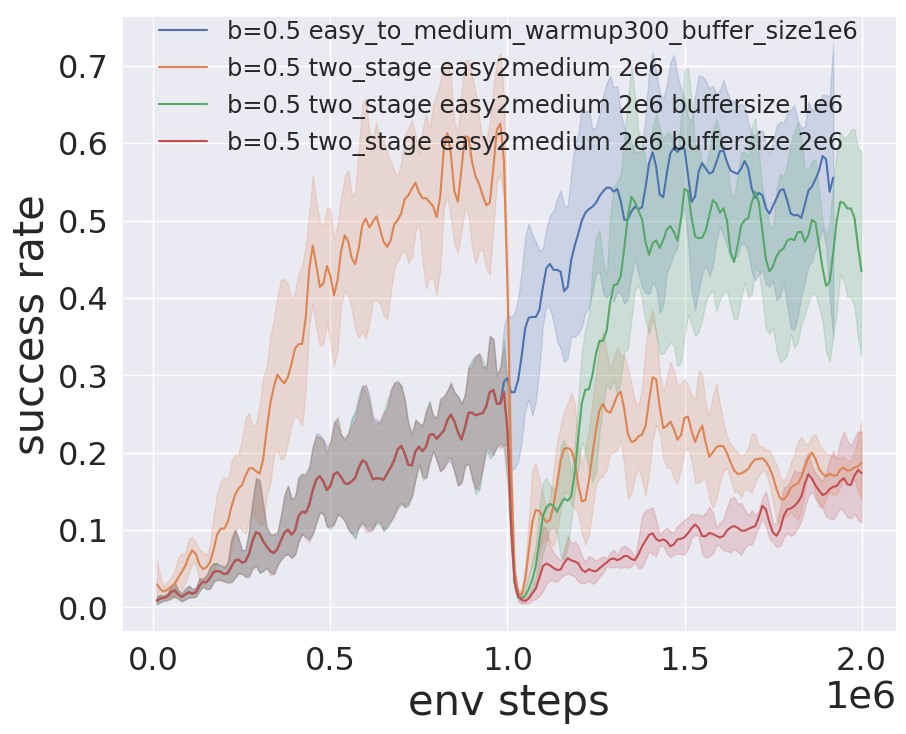

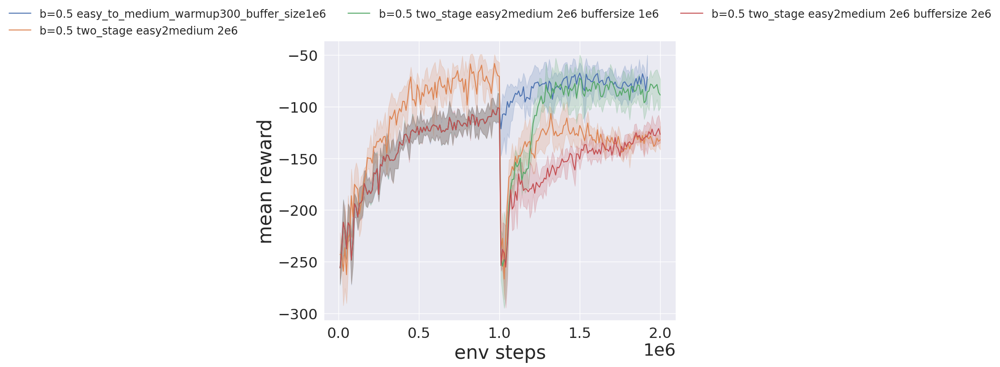

In [81]:
first_files = [
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/easy_sac/b_05/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",


 

]
second_files = [
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6_warmup_300/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_1_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6_warmup_300/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_2_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6_warmup_300/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_3_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6_warmup_300/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_4_singleRL", 
    "D2D/goal_sapce/evaluate_medium/easy_to_medium/b_05/2e6/easy2medium_buffer_size_1e6_warmup_300/sac_10hz_128_128_b_05_easy_to_medium_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_05_easy_to_medium_warmup300_buffer_size1e6 = pd.concat([load_two_stage_data("b=0.5 easy_to_medium_warmup300_buffer_size1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_b_05_easy_to_medium_warmup300_buffer_size1e6))



data_plot = pd.concat([
df_b_05_easy_to_medium_warmup300_buffer_size1e6,
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_buffersize1e6,
df_two_stage_b_05_2e6_easy2medium_buffersize2e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_05_easy_to_medium_warmup300_buffer_size1e6,
df_two_stage_b_05_2e6_easy2medium,
df_two_stage_b_05_2e6_easy2medium_buffersize1e6,
df_two_stage_b_05_2e6_easy2medium_buffersize2e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


1000


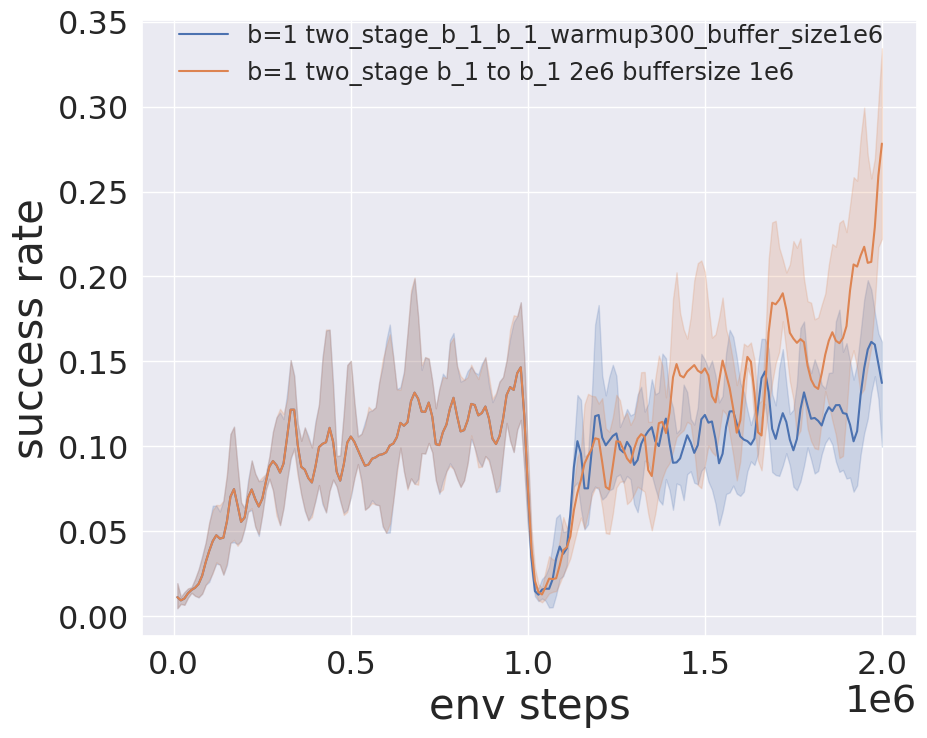

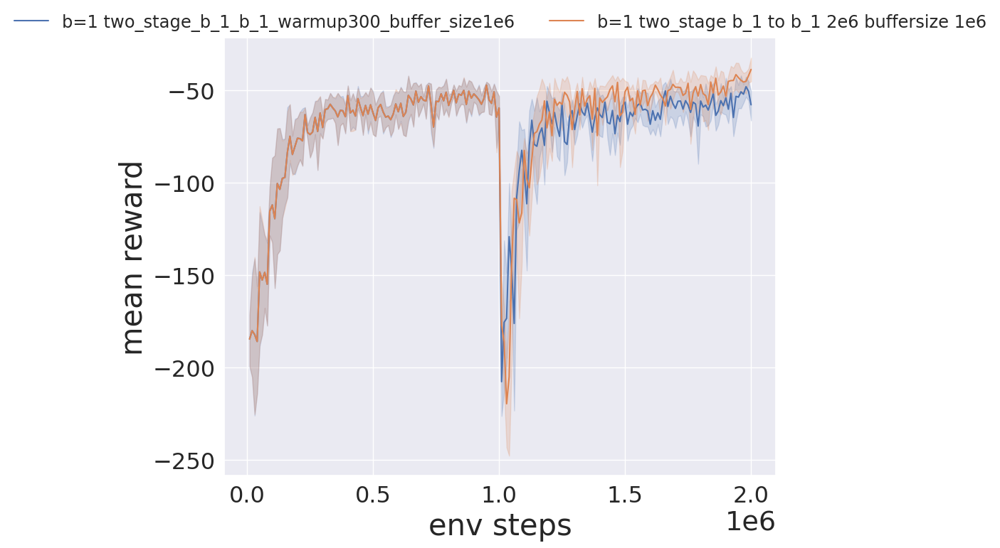

In [80]:
first_files = [
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6/sac_10hz_128_128_b_1_1e6steps_seed_5_singleRL",
    

]
second_files = [
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/baseline/two_stage_b_1_b_1/2e6/buffer_size1e6_warmup_300/sac_10hz_128_128_b_1_1e6steps_b_1_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_1_b_1_warmup300_buffer_size1e6 = pd.concat([load_two_stage_data("b=1 two_stage_b_1_b_1_warmup300_buffer_size1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_1_b_1_warmup300_buffer_size1e6))



data_plot = pd.concat([
df_two_stage_b_1_b_1_warmup300_buffer_size1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_1_b_1_warmup300_buffer_size1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")


## D2D b = 0.5 TO b = 1

1000


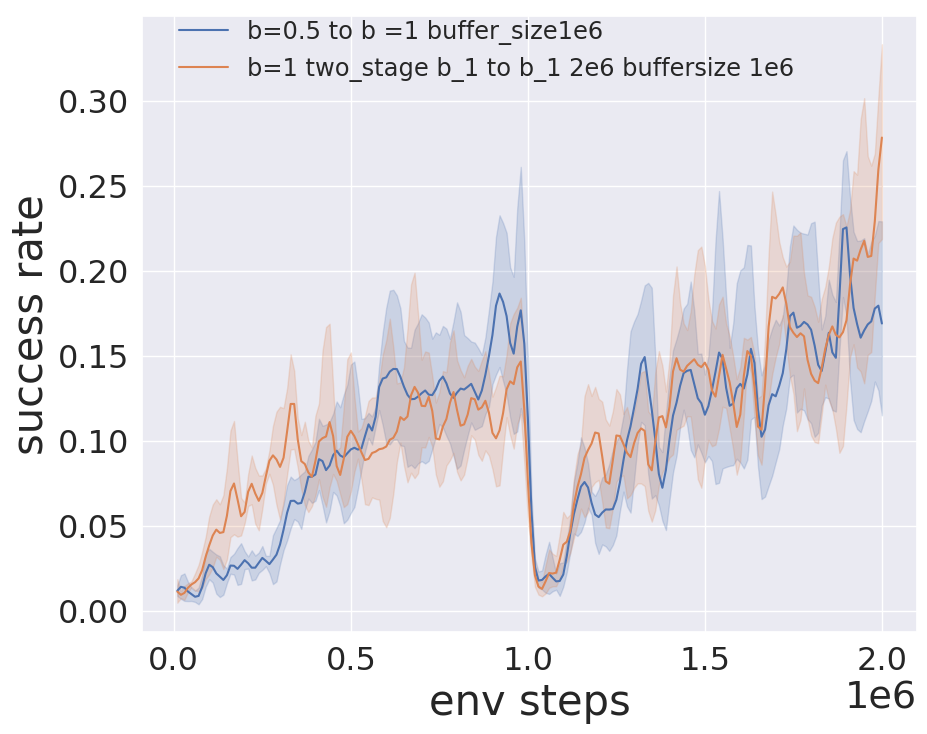

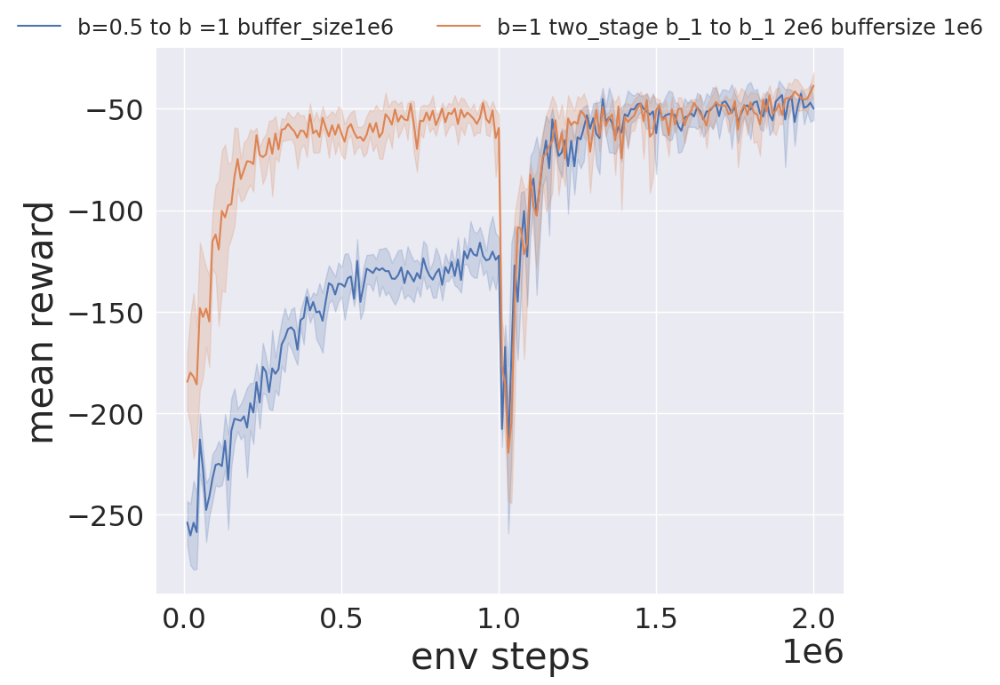

In [82]:
first_files = [
   "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_1_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_2_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_3_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_4_singleRL",
   "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_seed_5_singleRL",
    

]
second_files = [
    "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/two_stage_b_05_b_1/buffer_size1e6/sac_10hz_128_128_b_05_1e6steps_b_1_1e6steps_seed_5_singleRL", 

]

seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_two_stage_b_05_b_1_buffer_size1e6 = pd.concat([load_two_stage_data("b=0.5 to b =1 buffer_size1e6", first_filename,second_filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add_to_sec_stage=1000000).iloc[::] for first_filename, second_filename,seed_str in zip(first_files, second_files, seed_strs)])
print(len(df_two_stage_b_05_b_1_buffer_size1e6))



data_plot = pd.concat([
df_two_stage_b_05_b_1_buffer_size1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_two_stage_b_05_b_1_buffer_size1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6

])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

# E2D   1e6   buffersize 1e6 

500
500


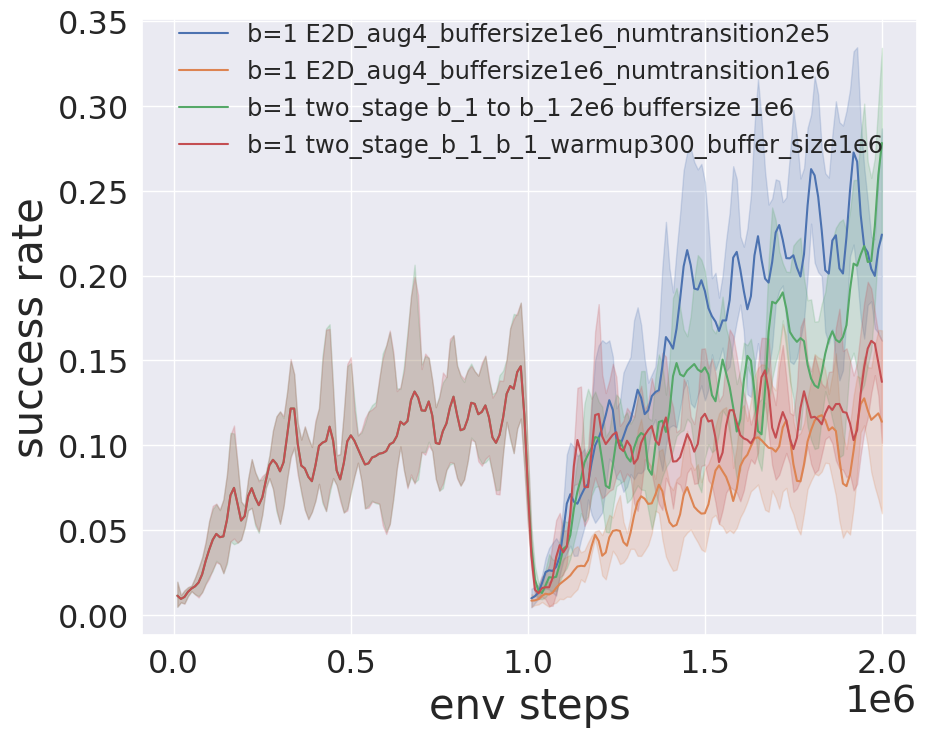

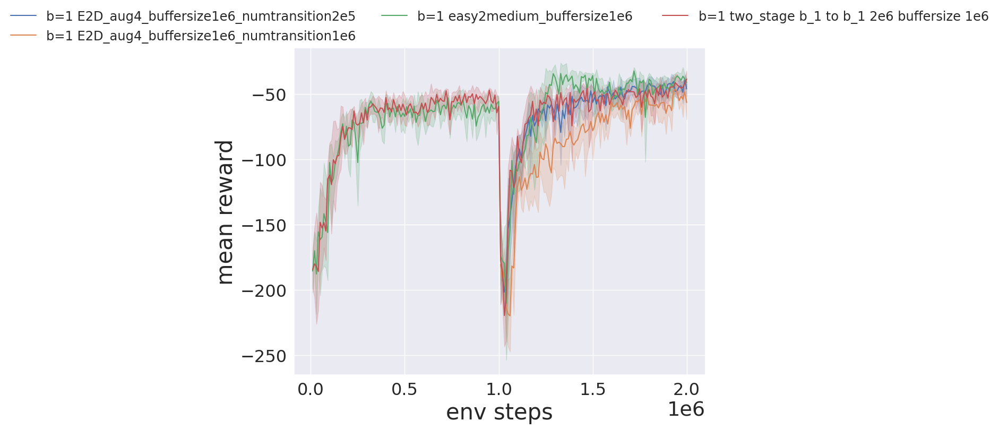

In [89]:
files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition2e5/sac_medium_10hz_128_128_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition2e5/sac_medium_10hz_128_128_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition2e5/sac_medium_10hz_128_128_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition2e5/sac_medium_10hz_128_128_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition2e5/sac_medium_10hz_128_128_b_1_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5 = pd.concat([load_data_add_step("b=1 E2D_aug4_buffersize1e6_numtransition2e5", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_E2D_aug4_buffersize1e6_numtransition2e5))


files = [
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition1e6/sac_medium_10hz_128_128_b_1_1e6steps_seed_1_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition1e6/sac_medium_10hz_128_128_b_1_1e6steps_seed_2_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition1e6/sac_medium_10hz_128_128_b_1_1e6steps_seed_3_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition1e6/sac_medium_10hz_128_128_b_1_1e6steps_seed_4_singleRL", 
    "D2D/VVC/medium/sac/E2D_medium_b_1_aug4/buffer_size1e6/num_transition1e6/sac_medium_10hz_128_128_b_1_1e6steps_seed_5_singleRL", 
]
seed_strs = [
    "seed 1", 
    "seed 2", 
    "seed 3", 
    "seed 4", 
    "seed 5"
]
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6 = pd.concat([load_data_add_step("b=1 E2D_aug4_buffersize1e6_numtransition1e6", filename, seed_str, insert_no=14, algo_dir="", smooth_success_rate=SMOOTH,time_steps_add=1000000).iloc[::] for filename, seed_str in zip(files, seed_strs)])
print(len(df_b_1_E2D_aug4_buffersize1e6_numtransition1e6))


data_plot = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
# df_b_1_easy2medium_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6,
df_two_stage_b_1_b_1_warmup300_buffer_size1e6

    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_b_1_easy2medium_buffersize1e6,
df_two_stage_b_1_to_b_1_2e6_buffersize1e6


])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

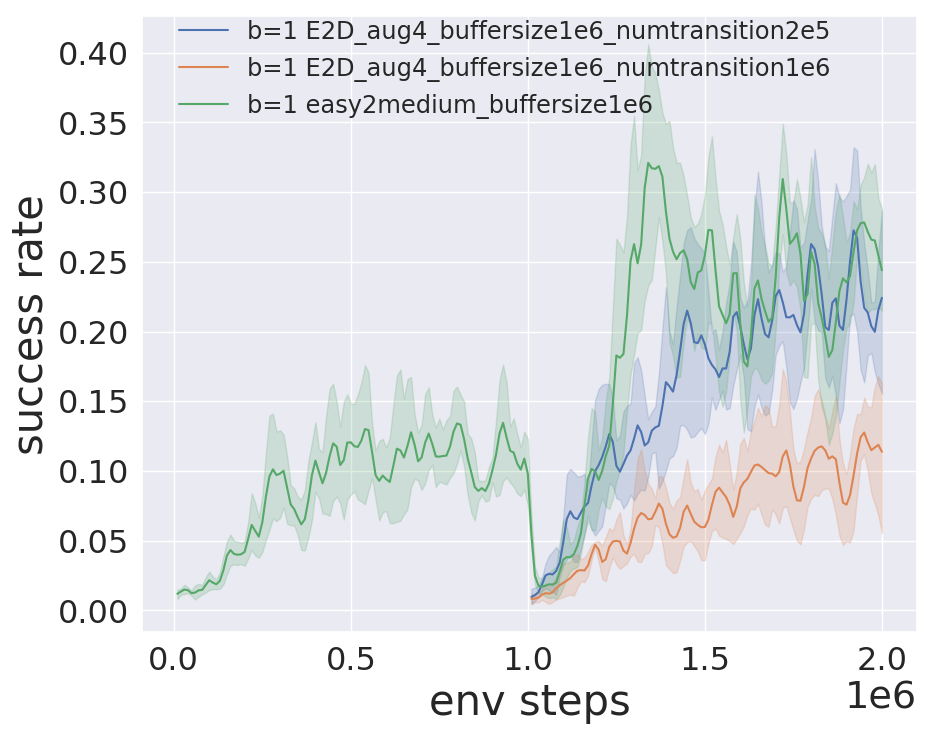

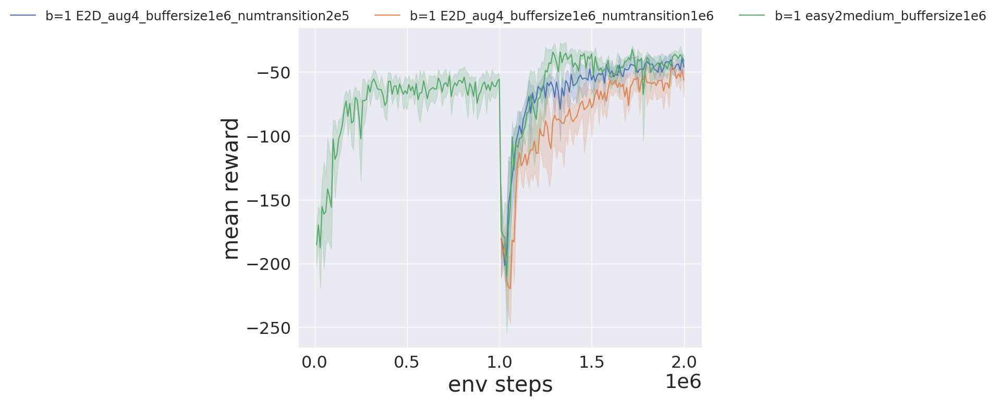

In [90]:
data_plot = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_b_1_easy2medium_buffersize1e6,


    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_b_1_easy2medium_buffersize1e6,


])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

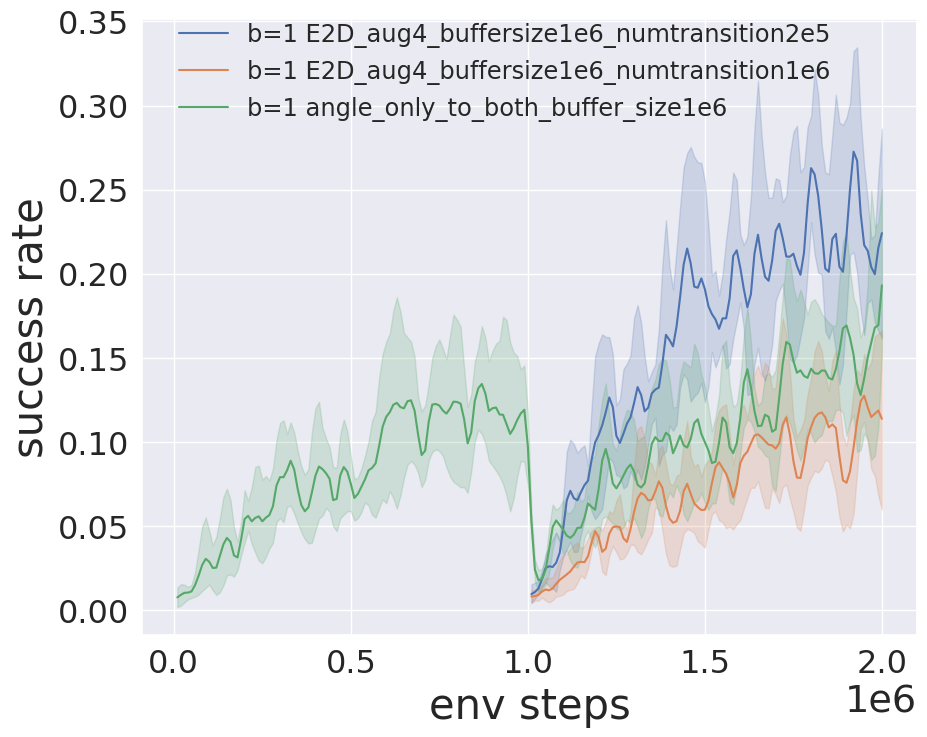

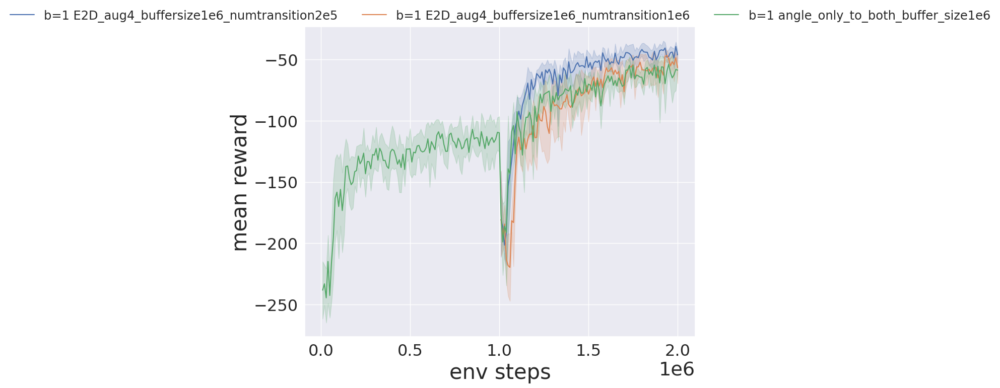

In [92]:
data_plot = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_b_1_angle_only_to_both_buffer_size1e6


    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_b_1_angle_only_to_both_buffer_size1e6


])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")

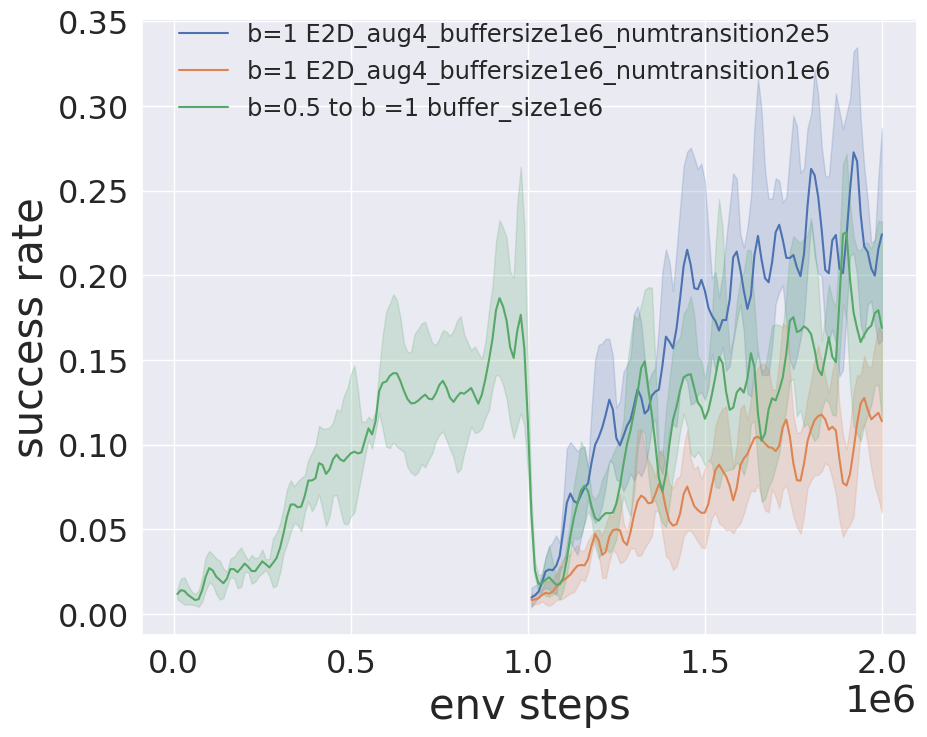

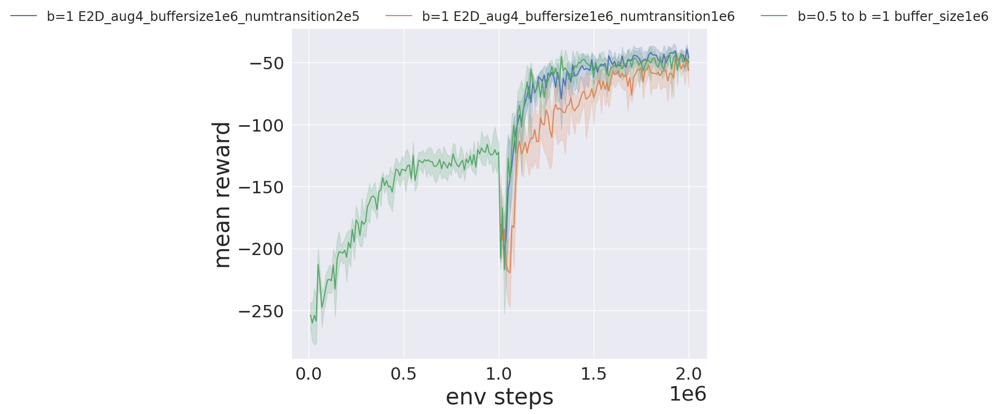

In [93]:
data_plot = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_two_stage_b_05_b_1_buffer_size1e6


    ])

data_plot["eval/success_rate"] = data_plot["eval/success_rate"]
# 取部分数据做图
f, ax = plt.subplots(figsize=(10, 8))
ax = sns.lineplot(x="time/total_timesteps", y="eval/success_rate", hue="algo", data=data_plot, ax=ax)

ax.tick_params(axis='both',labelsize=23)

ax.set_xlabel("env steps")
ax.set_ylabel("success rate")

# sns.move_legend(ax, "lower right", bbox_to_anchor=(.5, 0.98), ncol=7, title=None, frameon=False, fontsize="x-small") # "lower center"
sns.move_legend(ax, "upper left", bbox_to_anchor=(0.02, 1.03), ncol=1, title=None, frameon=False, fontsize="xx-small") # "lower center"



data_plot2 = pd.concat([
df_b_1_E2D_aug4_buffersize1e6_numtransition2e5,
df_b_1_E2D_aug4_buffersize1e6_numtransition1e6,
df_two_stage_b_05_b_1_buffer_size1e6


])
# 取部分数据做图
f2, ax2 = plt.subplots(figsize=(10, 8))
ax2 = sns.lineplot(x="time/total_timesteps", y="eval/mean_reward", hue="algo", data=data_plot2, ax=ax2)
ax2.tick_params(axis='both',labelsize=23)
# ax.axhline(y=0.61, c='g', ls='--', lw=1, label='bc')
# ax.axhline(y=0., c='b', ls='--', lw=1, label='rl_single')
# plt.legend()  # 显示水平辅助线的图例
# ax.set_xlabel("训练步数", fontproperties=SimHei)
# ax.set_ylabel("任务完成率", fontproperties=SimHei)
ax2.set_xlabel("env steps")
ax2.set_ylabel("mean reward")
# ax2.set_title("generation = 1")

sns.move_legend(ax2, "lower center", bbox_to_anchor=(.5, 0.98), ncol=3, title=None, frameon=False, fontsize="xx-small")